### Employee Dropout 

In [1]:
import math, time, random, datetime
# !pip install pandas_profiling

# data analysis and wrangling
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport

#### Importing Visualization Libraries

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')

#import for interactive plotting
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
%matplotlib inline

### Fixing the Figure size and Figure Style

In [3]:
plt.rcParams['figure.figsize'] = [12, 8]
plt.rcParams['figure.dpi'] = 120

#Plot type

plt.style.use('ggplot')

### Importing the Preprocessing Libraries


In [4]:
from sklearn.preprocessing import OneHotEncoder, LabelEncoder, label_binarize, StandardScaler

#### Importing Machine Learning Models

In [5]:

from sklearn import model_selection, tree, preprocessing, metrics, linear_model
from sklearn.metrics import confusion_matrix,classification_report
from sklearn.svm import SVC, LinearSVC
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import Perceptron,SGDClassifier,LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split,StratifiedKFold, GridSearchCV, learning_curve, cross_val_score
# !pip install catboost
from catboost import CatBoostClassifier, Pool, cv

In [6]:
# ignore Warnings
import warnings
warnings.filterwarnings('ignore')

### Import and Inspect Data

In [7]:
df = pd.read_csv("WA_Fn-UseC_-HR-Employee-Attrition.csv")

In [8]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [9]:
df.shape

(1470, 35)

### EDA (Exploratory Data Analysis) of Dataset

In [10]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### drop the columns which are not needed

In [10]:
df.drop(['EmployeeNumber','Over18','StandardHours','EmployeeCount'],axis=1,inplace=True)

In [11]:
df['Attrition'] = df['Attrition'].apply(lambda x:1 if x == "Yes" else 0 )
df['OverTime'] = df['OverTime'].apply(lambda x:1 if x =="Yes" else 0 )

In [12]:
attrition = df[df['Attrition'] == 1]
no_attrition = df[df['Attrition']==0]

### Visualization of Categorical Features 

In [13]:
def categorical_column_viz(col_name):
    
    f,ax = plt.subplots(1,2, figsize=(10,6))
  
    # Count Plot
    df[col_name].value_counts().plot.bar(cmap='tab20b',ax=ax[0])
    ax[1].set_title(f'Number of Employee by {col_name}')
    ax[1].set_ylabel('Count')
    ax[1].set_xlabel(f'{col_name}')
    
    # Attrition Count per factors
    sns.countplot(col_name, hue='Attrition',data=df, ax=ax[1], palette='tab20b')
    ax[1].set_title(f'Attrition by {col_name}')
    ax[1].set_xlabel(f'{col_name}')
    ax[1].set_ylabel('Count')

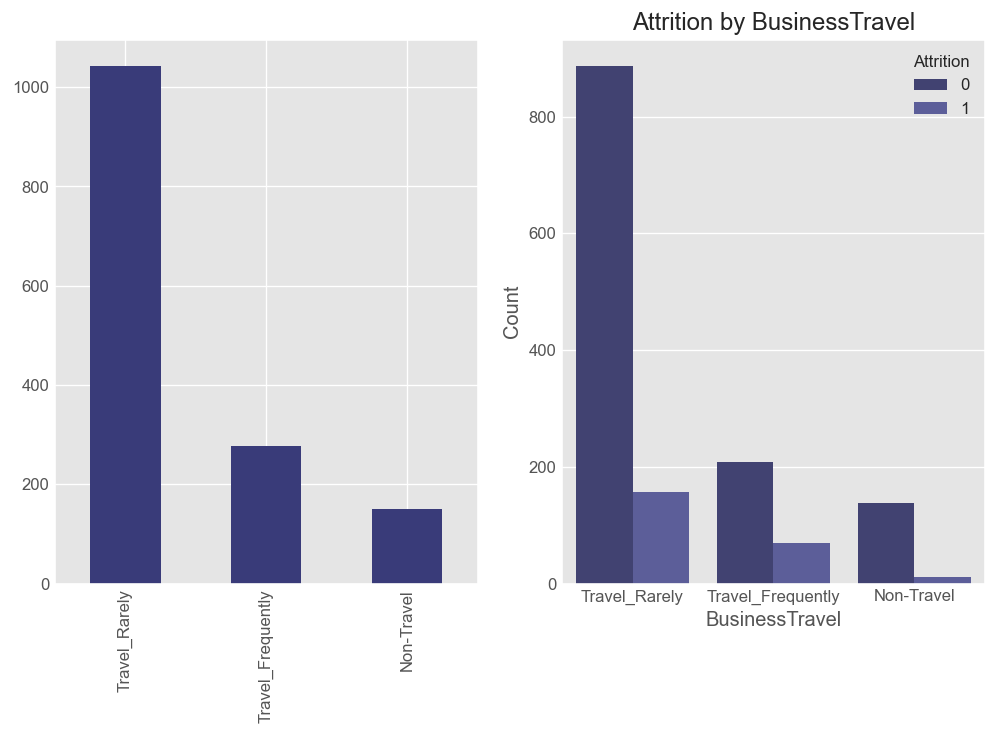

In [14]:
categorical_column_viz('BusinessTravel')

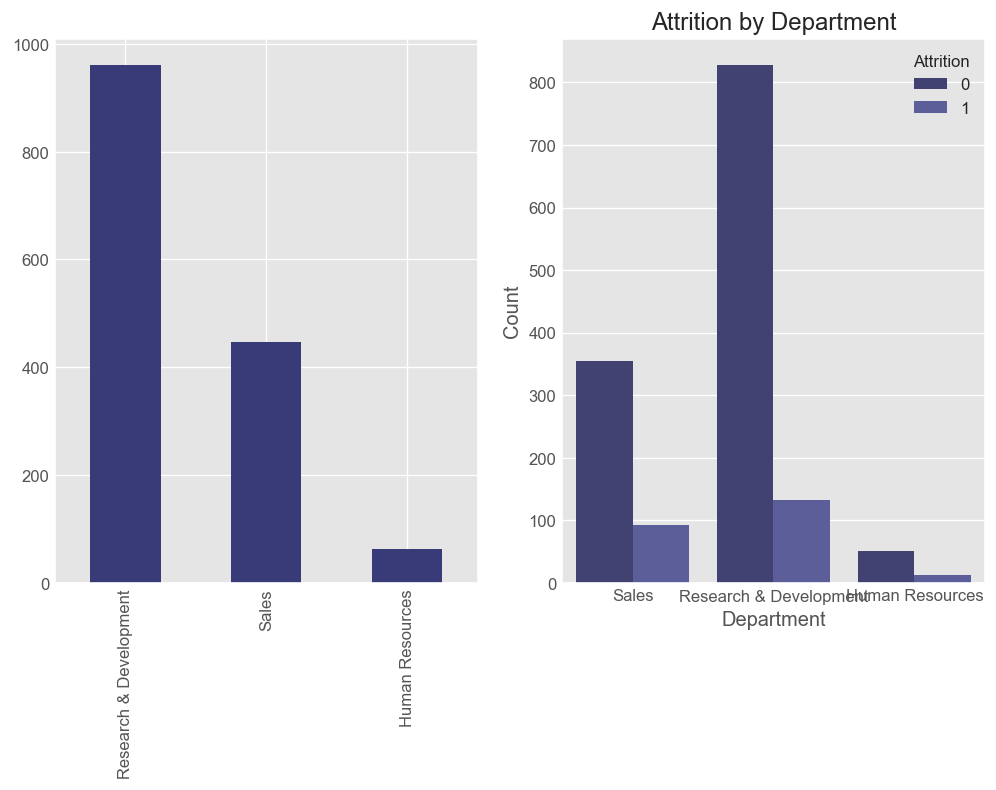

In [15]:
categorical_column_viz('Department')

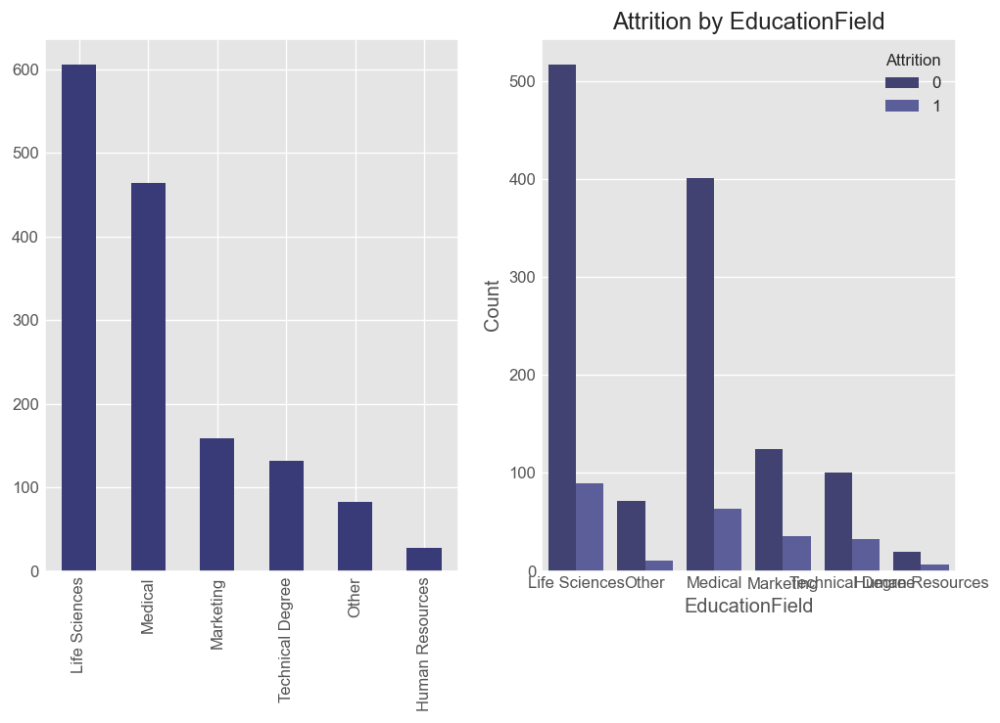

In [16]:
categorical_column_viz('EducationField')

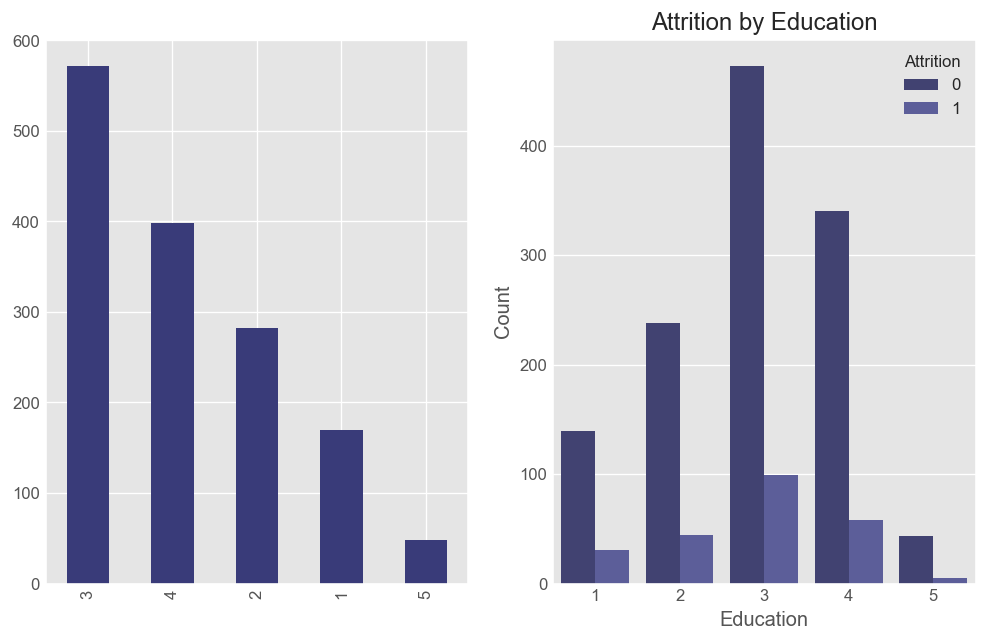

In [17]:
categorical_column_viz('Education')

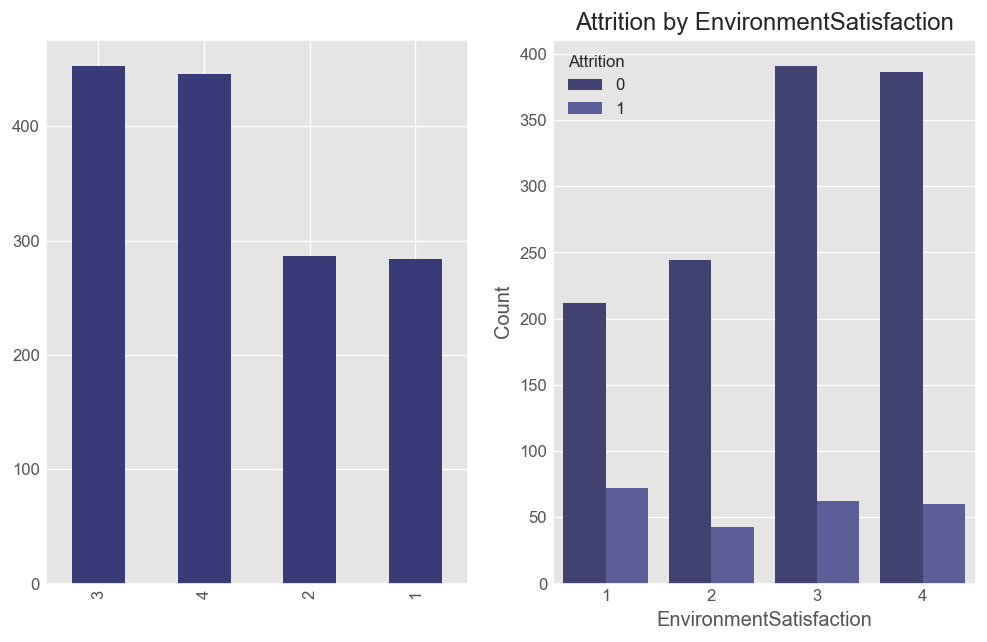

In [18]:
categorical_column_viz('EnvironmentSatisfaction')

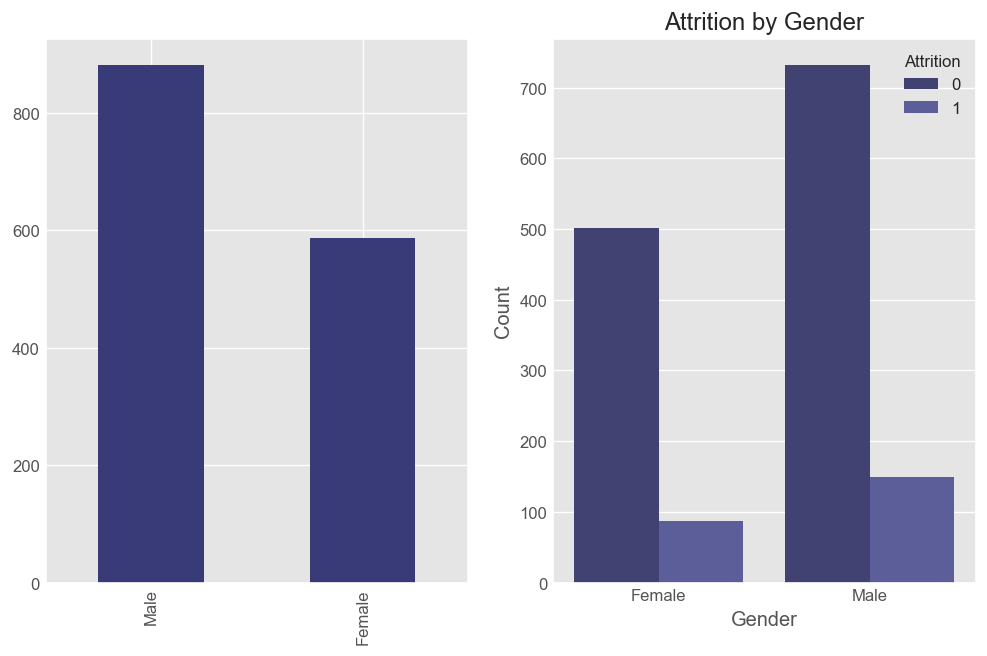

In [19]:
categorical_column_viz('Gender')

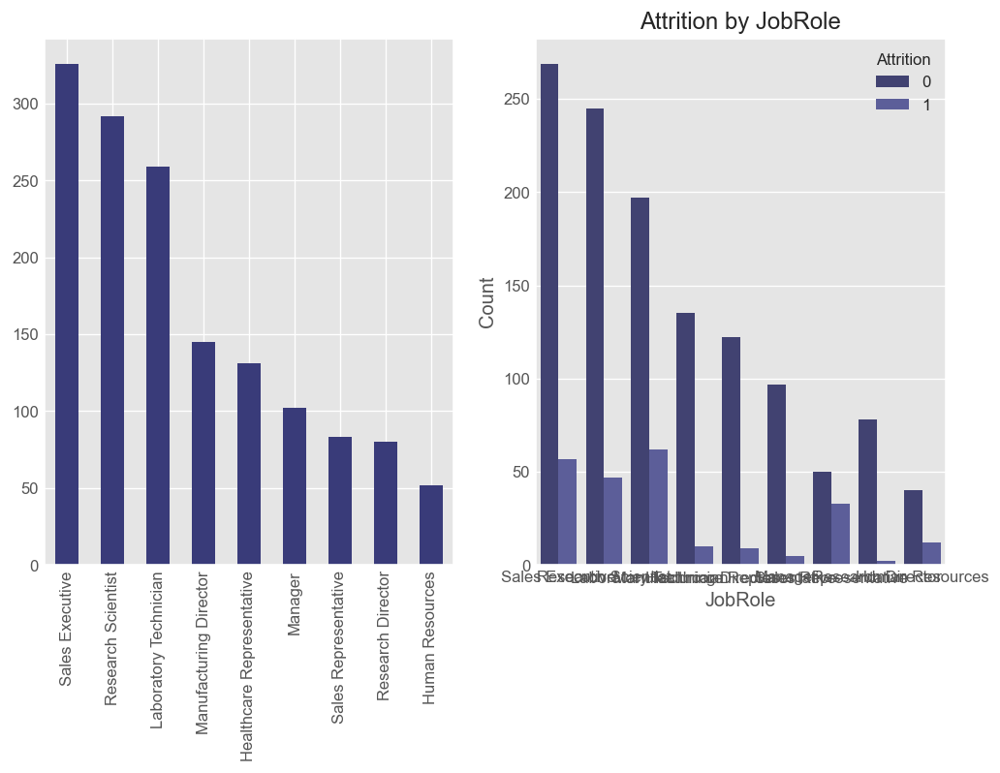

In [20]:
categorical_column_viz('JobRole')

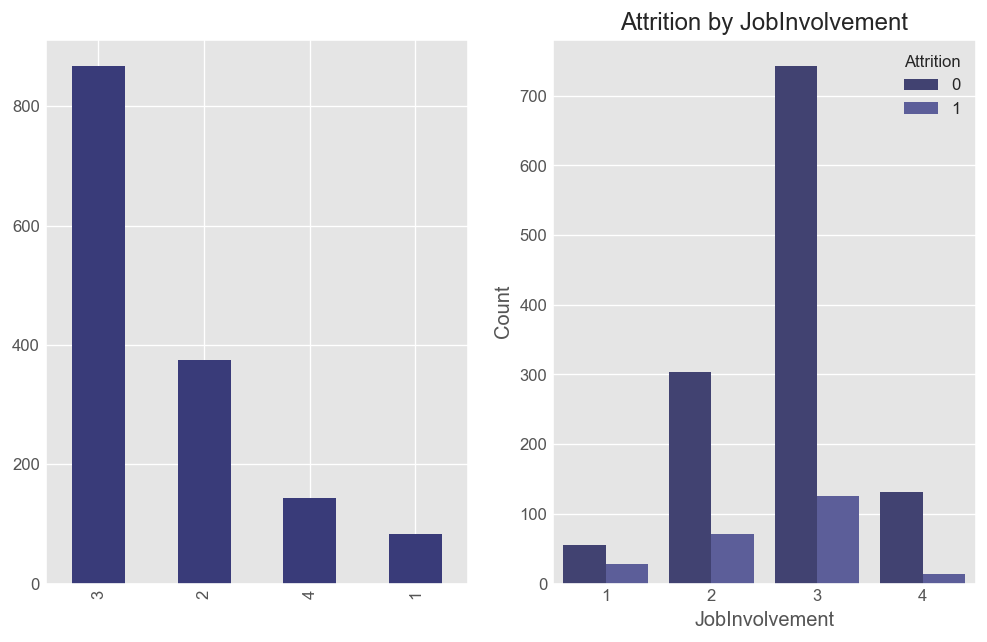

In [21]:
categorical_column_viz('JobInvolvement')

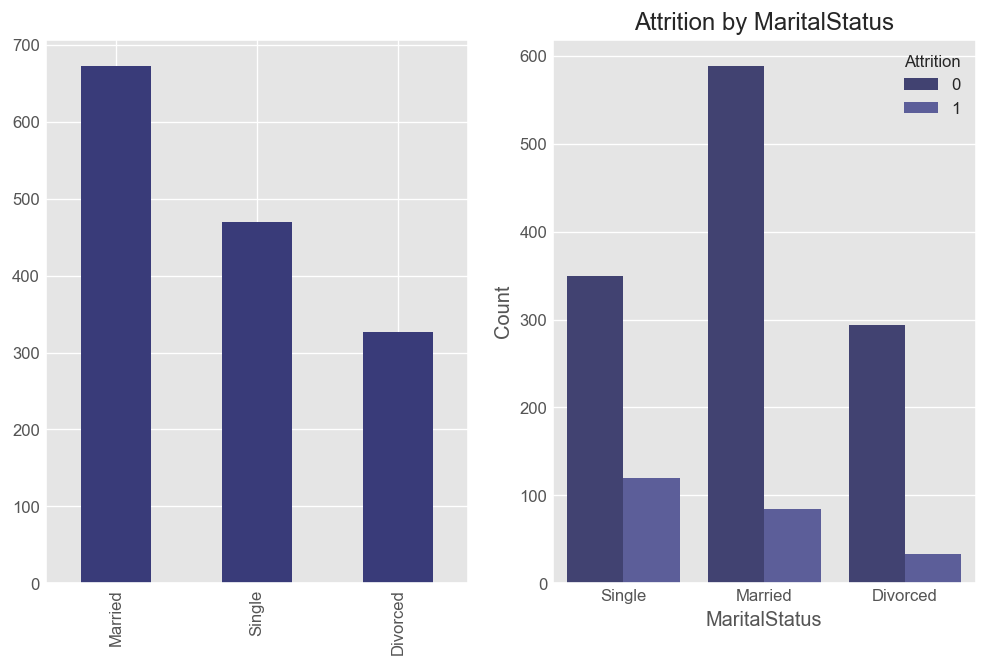

In [22]:
categorical_column_viz('MaritalStatus')

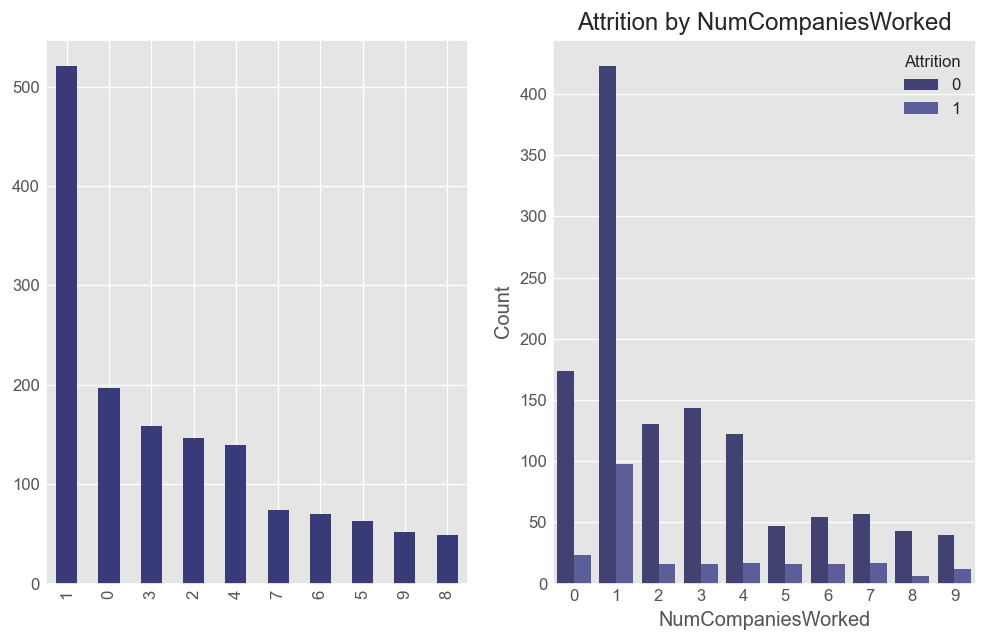

In [23]:
categorical_column_viz('NumCompaniesWorked')

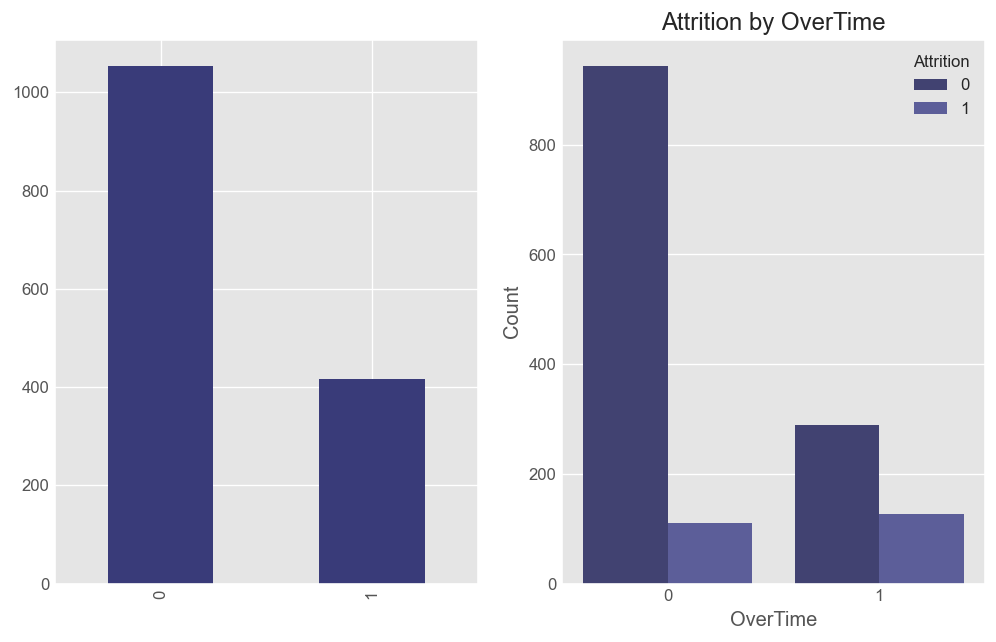

In [24]:
categorical_column_viz('OverTime')

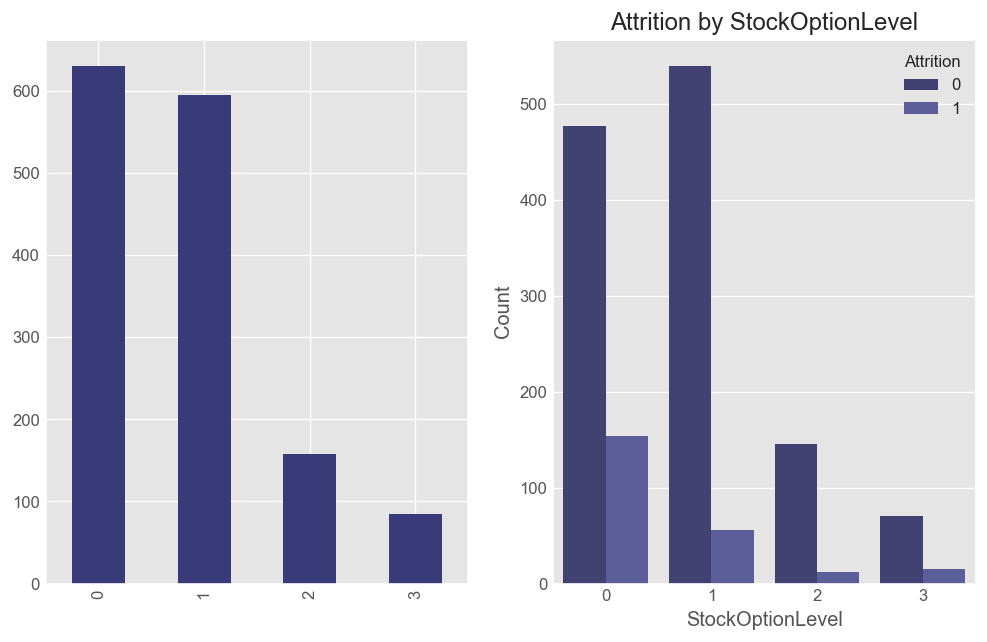

In [25]:
categorical_column_viz('StockOptionLevel')

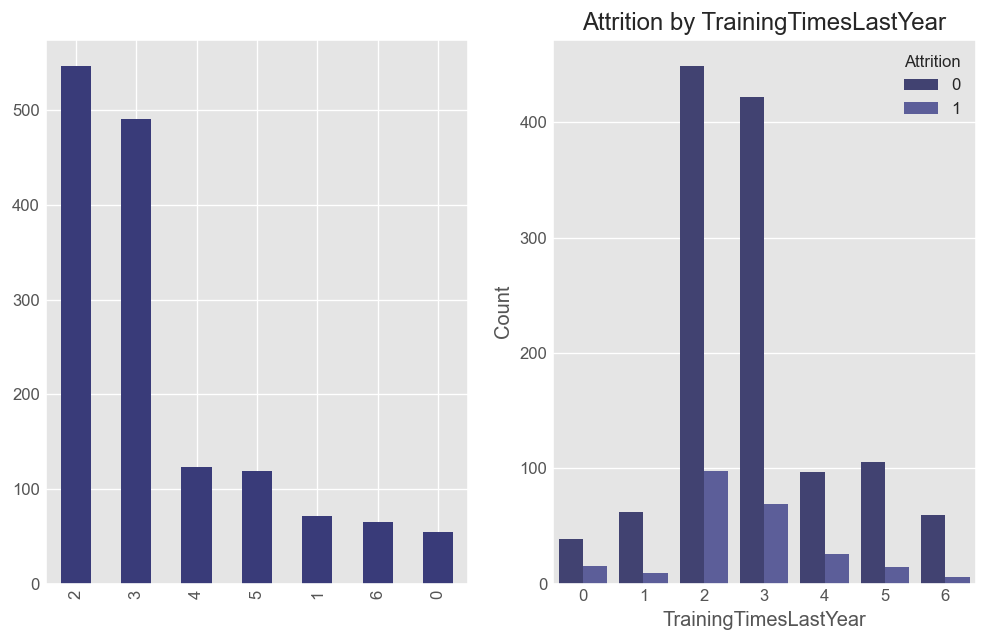

In [26]:
categorical_column_viz('TrainingTimesLastYear')

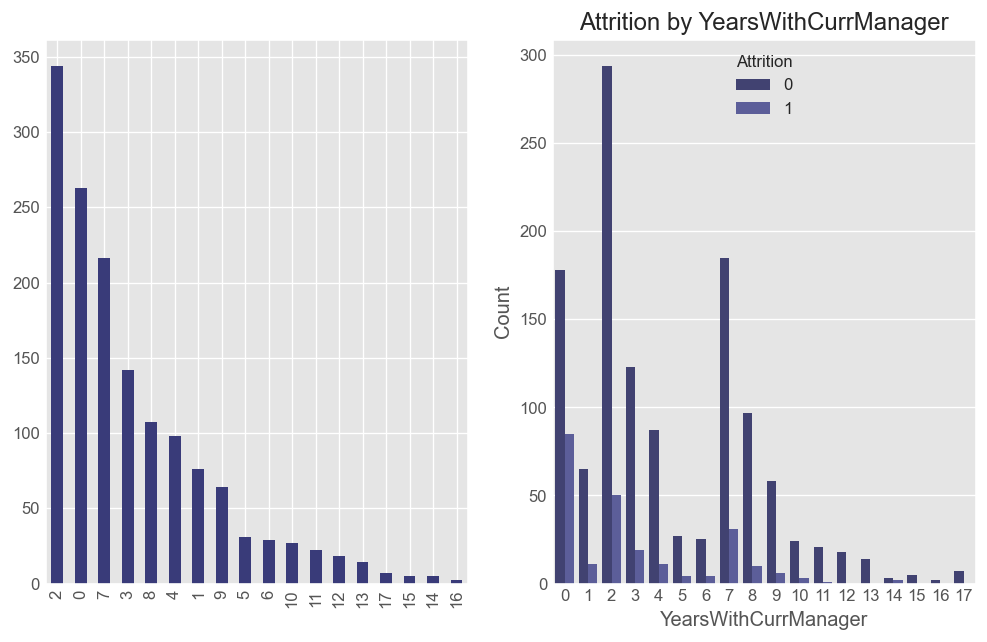

In [27]:
categorical_column_viz('YearsWithCurrManager')

### Visualization of Numerical Features 

In [28]:
def numerical_column_viz(col_name):
    f,ax = plt.subplots(1,2, figsize=(18,6))
    sns.kdeplot(attrition[col_name], label='Employee who left',ax=ax[0], shade=True, color='salmon')
    sns.kdeplot(no_attrition[col_name], label='Employee who stayed', ax=ax[0], shade=True, color='palegreen')
    
    sns.boxplot(y=col_name, x='Attrition',data=df, palette='Dark2', ax=ax[1])

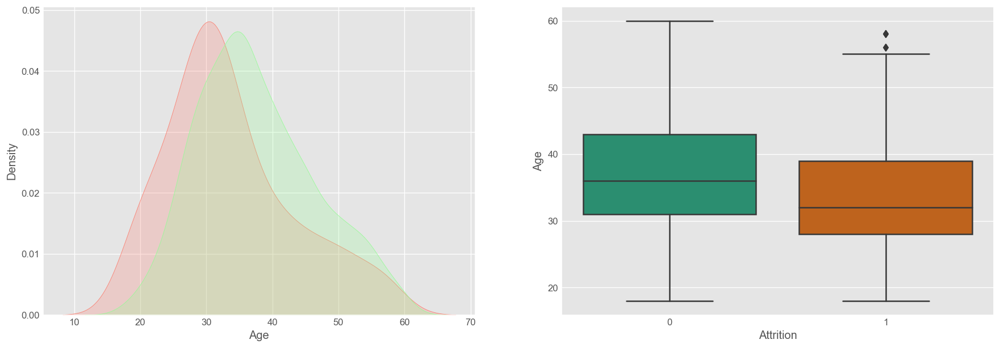

In [29]:
numerical_column_viz("Age")

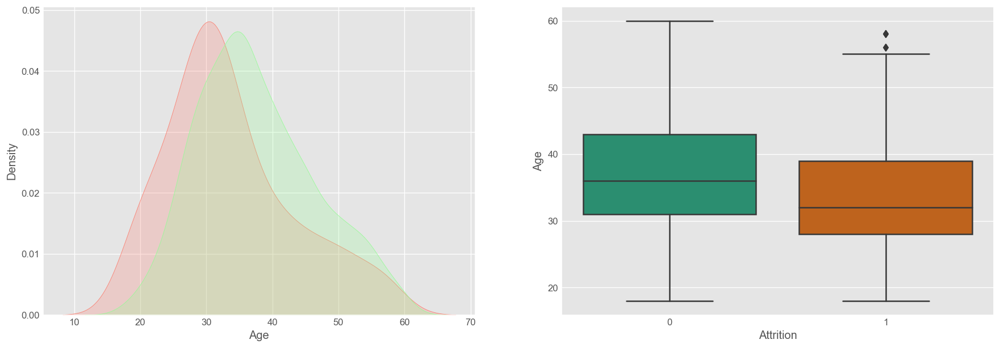

In [30]:
numerical_column_viz("Age")

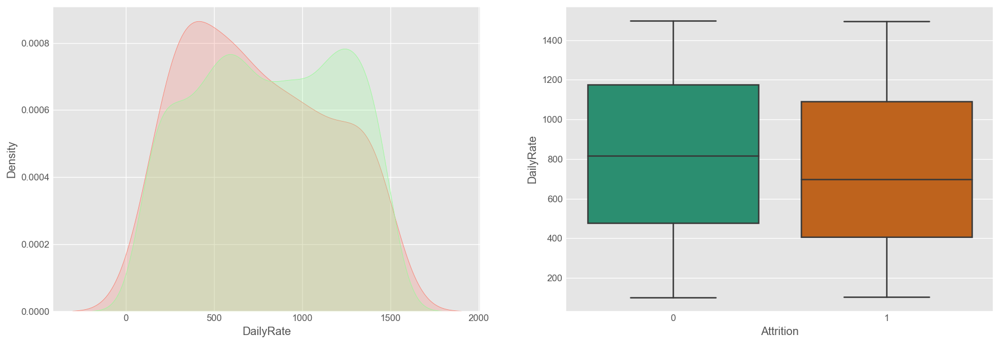

In [31]:
numerical_column_viz("DailyRate")

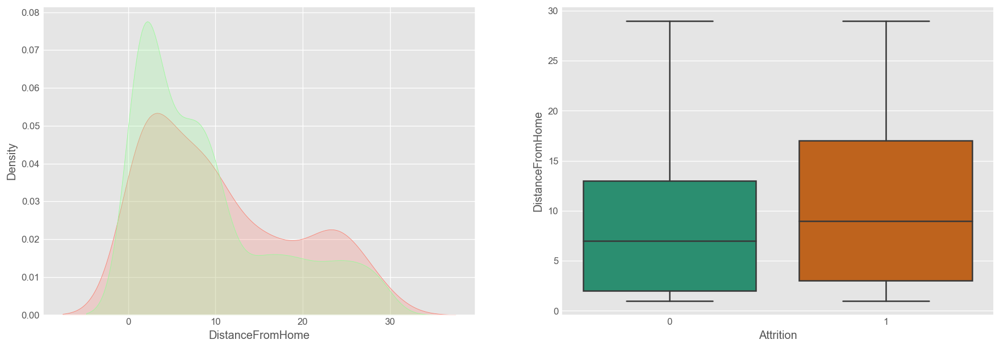

In [32]:
numerical_column_viz("DistanceFromHome")

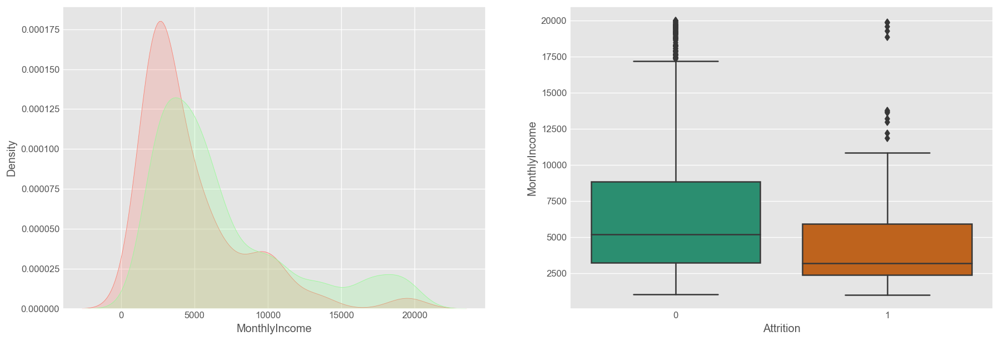

In [33]:
numerical_column_viz("MonthlyIncome")

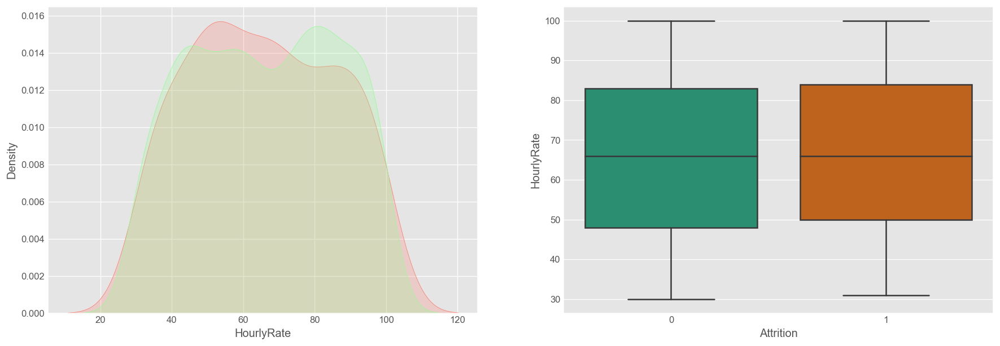

In [34]:
numerical_column_viz("HourlyRate")

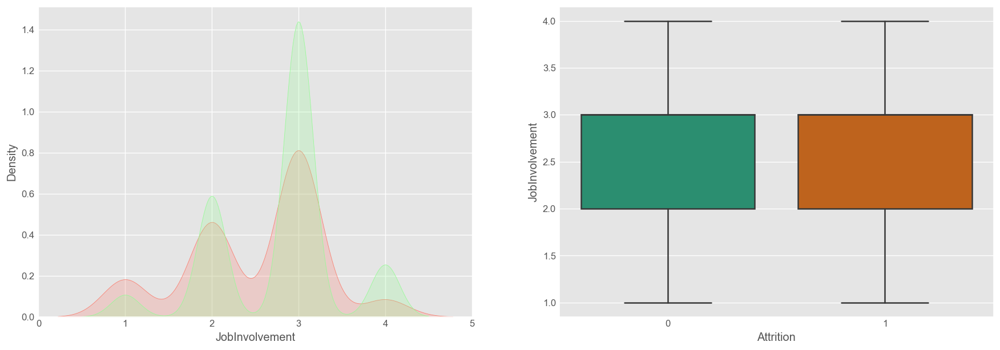

In [35]:
numerical_column_viz("JobInvolvement")

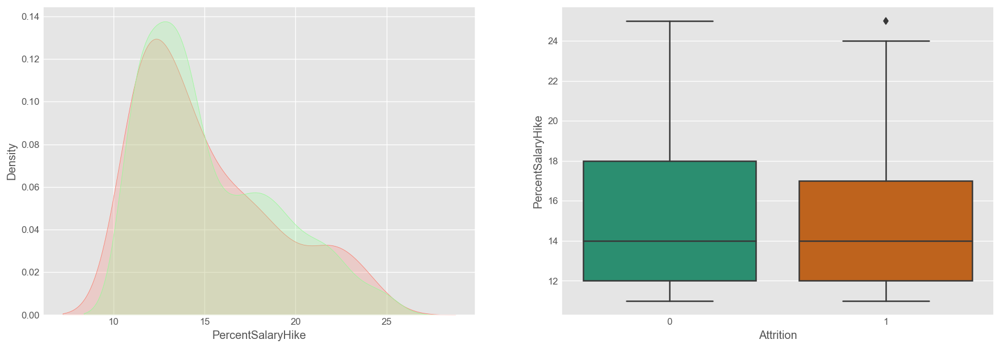

In [36]:
numerical_column_viz("PercentSalaryHike")

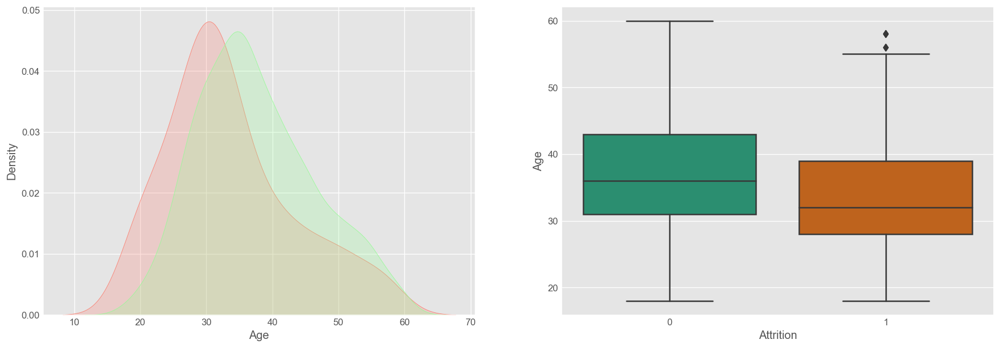

In [37]:
numerical_column_viz("Age")

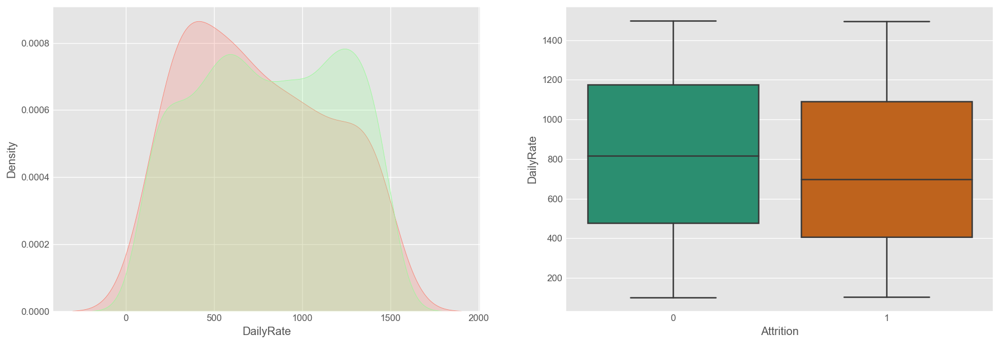

In [38]:
numerical_column_viz("DailyRate")

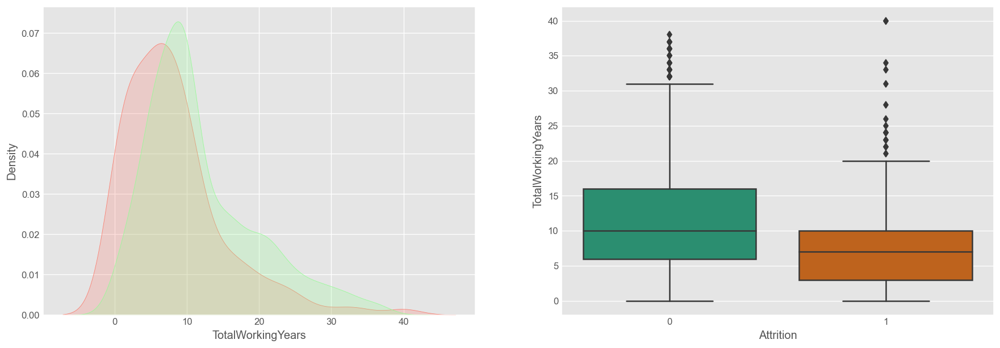

In [39]:
numerical_column_viz("TotalWorkingYears")

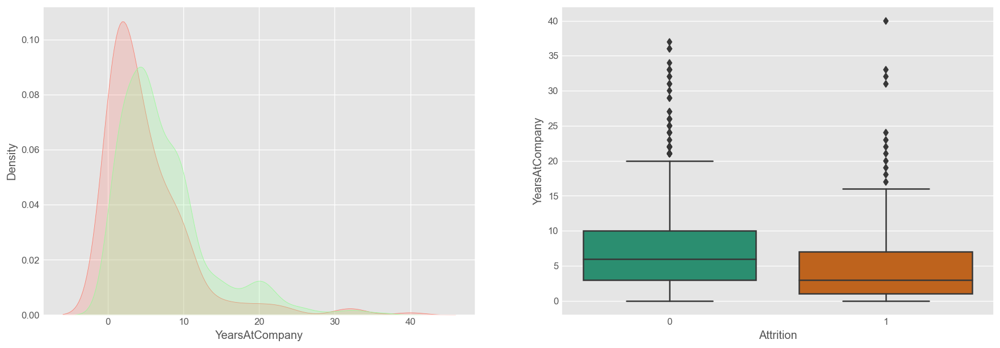

In [40]:
numerical_column_viz("YearsAtCompany")

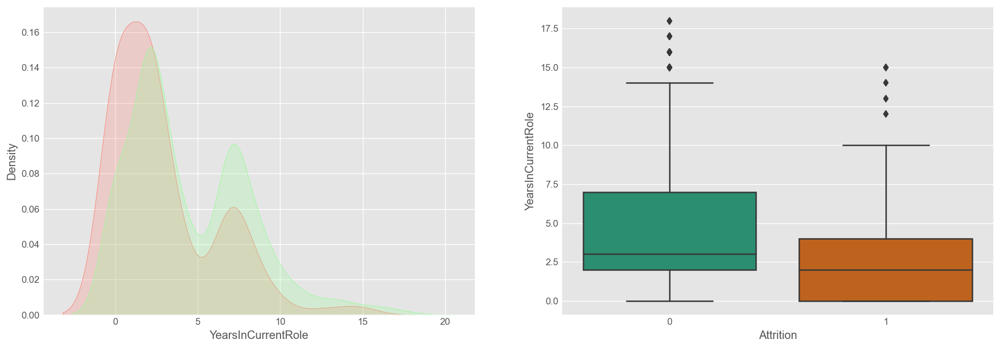

In [41]:
numerical_column_viz("YearsInCurrentRole")

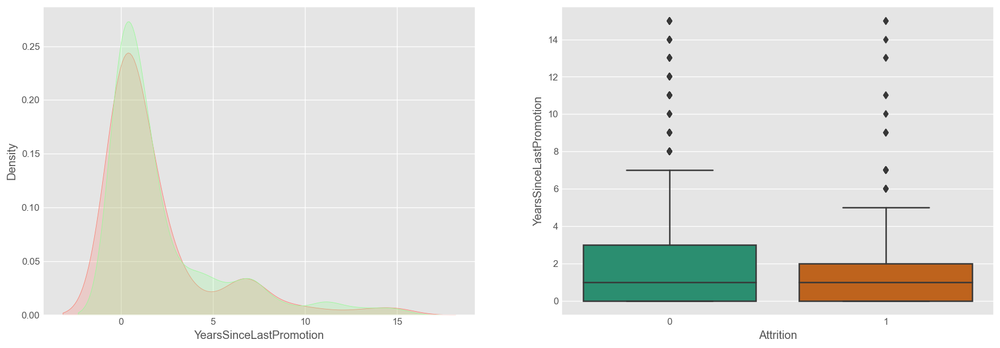

In [42]:
numerical_column_viz("YearsSinceLastPromotion")

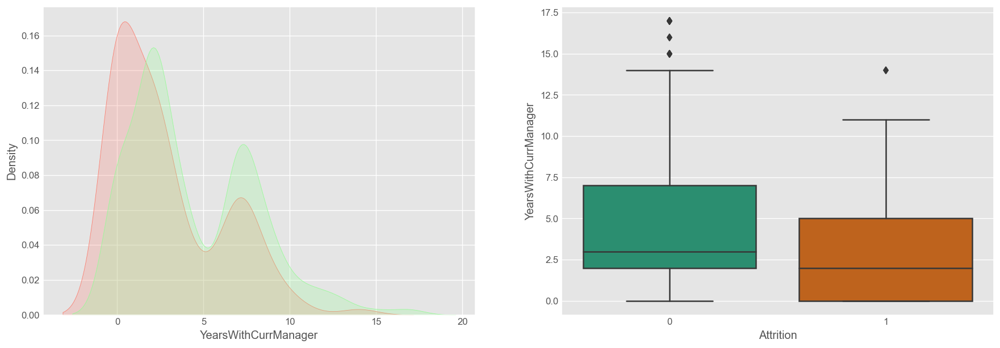

In [43]:
numerical_column_viz("YearsWithCurrManager")

### Visualization of Categorical vs Numericals Features 

In [44]:
def categorical_numerical(numerical_col, categorical_col1, categorical_col2):
    

    f,ax = plt.subplots(1,2, figsize=(20,8))
    
    g1= sns.swarmplot( categorical_col1, numerical_col,hue='Attrition', data=df, dodge=True, ax=ax[0], palette='Accent')
    ax[0].set_title(f'{numerical_col} vs {categorical_col1} separeted by Attrition')
    g1.set_xticklabels(g1.get_xticklabels(), rotation=90) 

    
    g2 = sns.swarmplot( categorical_col2, numerical_col,hue='Attrition', data=df, dodge=True, ax=ax[1], palette='Accent')
    ax[1].set_title(f'{numerical_col} vs {categorical_col1} separeted by Attrition')
    g2.set_xticklabels(g2.get_xticklabels(), rotation=90) 

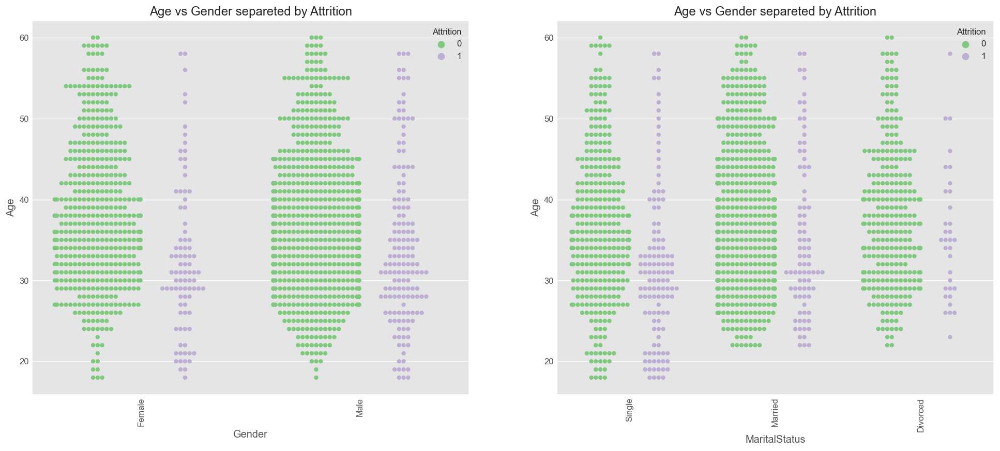

In [45]:
categorical_numerical('Age','Gender','MaritalStatus')

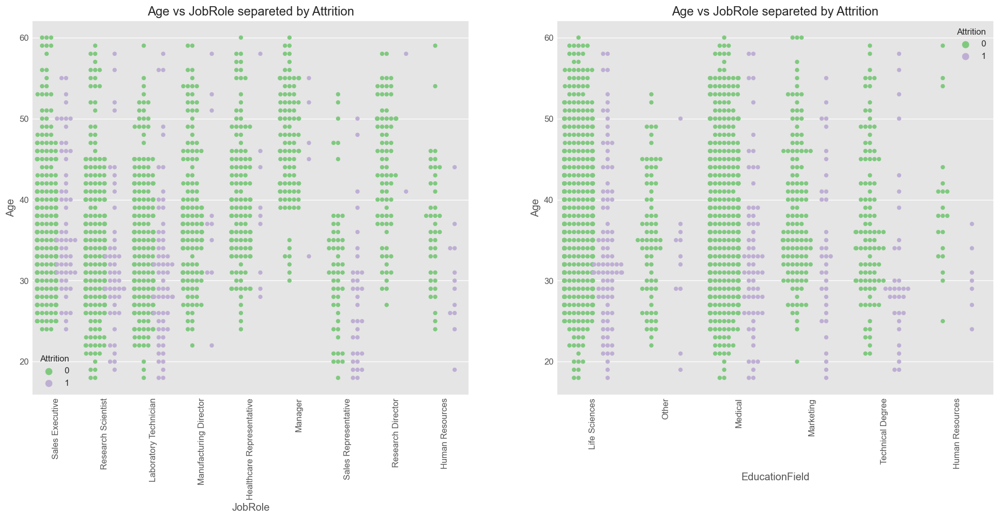

In [46]:
categorical_numerical('Age','JobRole','EducationField')

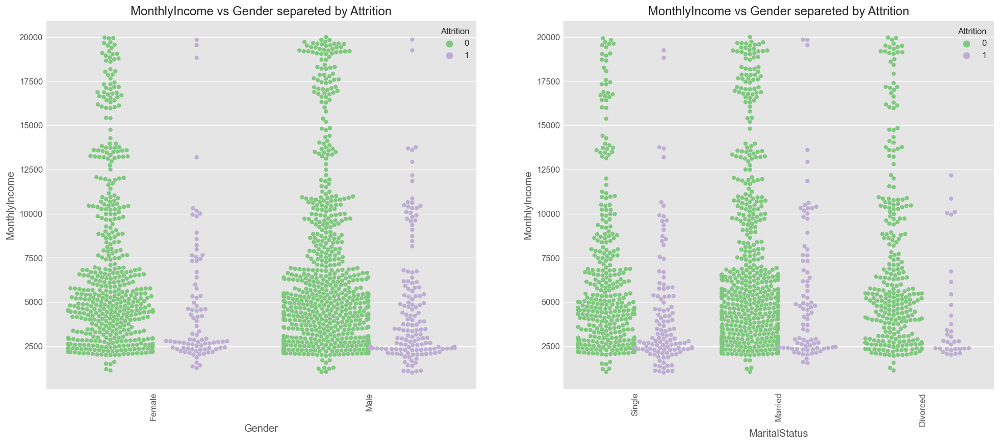

In [47]:
categorical_numerical('MonthlyIncome','Gender','MaritalStatus')

## Feature Engineering of Dataset

In [48]:
# 'EnviornmentSatisfaction', 'JobInvolvement', 'JobSatisfacction', 'RelationshipSatisfaction', 'WorklifeBalance' can be clubbed into a single feature 'TotalSatisfaction'

df['Total_Satisfaction'] = (df['EnvironmentSatisfaction'] + 
                            df['JobInvolvement'] + 
                            df['JobSatisfaction'] + 
                            df['RelationshipSatisfaction'] +
                            df['WorkLifeBalance']) /5 

# Drop Columns
df.drop(['EnvironmentSatisfaction','JobInvolvement','JobSatisfaction','RelationshipSatisfaction','WorkLifeBalance'], axis=1, inplace=True)

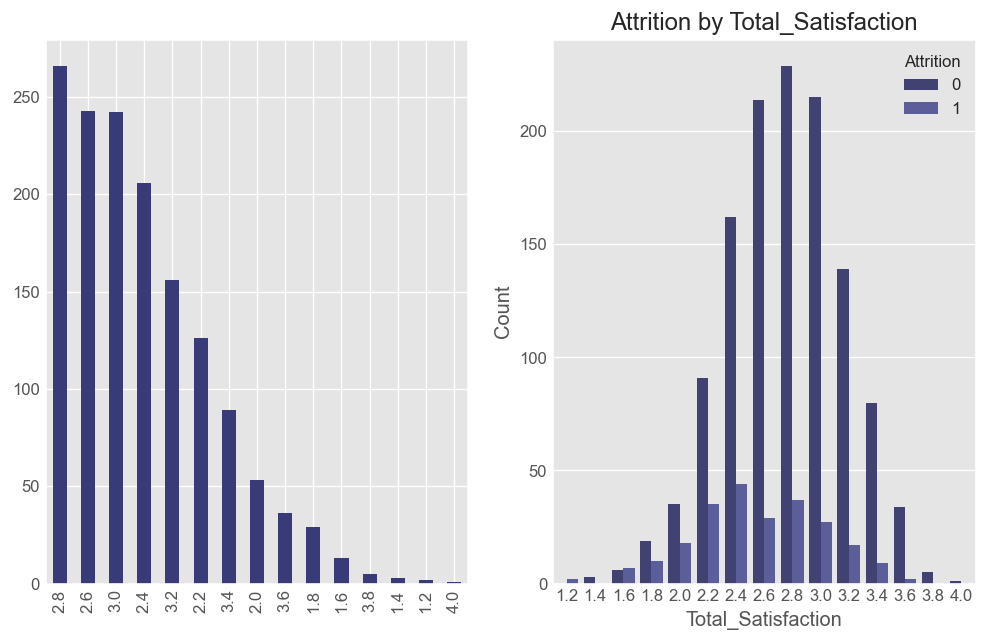

In [49]:
categorical_column_viz('Total_Satisfaction')

#### Employee Total Satisfaction Overall Summary 

In [50]:
df.Total_Satisfaction.describe()

count    1470.000000
mean        2.730748
std         0.428551
min         1.200000
25%         2.400000
50%         2.800000
75%         3.000000
max         4.000000
Name: Total_Satisfaction, dtype: float64

#### Changing Employee Total satisfaction into Boolean format


In [51]:
df['Total_Satisfaction_bool'] = df['Total_Satisfaction'].apply(lambda x:1 if x>=2.8 else 0 ) 
df.drop('Total_Satisfaction', axis=1, inplace=True)

#### OBSERVATION ::  It can be studied that the rate of attrition of employees below age of 35 is high

In [52]:
df['Age_bool'] = df['Age'].apply(lambda x:1 if x<35 else 0)
df.drop('Age', axis=1, inplace=True)

#### OBSERVATION ::  It can be studied that the employees are more likey the drop the job if dailtRate less than 800

In [53]:
df['DailyRate_bool'] = df['DailyRate'].apply(lambda x:1 if x<800 else 0)
df.drop('DailyRate', axis=1, inplace=True)

#### OBSERVATION ::  It can be studied that  Employees working at R&D Department have higher attrition rate

In [54]:
df['Department_bool'] = df['Department'].apply(lambda x:1 if x=='Research & Development' else 0)
df.drop('Department', axis=1, inplace=True)


#### OBSERVATION ::  It can be studied that  Rate of attrition of employees is high if DistanceFromHome > 10


In [55]:
df['DistanceFromHome_bool'] = df['DistanceFromHome'].apply(lambda x:1 if x>10 else 0)
df.drop('DistanceFromHome', axis=1, inplace=True)


#### OBSERVATION ::  It can be studied that Employees are more likey to drop the job if the employee is working as Laboratory Technician


In [56]:
df['JobRole_bool'] = df['JobRole'].apply(lambda x:1 if x=='Laboratory Technician' else 0)
df.drop('JobRole', axis=1, inplace=True)


#### OBSERVATION ::  It can be studied that Employees are more likey to the drop the job if the employee's hourly rate < 65


In [57]:

df['HourlyRate_bool'] = df['HourlyRate'].apply(lambda x:1 if x<65 else 0)
df.drop('HourlyRate', axis=1, inplace=True)


#### OBSERVATION ::  It can be studied that  Employees are more likey to the drop the job if the employee's MonthlyIncome < 4000


In [58]:

df['MonthlyIncome_bool'] = df['MonthlyIncome'].apply(lambda x:1 if x<4000 else 0)
df.drop('MonthlyIncome', axis=1, inplace=True)


#### OBSERVATION ::  It can be studied that Rate of attrition of employees is high if NumCompaniesWorked < 3


In [59]:

df['NumCompaniesWorked_bool'] = df['NumCompaniesWorked'].apply(lambda x:1 if x>3 else 0)
df.drop('NumCompaniesWorked', axis=1, inplace=True)


#### OBSERVATION ::  It can be studied that  Employees are more likey to the drop the job if the employee's TotalWorkingYears < 8


In [60]:

df['TotalWorkingYears_bool'] = df['TotalWorkingYears'].apply(lambda x:1 if x<8 else 0)
df.drop('TotalWorkingYears', axis=1, inplace=True)


#### OBSERVATION ::  It can be studied that Employees are more likey to the drop the job if the employee's YearsAtCompany < 3


In [61]:
df['YearsAtCompany_bool'] = df['YearsAtCompany'].apply(lambda x:1 if x<3 else 0)
df.drop('YearsAtCompany', axis=1, inplace=True)


#### OBSERVATION ::  It can be studied that Employees are more likey to the drop the job if the employee's YearsInCurrentRole < 3


In [62]:
df['YearsInCurrentRole_bool'] = df['YearsInCurrentRole'].apply(lambda x:1 if x<3 else 0)
df.drop('YearsInCurrentRole', axis=1, inplace=True)

#### OBSERVATION ::  It can be studied that  Employees are more likey to the drop the job if the employee's YearsSinceLastPromotion < 1


In [63]:
df['YearsSinceLastPromotion_bool'] = df['YearsSinceLastPromotion'].apply(lambda x:1 if x<1 else 0)
df.drop('YearsSinceLastPromotion', axis=1, inplace=True)

#### OBSERVATION :: It can be studied that Employees are more likey to the drop the job if the employee's YearsWithCurrManager < 1


In [64]:
df['YearsWithCurrManager_bool'] = df['YearsWithCurrManager'].apply(lambda x:1 if x<1 else 0)
df.drop('YearsWithCurrManager', axis=1, inplace=True)

In [65]:
df['Gender'] = df['Gender'].apply(lambda x:1 if x=='Female' else 0)

In [66]:
df.drop('MonthlyRate', axis=1, inplace=True)
df.drop('PercentSalaryHike', axis=1, inplace=True)

In [67]:
convert_category = ['BusinessTravel','Education','EducationField','MaritalStatus','StockOptionLevel','OverTime','Gender','TrainingTimesLastYear']
for col in convert_category:
        df[col] = df[col].astype('category')

In [68]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 25 columns):
 #   Column                        Non-Null Count  Dtype   
---  ------                        --------------  -----   
 0   Attrition                     1470 non-null   int64   
 1   BusinessTravel                1470 non-null   category
 2   Education                     1470 non-null   category
 3   EducationField                1470 non-null   category
 4   Gender                        1470 non-null   category
 5   JobLevel                      1470 non-null   int64   
 6   MaritalStatus                 1470 non-null   category
 7   OverTime                      1470 non-null   category
 8   PerformanceRating             1470 non-null   int64   
 9   StockOptionLevel              1470 non-null   category
 10  TrainingTimesLastYear         1470 non-null   category
 11  Total_Satisfaction_bool       1470 non-null   int64   
 12  Age_bool                      1470 non-null   in

#### Separate the categorical and Numerical Data


In [69]:
X_categorical = df.select_dtypes(include=['category'])
X_numerical = df.select_dtypes(include=['int64'])
X_numerical.drop('Attrition', axis=1, inplace=True)

In [70]:
y = df['Attrition']

##### One Hot Encoding Categorical Features


In [71]:

onehotencoder = OneHotEncoder()

X_categorical = onehotencoder.fit_transform(X_categorical).toarray()
X_categorical = pd.DataFrame(X_categorical)
X_categorical

,0,1,2,3,4,5,6,7,8,9,...,22,23,24,25,26,27,28,29,30,31
0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1466,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1467,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1468,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0



#### #concat the categorical and numerical values


In [72]:

X_all = pd.concat([X_categorical, X_numerical], axis=1)
X_all.head()

,0,1,2,3,4,5,6,7,8,9,...,DistanceFromHome_bool,JobRole_bool,HourlyRate_bool,MonthlyIncome_bool,NumCompaniesWorked_bool,TotalWorkingYears_bool,YearsAtCompany_bool,YearsInCurrentRole_bool,YearsSinceLastPromotion_bool,YearsWithCurrManager_bool
0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0,0,0,0,1,0,0,0,1,0
1,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0,0,1,0,0,0,0,0,0,0
2,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0,1,0,1,1,1,1,1,1,1
3,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,...,0,0,1,1,0,0,0,0,0,1
4,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,1,1,1,1,1,1,1,0,0


### Detailed Dataset Information

In [73]:
X_all.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 48 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   0                             1470 non-null   float64
 1   1                             1470 non-null   float64
 2   2                             1470 non-null   float64
 3   3                             1470 non-null   float64
 4   4                             1470 non-null   float64
 5   5                             1470 non-null   float64
 6   6                             1470 non-null   float64
 7   7                             1470 non-null   float64
 8   8                             1470 non-null   float64
 9   9                             1470 non-null   float64
 10  10                            1470 non-null   float64
 11  11                            1470 non-null   float64
 12  12                            1470 non-null   float64
 13  13 

### Split Data - Training and Testing of the Dataset

In [74]:
X_train,X_test, y_train, y_test = train_test_split(X_all,y, test_size=0.30)

In [85]:
print(f"Train data shape: {X_train.shape}, Test Data Shape {X_test.shape}")

Train data shape: (1029, 48), Test Data Shape (441, 48)


In [86]:
X_train.head()

,0,1,2,3,4,5,6,7,8,9,...,DistanceFromHome_bool,JobRole_bool,HourlyRate_bool,MonthlyIncome_bool,NumCompaniesWorked_bool,TotalWorkingYears_bool,YearsAtCompany_bool,YearsInCurrentRole_bool,YearsSinceLastPromotion_bool,YearsWithCurrManager_bool
1139,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0,0,1,1,0,1,0,1,1,0
1024,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
413,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,1,0,0,0,0,1,0,0,1,0
598,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0,0,1,0,1,1,1,1,0,0
54,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,1,0,1,0,1,1,1,1,1,1


## Training of the Employee Dataset

In [87]:
# Function that runs the requested algorithm and returns the accuracy metrics
def fit_ml_algo(algo, X_train,y_train, cv):
    
    # One Pass
    model = algo.fit(X_train, y_train)
    acc = round(model.score(X_train, y_train) * 100, 2)
    
    # Cross Validation 
    train_pred = model_selection.cross_val_predict(algo,X_train,y_train,cv=cv,n_jobs = -1)
    
    # Cross-validation accuracy metric
    acc_cv = round(metrics.accuracy_score(y_train, train_pred) * 100, 2)
    
    return train_pred, acc, acc_cv

### Implementation of Logistic Regression Algorithm

In [88]:
# Logistic Regression
start_time = time.time()
train_pred_log, acc_log, acc_cv_log = fit_ml_algo(LogisticRegression(), X_train,y_train, 10)
log_time = (time.time() - start_time)
print("Accuracy: %s" % acc_log)
print("Accuracy CV 10-Fold: %s" % acc_cv_log)
print("Running Time: %s" % datetime.timedelta(seconds=log_time))

Accuracy: 88.24
Accuracy CV 10-Fold: 86.88
Running Time: 0:00:08.883462


### Implementation of Support Vector Machine Algorithm 

In [89]:
# SVC
start_time = time.time()
train_pred_svc, acc_svc, acc_cv_svc = fit_ml_algo(SVC(),X_train,y_train,10)
svc_time = (time.time() - start_time)
print("Accuracy: %s" % acc_svc)
print("Accuracy CV 10-Fold: %s" % acc_cv_svc)
print("Running Time: %s" % datetime.timedelta(seconds=svc_time))

Accuracy: 86.69
Accuracy CV 10-Fold: 85.33
Running Time: 0:00:00.658581


### Implementation of Linear Support Vector Machines Algorithm

In [90]:
# Linear SVC
start_time = time.time()
train_pred_svc, acc_linear_svc, acc_cv_linear_svc = fit_ml_algo(LinearSVC(),X_train, y_train,10)
linear_svc_time = (time.time() - start_time)
print("Accuracy: %s" % acc_linear_svc)
print("Accuracy CV 10-Fold: %s" % acc_cv_linear_svc)
print("Running Time: %s" % datetime.timedelta(seconds=linear_svc_time))

Accuracy: 88.05
Accuracy CV 10-Fold: 86.78
Running Time: 0:00:00.589936


### Implementation of  K Nearest Neighbour

In [91]:
# K Nearest Neighbour
start_time = time.time()
train_pred_knn, acc_knn, acc_cv_knn = fit_ml_algo(KNeighborsClassifier(n_neighbors = 3),X_train,y_train,10)
knn_time = (time.time() - start_time)
print("Accuracy: %s" % acc_knn)
print("Accuracy CV 10-Fold: %s" % acc_cv_knn)
print("Running Time: %s" % datetime.timedelta(seconds=knn_time))

Accuracy: 88.92
Accuracy CV 10-Fold: 82.6
Running Time: 0:00:00.404372


### Implementation of Gaussian Naive Bayes

In [92]:
# Gaussian Naive Bayes
start_time = time.time()
train_pred_gaussian, acc_gaussian, acc_cv_gaussian = fit_ml_algo(GaussianNB(),X_train,y_train,10)
gaussian_time = (time.time() - start_time)
print("Accuracy: %s" % acc_gaussian)
print("Accuracy CV 10-Fold: %s" % acc_cv_gaussian)
print("Running Time: %s" % datetime.timedelta(seconds=gaussian_time))

Accuracy: 78.43
Accuracy CV 10-Fold: 76.0
Running Time: 0:00:00.087495


### Perceptron

In [93]:
# Perceptron
start_time = time.time()
train_pred_gaussian, acc_perceptron, acc_cv_perceptron = fit_ml_algo(Perceptron(),X_train,y_train,10)
perceptron_time = (time.time() - start_time)
print("Accuracy: %s" % acc_perceptron)
print("Accuracy CV 10-Fold: %s" % acc_cv_perceptron)
print("Running Time: %s" % datetime.timedelta(seconds=perceptron_time))

Accuracy: 86.1
Accuracy CV 10-Fold: 77.84
Running Time: 0:00:00.221402


### Stochastic Gradient Descent

In [94]:
# Stochastic Gradient Descent
start_time = time.time()
train_pred_sgd, acc_sgd, acc_cv_sgd = fit_ml_algo(SGDClassifier(),X_train, y_train,10)
sgd_time = (time.time() - start_time)
print("Accuracy: %s" % acc_sgd)
print("Accuracy CV 10-Fold: %s" % acc_cv_sgd)
print("Running Time: %s" % datetime.timedelta(seconds=sgd_time))

Accuracy: 87.85
Accuracy CV 10-Fold: 81.83
Running Time: 0:00:00.377120


### Implementation of Decision Tree

In [95]:
# Decision Tree
start_time = time.time()
train_pred_dt, acc_dt, acc_cv_dt = fit_ml_algo(DecisionTreeClassifier(),X_train, y_train,10)
dt_time = (time.time() - start_time)
print("Accuracy: %s" % acc_dt)
print("Accuracy CV 10-Fold: %s" % acc_cv_dt)
print("Running Time: %s" % datetime.timedelta(seconds=dt_time))

Accuracy: 100.0
Accuracy CV 10-Fold: 78.13
Running Time: 0:00:00.406913


### Implementation of  Gradient Boosting Trees

In [96]:
# Gradient Boosting Trees
start_time = time.time()
train_pred_gbt, acc_gbt, acc_cv_gbt = fit_ml_algo(GradientBoostingClassifier(),X_train, y_train,10)
gbt_time = (time.time() - start_time)
print("Accuracy: %s" % acc_gbt)
print("Accuracy CV 10-Fold: %s" % acc_cv_gbt)
print("Running Time: %s" % datetime.timedelta(seconds=gbt_time))

Accuracy: 91.93
Accuracy CV 10-Fold: 85.23
Running Time: 0:00:04.372781


### Implementation of  Random Forest

In [97]:
# Random Forest
start_time = time.time()
train_pred_dt, acc_rf, acc_cv_rf = fit_ml_algo(RandomForestClassifier(n_estimators=100),X_train, y_train,10)
rf_time = (time.time() - start_time)
print("Accuracy: %s" % acc_rf)
print("Accuracy CV 10-Fold: %s" % acc_cv_rf)
print("Running Time: %s" % datetime.timedelta(seconds=rf_time))

Accuracy: 100.0
Accuracy CV 10-Fold: 85.13
Running Time: 0:00:03.598948


### Implementation of CatBoost Classifier

In [98]:
# Define the categorical features for the CatBoost model
cat_features = np.where(X_train.dtypes != np.float)[0]
cat_features

array([32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47],
      dtype=int64)

In [99]:
# pool training data and categorical feature labels together
train_pool = Pool(X_train, y_train,cat_features)  

In [100]:
# CatBoost
catboost_model = CatBoostClassifier(iterations=1000,custom_loss=['Accuracy'],loss_function='Logloss')

# Fit CatBoost model
catboost_model.fit(train_pool,plot=True)

# CatBoost accuracy
acc_catboost = round(catboost_model.score(X_train, y_train) * 100, 2)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.010429
0:	learn: 0.6844969	total: 195ms	remaining: 3m 15s
1:	learn: 0.6758714	total: 242ms	remaining: 2m
2:	learn: 0.6682644	total: 285ms	remaining: 1m 34s
3:	learn: 0.6618079	total: 313ms	remaining: 1m 17s
4:	learn: 0.6534662	total: 353ms	remaining: 1m 10s
5:	learn: 0.6474731	total: 376ms	remaining: 1m 2s
6:	learn: 0.6395933	total: 414ms	remaining: 58.7s
7:	learn: 0.6321809	total: 453ms	remaining: 56.1s
8:	learn: 0.6257723	total: 494ms	remaining: 54.4s
9:	learn: 0.6188438	total: 530ms	remaining: 52.5s
10:	learn: 0.6126019	total: 565ms	remaining: 50.8s
11:	learn: 0.6083284	total: 573ms	remaining: 47.2s
12:	learn: 0.6031161	total: 608ms	remaining: 46.1s
13:	learn: 0.5974204	total: 643ms	remaining: 45.3s
14:	learn: 0.5914063	total: 677ms	remaining: 44.4s
15:	learn: 0.5875558	total: 684ms	remaining: 42.1s
16:	learn: 0.5816616	total: 719ms	remaining: 41.6s
17:	learn: 0.5761620	total: 753ms	remaining: 41.1s
18:	learn: 0.5713739	total: 780ms	remaining: 40.3s
19:	learn:

161:	learn: 0.3242282	total: 5.42s	remaining: 28s
162:	learn: 0.3237734	total: 5.45s	remaining: 28s
163:	learn: 0.3231123	total: 5.5s	remaining: 28s
164:	learn: 0.3225812	total: 5.53s	remaining: 28s
165:	learn: 0.3220051	total: 5.56s	remaining: 27.9s
166:	learn: 0.3208676	total: 5.6s	remaining: 27.9s
167:	learn: 0.3202394	total: 5.63s	remaining: 27.9s
168:	learn: 0.3197204	total: 5.67s	remaining: 27.9s
169:	learn: 0.3189274	total: 5.71s	remaining: 27.9s
170:	learn: 0.3186967	total: 5.73s	remaining: 27.8s
171:	learn: 0.3182430	total: 5.76s	remaining: 27.7s
172:	learn: 0.3175783	total: 5.79s	remaining: 27.7s
173:	learn: 0.3169394	total: 5.82s	remaining: 27.6s
174:	learn: 0.3161210	total: 5.85s	remaining: 27.6s
175:	learn: 0.3156267	total: 5.88s	remaining: 27.5s
176:	learn: 0.3149781	total: 5.91s	remaining: 27.5s
177:	learn: 0.3143362	total: 5.93s	remaining: 27.4s
178:	learn: 0.3135735	total: 5.96s	remaining: 27.3s
179:	learn: 0.3130481	total: 5.99s	remaining: 27.3s
180:	learn: 0.3125606	

323:	learn: 0.2606623	total: 10.2s	remaining: 21.3s
324:	learn: 0.2605245	total: 10.2s	remaining: 21.3s
325:	learn: 0.2602685	total: 10.3s	remaining: 21.2s
326:	learn: 0.2600300	total: 10.3s	remaining: 21.2s
327:	learn: 0.2595917	total: 10.3s	remaining: 21.1s
328:	learn: 0.2592502	total: 10.3s	remaining: 21.1s
329:	learn: 0.2590626	total: 10.4s	remaining: 21.1s
330:	learn: 0.2585980	total: 10.4s	remaining: 21s
331:	learn: 0.2583205	total: 10.4s	remaining: 21s
332:	learn: 0.2577593	total: 10.5s	remaining: 21s
333:	learn: 0.2574924	total: 10.5s	remaining: 20.9s
334:	learn: 0.2572649	total: 10.5s	remaining: 20.9s
335:	learn: 0.2571089	total: 10.5s	remaining: 20.8s
336:	learn: 0.2569772	total: 10.6s	remaining: 20.8s
337:	learn: 0.2565316	total: 10.6s	remaining: 20.8s
338:	learn: 0.2562939	total: 10.6s	remaining: 20.8s
339:	learn: 0.2557224	total: 10.7s	remaining: 20.7s
340:	learn: 0.2556999	total: 10.7s	remaining: 20.7s
341:	learn: 0.2552279	total: 10.7s	remaining: 20.6s
342:	learn: 0.2548

482:	learn: 0.2213467	total: 15.9s	remaining: 17s
483:	learn: 0.2212125	total: 15.9s	remaining: 16.9s
484:	learn: 0.2209774	total: 16s	remaining: 17s
485:	learn: 0.2206759	total: 16s	remaining: 16.9s
486:	learn: 0.2201105	total: 16.1s	remaining: 16.9s
487:	learn: 0.2198983	total: 16.1s	remaining: 16.9s
488:	learn: 0.2198105	total: 16.2s	remaining: 16.9s
489:	learn: 0.2195947	total: 16.3s	remaining: 16.9s
490:	learn: 0.2192107	total: 16.3s	remaining: 16.9s
491:	learn: 0.2189809	total: 16.4s	remaining: 16.9s
492:	learn: 0.2186905	total: 16.4s	remaining: 16.9s
493:	learn: 0.2183236	total: 16.5s	remaining: 16.9s
494:	learn: 0.2181040	total: 16.5s	remaining: 16.9s
495:	learn: 0.2177511	total: 16.6s	remaining: 16.9s
496:	learn: 0.2174259	total: 16.7s	remaining: 16.9s
497:	learn: 0.2171053	total: 16.7s	remaining: 16.8s
498:	learn: 0.2168402	total: 16.8s	remaining: 16.8s
499:	learn: 0.2166314	total: 16.8s	remaining: 16.8s
500:	learn: 0.2164131	total: 16.9s	remaining: 16.8s
501:	learn: 0.216187

645:	learn: 0.1871813	total: 22s	remaining: 12.1s
646:	learn: 0.1869807	total: 22.1s	remaining: 12s
647:	learn: 0.1868576	total: 22.1s	remaining: 12s
648:	learn: 0.1867519	total: 22.2s	remaining: 12s
649:	learn: 0.1864021	total: 22.2s	remaining: 11.9s
650:	learn: 0.1859837	total: 22.2s	remaining: 11.9s
651:	learn: 0.1856889	total: 22.3s	remaining: 11.9s
652:	learn: 0.1854835	total: 22.3s	remaining: 11.9s
653:	learn: 0.1853654	total: 22.4s	remaining: 11.8s
654:	learn: 0.1852092	total: 22.5s	remaining: 11.8s
655:	learn: 0.1850412	total: 22.5s	remaining: 11.8s
656:	learn: 0.1848979	total: 22.5s	remaining: 11.8s
657:	learn: 0.1847800	total: 22.6s	remaining: 11.7s
658:	learn: 0.1846207	total: 22.6s	remaining: 11.7s
659:	learn: 0.1844987	total: 22.6s	remaining: 11.7s
660:	learn: 0.1843700	total: 22.7s	remaining: 11.6s
661:	learn: 0.1840474	total: 22.7s	remaining: 11.6s
662:	learn: 0.1838185	total: 22.7s	remaining: 11.6s
663:	learn: 0.1836510	total: 22.8s	remaining: 11.5s
664:	learn: 0.183492

807:	learn: 0.1582386	total: 28.5s	remaining: 6.78s
808:	learn: 0.1580855	total: 28.6s	remaining: 6.75s
809:	learn: 0.1579548	total: 28.6s	remaining: 6.71s
810:	learn: 0.1578116	total: 28.7s	remaining: 6.68s
811:	learn: 0.1576646	total: 28.7s	remaining: 6.64s
812:	learn: 0.1576494	total: 28.7s	remaining: 6.61s
813:	learn: 0.1574858	total: 28.8s	remaining: 6.57s
814:	learn: 0.1574027	total: 28.8s	remaining: 6.54s
815:	learn: 0.1570976	total: 28.8s	remaining: 6.5s
816:	learn: 0.1568655	total: 28.9s	remaining: 6.46s
817:	learn: 0.1566009	total: 28.9s	remaining: 6.43s
818:	learn: 0.1563605	total: 28.9s	remaining: 6.39s
819:	learn: 0.1561821	total: 29s	remaining: 6.36s
820:	learn: 0.1559973	total: 29s	remaining: 6.33s
821:	learn: 0.1558029	total: 29.1s	remaining: 6.29s
822:	learn: 0.1555969	total: 29.1s	remaining: 6.26s
823:	learn: 0.1553385	total: 29.1s	remaining: 6.23s
824:	learn: 0.1551717	total: 29.2s	remaining: 6.19s
825:	learn: 0.1549332	total: 29.3s	remaining: 6.17s
826:	learn: 0.154

970:	learn: 0.1319379	total: 36.3s	remaining: 1.08s
971:	learn: 0.1317171	total: 36.4s	remaining: 1.05s
972:	learn: 0.1316061	total: 36.4s	remaining: 1.01s
973:	learn: 0.1314726	total: 36.5s	remaining: 973ms
974:	learn: 0.1314177	total: 36.5s	remaining: 936ms
975:	learn: 0.1313113	total: 36.5s	remaining: 899ms
976:	learn: 0.1311989	total: 36.6s	remaining: 861ms
977:	learn: 0.1310076	total: 36.6s	remaining: 824ms
978:	learn: 0.1308978	total: 36.6s	remaining: 786ms
979:	learn: 0.1307907	total: 36.7s	remaining: 748ms
980:	learn: 0.1307149	total: 36.7s	remaining: 711ms
981:	learn: 0.1305615	total: 36.7s	remaining: 673ms
982:	learn: 0.1305011	total: 36.8s	remaining: 637ms
983:	learn: 0.1303736	total: 36.8s	remaining: 599ms
984:	learn: 0.1302132	total: 36.9s	remaining: 562ms
985:	learn: 0.1300833	total: 36.9s	remaining: 524ms
986:	learn: 0.1299792	total: 36.9s	remaining: 487ms
987:	learn: 0.1298803	total: 37s	remaining: 449ms
988:	learn: 0.1297371	total: 37s	remaining: 412ms
989:	learn: 0.12

In [101]:
start_time = time.time()

# Set params for cross-validation as same as initial model
cv_params = catboost_model.get_params()

# cross-validation
cv_data = cv(train_pool,cv_params,fold_count=10,plot=True)
catboost_time = (time.time() - start_time)

# Cross-validation accuracy metric
acc_cv_catboost = round(np.max(cv_data['test-Accuracy-mean']) * 100, 2)


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Training on fold [0/10]
0:	learn: 0.6704415	test: 0.6711563	best: 0.6711563 (0)	total: 31.9ms	remaining: 31.9s
1:	learn: 0.6508403	test: 0.6494633	best: 0.6494633 (1)	total: 66.1ms	remaining: 33s
2:	learn: 0.6300320	test: 0.6280354	best: 0.6280354 (2)	total: 112ms	remaining: 37.1s
3:	learn: 0.6152936	test: 0.6139087	best: 0.6139087 (3)	total: 143ms	remaining: 35.5s
4:	learn: 0.5978392	test: 0.5939422	best: 0.5939422 (4)	total: 179ms	remaining: 35.5s
5:	learn: 0.5828746	test: 0.5791643	best: 0.5791643 (5)	total: 221ms	remaining: 36.6s
6:	learn: 0.5654597	test: 0.5650630	best: 0.5650630 (6)	total: 259ms	remaining: 36.8s
7:	learn: 0.5505332	test: 0.5516245	best: 0.5516245 (7)	total: 297ms	remaining: 36.8s
8:	learn: 0.5417632	test: 0.5431773	best: 0.5431773 (8)	total: 304ms	remaining: 33.5s
9:	learn: 0.5300632	test: 0.5318304	best: 0.5318304 (9)	total: 328ms	remaining: 32.5s
10:	learn: 0.5155504	test: 0.5185276	best: 0.5185276 (10)	total: 354ms	remaining: 31.8s
11:	learn: 0.5047257	test: 0

101:	learn: 0.2613979	test: 0.3444503	best: 0.3442633 (100)	total: 2.95s	remaining: 25.9s
102:	learn: 0.2602628	test: 0.3442552	best: 0.3442552 (102)	total: 2.98s	remaining: 26s
103:	learn: 0.2592969	test: 0.3444876	best: 0.3442552 (102)	total: 3.01s	remaining: 26s
104:	learn: 0.2585866	test: 0.3443709	best: 0.3442552 (102)	total: 3.04s	remaining: 25.9s
105:	learn: 0.2576725	test: 0.3453069	best: 0.3442552 (102)	total: 3.06s	remaining: 25.8s
106:	learn: 0.2568369	test: 0.3463667	best: 0.3442552 (102)	total: 3.08s	remaining: 25.7s
107:	learn: 0.2560634	test: 0.3466532	best: 0.3442552 (102)	total: 3.1s	remaining: 25.6s
108:	learn: 0.2557228	test: 0.3462221	best: 0.3442552 (102)	total: 3.13s	remaining: 25.6s
109:	learn: 0.2551800	test: 0.3466336	best: 0.3442552 (102)	total: 3.15s	remaining: 25.5s
110:	learn: 0.2538469	test: 0.3460360	best: 0.3442552 (102)	total: 3.18s	remaining: 25.5s
111:	learn: 0.2535992	test: 0.3460153	best: 0.3442552 (102)	total: 3.2s	remaining: 25.4s
112:	learn: 0.25

200:	learn: 0.1916457	test: 0.3361379	best: 0.3350063 (198)	total: 5.33s	remaining: 21.2s
201:	learn: 0.1910771	test: 0.3359292	best: 0.3350063 (198)	total: 5.36s	remaining: 21.2s
202:	learn: 0.1904232	test: 0.3365039	best: 0.3350063 (198)	total: 5.38s	remaining: 21.1s
203:	learn: 0.1897170	test: 0.3366905	best: 0.3350063 (198)	total: 5.4s	remaining: 21.1s
204:	learn: 0.1891132	test: 0.3372258	best: 0.3350063 (198)	total: 5.42s	remaining: 21s
205:	learn: 0.1890750	test: 0.3371511	best: 0.3350063 (198)	total: 5.43s	remaining: 20.9s
206:	learn: 0.1878482	test: 0.3359160	best: 0.3350063 (198)	total: 5.46s	remaining: 20.9s
207:	learn: 0.1873321	test: 0.3361010	best: 0.3350063 (198)	total: 5.5s	remaining: 20.9s
208:	learn: 0.1863071	test: 0.3362352	best: 0.3350063 (198)	total: 5.52s	remaining: 20.9s
209:	learn: 0.1856791	test: 0.3365337	best: 0.3350063 (198)	total: 5.55s	remaining: 20.9s
210:	learn: 0.1850884	test: 0.3370251	best: 0.3350063 (198)	total: 5.58s	remaining: 20.9s
211:	learn: 0.

295:	learn: 0.1401771	test: 0.3348051	best: 0.3343979 (268)	total: 8.17s	remaining: 19.4s
296:	learn: 0.1395177	test: 0.3340641	best: 0.3340641 (296)	total: 8.2s	remaining: 19.4s
297:	learn: 0.1393178	test: 0.3340100	best: 0.3340100 (297)	total: 8.23s	remaining: 19.4s
298:	learn: 0.1390332	test: 0.3348628	best: 0.3340100 (297)	total: 8.26s	remaining: 19.4s
299:	learn: 0.1384448	test: 0.3345429	best: 0.3340100 (297)	total: 8.28s	remaining: 19.3s
300:	learn: 0.1381333	test: 0.3342822	best: 0.3340100 (297)	total: 8.31s	remaining: 19.3s
301:	learn: 0.1378344	test: 0.3343794	best: 0.3340100 (297)	total: 8.35s	remaining: 19.3s
302:	learn: 0.1374739	test: 0.3339229	best: 0.3339229 (302)	total: 8.4s	remaining: 19.3s
303:	learn: 0.1369072	test: 0.3326699	best: 0.3326699 (303)	total: 8.44s	remaining: 19.3s
304:	learn: 0.1360740	test: 0.3332387	best: 0.3326699 (303)	total: 8.5s	remaining: 19.4s
305:	learn: 0.1358036	test: 0.3342247	best: 0.3326699 (303)	total: 8.55s	remaining: 19.4s
306:	learn: 0

389:	learn: 0.1045670	test: 0.3338910	best: 0.3311254 (342)	total: 11.4s	remaining: 17.9s
390:	learn: 0.1044443	test: 0.3335762	best: 0.3311254 (342)	total: 11.5s	remaining: 17.9s
391:	learn: 0.1042341	test: 0.3332211	best: 0.3311254 (342)	total: 11.5s	remaining: 17.8s
392:	learn: 0.1040688	test: 0.3330913	best: 0.3311254 (342)	total: 11.5s	remaining: 17.8s
393:	learn: 0.1037822	test: 0.3325375	best: 0.3311254 (342)	total: 11.6s	remaining: 17.8s
394:	learn: 0.1036983	test: 0.3324684	best: 0.3311254 (342)	total: 11.6s	remaining: 17.7s
395:	learn: 0.1034769	test: 0.3325664	best: 0.3311254 (342)	total: 11.6s	remaining: 17.7s
396:	learn: 0.1032177	test: 0.3326712	best: 0.3311254 (342)	total: 11.6s	remaining: 17.7s
397:	learn: 0.1030873	test: 0.3325623	best: 0.3311254 (342)	total: 11.7s	remaining: 17.6s
398:	learn: 0.1029717	test: 0.3322634	best: 0.3311254 (342)	total: 11.7s	remaining: 17.6s
399:	learn: 0.1026870	test: 0.3323911	best: 0.3311254 (342)	total: 11.7s	remaining: 17.6s
400:	learn

485:	learn: 0.0826445	test: 0.3403944	best: 0.3311254 (342)	total: 14.1s	remaining: 14.9s
486:	learn: 0.0824098	test: 0.3409674	best: 0.3311254 (342)	total: 14.1s	remaining: 14.9s
487:	learn: 0.0821597	test: 0.3408894	best: 0.3311254 (342)	total: 14.1s	remaining: 14.8s
488:	learn: 0.0820845	test: 0.3409263	best: 0.3311254 (342)	total: 14.2s	remaining: 14.8s
489:	learn: 0.0819283	test: 0.3412938	best: 0.3311254 (342)	total: 14.2s	remaining: 14.8s
490:	learn: 0.0816945	test: 0.3412868	best: 0.3311254 (342)	total: 14.2s	remaining: 14.7s
491:	learn: 0.0815300	test: 0.3413308	best: 0.3311254 (342)	total: 14.2s	remaining: 14.7s
492:	learn: 0.0814104	test: 0.3417491	best: 0.3311254 (342)	total: 14.3s	remaining: 14.7s
493:	learn: 0.0810182	test: 0.3414128	best: 0.3311254 (342)	total: 14.3s	remaining: 14.6s
494:	learn: 0.0807131	test: 0.3409670	best: 0.3311254 (342)	total: 14.3s	remaining: 14.6s
495:	learn: 0.0802797	test: 0.3409114	best: 0.3311254 (342)	total: 14.4s	remaining: 14.6s
496:	learn

585:	learn: 0.0637582	test: 0.3427592	best: 0.3311254 (342)	total: 16.9s	remaining: 11.9s
586:	learn: 0.0636199	test: 0.3422990	best: 0.3311254 (342)	total: 16.9s	remaining: 11.9s
587:	learn: 0.0634200	test: 0.3424208	best: 0.3311254 (342)	total: 17s	remaining: 11.9s
588:	learn: 0.0632670	test: 0.3433682	best: 0.3311254 (342)	total: 17s	remaining: 11.9s
589:	learn: 0.0631265	test: 0.3428625	best: 0.3311254 (342)	total: 17s	remaining: 11.8s
590:	learn: 0.0628599	test: 0.3432314	best: 0.3311254 (342)	total: 17.1s	remaining: 11.8s
591:	learn: 0.0627415	test: 0.3432280	best: 0.3311254 (342)	total: 17.1s	remaining: 11.8s
592:	learn: 0.0625853	test: 0.3436927	best: 0.3311254 (342)	total: 17.1s	remaining: 11.8s
593:	learn: 0.0625278	test: 0.3439713	best: 0.3311254 (342)	total: 17.1s	remaining: 11.7s
594:	learn: 0.0623188	test: 0.3445688	best: 0.3311254 (342)	total: 17.2s	remaining: 11.7s
595:	learn: 0.0622915	test: 0.3446022	best: 0.3311254 (342)	total: 17.2s	remaining: 11.7s
596:	learn: 0.06

680:	learn: 0.0507309	test: 0.3503976	best: 0.3311254 (342)	total: 19.7s	remaining: 9.24s
681:	learn: 0.0506179	test: 0.3505122	best: 0.3311254 (342)	total: 19.8s	remaining: 9.21s
682:	learn: 0.0504369	test: 0.3506626	best: 0.3311254 (342)	total: 19.8s	remaining: 9.19s
683:	learn: 0.0503499	test: 0.3505109	best: 0.3311254 (342)	total: 19.8s	remaining: 9.15s
684:	learn: 0.0502326	test: 0.3506235	best: 0.3311254 (342)	total: 19.8s	remaining: 9.12s
685:	learn: 0.0500884	test: 0.3508327	best: 0.3311254 (342)	total: 19.9s	remaining: 9.09s
686:	learn: 0.0500030	test: 0.3512758	best: 0.3311254 (342)	total: 19.9s	remaining: 9.06s
687:	learn: 0.0498939	test: 0.3512325	best: 0.3311254 (342)	total: 19.9s	remaining: 9.04s
688:	learn: 0.0497320	test: 0.3513301	best: 0.3311254 (342)	total: 20s	remaining: 9.02s
689:	learn: 0.0496009	test: 0.3517433	best: 0.3311254 (342)	total: 20s	remaining: 8.99s
690:	learn: 0.0495200	test: 0.3516063	best: 0.3311254 (342)	total: 20.1s	remaining: 8.97s
691:	learn: 0.

772:	learn: 0.0415744	test: 0.3532698	best: 0.3311254 (342)	total: 25.6s	remaining: 7.53s
773:	learn: 0.0415263	test: 0.3538625	best: 0.3311254 (342)	total: 25.7s	remaining: 7.5s
774:	learn: 0.0414582	test: 0.3533645	best: 0.3311254 (342)	total: 25.7s	remaining: 7.46s
775:	learn: 0.0413833	test: 0.3532120	best: 0.3311254 (342)	total: 25.7s	remaining: 7.43s
776:	learn: 0.0413123	test: 0.3531216	best: 0.3311254 (342)	total: 25.8s	remaining: 7.4s
777:	learn: 0.0412540	test: 0.3532145	best: 0.3311254 (342)	total: 25.8s	remaining: 7.37s
778:	learn: 0.0411780	test: 0.3532767	best: 0.3311254 (342)	total: 25.9s	remaining: 7.34s
779:	learn: 0.0411250	test: 0.3536328	best: 0.3311254 (342)	total: 25.9s	remaining: 7.31s
780:	learn: 0.0410601	test: 0.3541535	best: 0.3311254 (342)	total: 25.9s	remaining: 7.27s
781:	learn: 0.0408919	test: 0.3537991	best: 0.3311254 (342)	total: 26s	remaining: 7.24s
782:	learn: 0.0407869	test: 0.3537966	best: 0.3311254 (342)	total: 26s	remaining: 7.21s
783:	learn: 0.04

867:	learn: 0.0351175	test: 0.3629194	best: 0.3311254 (342)	total: 28.4s	remaining: 4.32s
868:	learn: 0.0350566	test: 0.3630414	best: 0.3311254 (342)	total: 28.5s	remaining: 4.29s
869:	learn: 0.0349480	test: 0.3627860	best: 0.3311254 (342)	total: 28.5s	remaining: 4.26s
870:	learn: 0.0349084	test: 0.3629484	best: 0.3311254 (342)	total: 28.5s	remaining: 4.23s
871:	learn: 0.0348262	test: 0.3629628	best: 0.3311254 (342)	total: 28.6s	remaining: 4.2s
872:	learn: 0.0347585	test: 0.3632348	best: 0.3311254 (342)	total: 28.6s	remaining: 4.16s
873:	learn: 0.0347030	test: 0.3633342	best: 0.3311254 (342)	total: 28.6s	remaining: 4.13s
874:	learn: 0.0346632	test: 0.3633198	best: 0.3311254 (342)	total: 28.7s	remaining: 4.1s
875:	learn: 0.0346256	test: 0.3633924	best: 0.3311254 (342)	total: 28.7s	remaining: 4.07s
876:	learn: 0.0345927	test: 0.3637126	best: 0.3311254 (342)	total: 28.8s	remaining: 4.03s
877:	learn: 0.0345335	test: 0.3639732	best: 0.3311254 (342)	total: 28.8s	remaining: 4s
878:	learn: 0.0

965:	learn: 0.0298653	test: 0.3743169	best: 0.3311254 (342)	total: 31.3s	remaining: 1.1s
966:	learn: 0.0298117	test: 0.3743217	best: 0.3311254 (342)	total: 31.3s	remaining: 1.07s
967:	learn: 0.0297462	test: 0.3744042	best: 0.3311254 (342)	total: 31.3s	remaining: 1.04s
968:	learn: 0.0297073	test: 0.3745498	best: 0.3311254 (342)	total: 31.4s	remaining: 1s
969:	learn: 0.0296607	test: 0.3746940	best: 0.3311254 (342)	total: 31.4s	remaining: 971ms
970:	learn: 0.0295774	test: 0.3747522	best: 0.3311254 (342)	total: 31.4s	remaining: 938ms
971:	learn: 0.0295412	test: 0.3747726	best: 0.3311254 (342)	total: 31.4s	remaining: 906ms
972:	learn: 0.0294773	test: 0.3746940	best: 0.3311254 (342)	total: 31.5s	remaining: 873ms
973:	learn: 0.0294386	test: 0.3747550	best: 0.3311254 (342)	total: 31.5s	remaining: 841ms
974:	learn: 0.0293930	test: 0.3753116	best: 0.3311254 (342)	total: 31.5s	remaining: 808ms
975:	learn: 0.0293526	test: 0.3752450	best: 0.3311254 (342)	total: 31.5s	remaining: 776ms
976:	learn: 0.

61:	learn: 0.3118493	test: 0.3924811	best: 0.3920549 (58)	total: 1.47s	remaining: 22.2s
62:	learn: 0.3111360	test: 0.3924614	best: 0.3920549 (58)	total: 1.5s	remaining: 22.3s
63:	learn: 0.3085408	test: 0.3906486	best: 0.3906486 (63)	total: 1.53s	remaining: 22.4s
64:	learn: 0.3081197	test: 0.3901864	best: 0.3901864 (64)	total: 1.57s	remaining: 22.6s
65:	learn: 0.3063296	test: 0.3902732	best: 0.3901864 (64)	total: 1.59s	remaining: 22.5s
66:	learn: 0.3062558	test: 0.3902335	best: 0.3901864 (64)	total: 1.6s	remaining: 22.3s
67:	learn: 0.3047959	test: 0.3895912	best: 0.3895912 (67)	total: 1.63s	remaining: 22.3s
68:	learn: 0.3031655	test: 0.3879911	best: 0.3879911 (68)	total: 1.65s	remaining: 22.3s
69:	learn: 0.3015402	test: 0.3876908	best: 0.3876908 (69)	total: 1.68s	remaining: 22.3s
70:	learn: 0.2994444	test: 0.3866488	best: 0.3866488 (70)	total: 1.74s	remaining: 22.7s
71:	learn: 0.2985679	test: 0.3866850	best: 0.3866488 (70)	total: 1.77s	remaining: 22.8s
72:	learn: 0.2964419	test: 0.38629

154:	learn: 0.2187776	test: 0.3749688	best: 0.3739230 (138)	total: 5.63s	remaining: 30.7s
155:	learn: 0.2176375	test: 0.3734220	best: 0.3734220 (155)	total: 5.68s	remaining: 30.7s
156:	learn: 0.2176346	test: 0.3734073	best: 0.3734073 (156)	total: 5.7s	remaining: 30.6s
157:	learn: 0.2174445	test: 0.3736930	best: 0.3734073 (156)	total: 5.72s	remaining: 30.5s
158:	learn: 0.2159910	test: 0.3739196	best: 0.3734073 (156)	total: 5.78s	remaining: 30.6s
159:	learn: 0.2147738	test: 0.3747240	best: 0.3734073 (156)	total: 5.82s	remaining: 30.5s
160:	learn: 0.2145245	test: 0.3748317	best: 0.3734073 (156)	total: 5.86s	remaining: 30.5s
161:	learn: 0.2139886	test: 0.3748625	best: 0.3734073 (156)	total: 5.9s	remaining: 30.5s
162:	learn: 0.2133379	test: 0.3751748	best: 0.3734073 (156)	total: 5.95s	remaining: 30.6s
163:	learn: 0.2121195	test: 0.3753312	best: 0.3734073 (156)	total: 5.99s	remaining: 30.5s
164:	learn: 0.2114947	test: 0.3752742	best: 0.3734073 (156)	total: 6.04s	remaining: 30.6s
165:	learn: 

246:	learn: 0.1581367	test: 0.3821647	best: 0.3734073 (156)	total: 10.5s	remaining: 32s
247:	learn: 0.1571722	test: 0.3824991	best: 0.3734073 (156)	total: 10.5s	remaining: 31.9s
248:	learn: 0.1566474	test: 0.3825654	best: 0.3734073 (156)	total: 10.6s	remaining: 31.9s
249:	learn: 0.1558320	test: 0.3823963	best: 0.3734073 (156)	total: 10.6s	remaining: 31.9s
250:	learn: 0.1555980	test: 0.3826258	best: 0.3734073 (156)	total: 10.7s	remaining: 31.8s
251:	learn: 0.1552524	test: 0.3831933	best: 0.3734073 (156)	total: 10.7s	remaining: 31.8s
252:	learn: 0.1547244	test: 0.3823006	best: 0.3734073 (156)	total: 10.8s	remaining: 31.8s
253:	learn: 0.1539849	test: 0.3829549	best: 0.3734073 (156)	total: 10.8s	remaining: 31.7s
254:	learn: 0.1539233	test: 0.3829806	best: 0.3734073 (156)	total: 10.9s	remaining: 31.8s
255:	learn: 0.1528529	test: 0.3826588	best: 0.3734073 (156)	total: 11s	remaining: 32s
256:	learn: 0.1523199	test: 0.3829572	best: 0.3734073 (156)	total: 11.1s	remaining: 32s
257:	learn: 0.1518

339:	learn: 0.1106358	test: 0.3909030	best: 0.3734073 (156)	total: 14.8s	remaining: 28.7s
340:	learn: 0.1102442	test: 0.3904253	best: 0.3734073 (156)	total: 14.8s	remaining: 28.6s
341:	learn: 0.1100228	test: 0.3908258	best: 0.3734073 (156)	total: 14.8s	remaining: 28.6s
342:	learn: 0.1097442	test: 0.3909407	best: 0.3734073 (156)	total: 14.9s	remaining: 28.5s
343:	learn: 0.1093310	test: 0.3912474	best: 0.3734073 (156)	total: 14.9s	remaining: 28.4s
344:	learn: 0.1090161	test: 0.3912378	best: 0.3734073 (156)	total: 14.9s	remaining: 28.4s
345:	learn: 0.1082948	test: 0.3920824	best: 0.3734073 (156)	total: 15s	remaining: 28.3s
346:	learn: 0.1077524	test: 0.3923533	best: 0.3734073 (156)	total: 15s	remaining: 28.2s
347:	learn: 0.1071009	test: 0.3929002	best: 0.3734073 (156)	total: 15s	remaining: 28.2s
348:	learn: 0.1068531	test: 0.3928356	best: 0.3734073 (156)	total: 15.1s	remaining: 28.1s
349:	learn: 0.1062879	test: 0.3925404	best: 0.3734073 (156)	total: 15.1s	remaining: 28s
350:	learn: 0.1059

432:	learn: 0.0823496	test: 0.4056529	best: 0.3734073 (156)	total: 17.5s	remaining: 23s
433:	learn: 0.0819878	test: 0.4058576	best: 0.3734073 (156)	total: 17.6s	remaining: 22.9s
434:	learn: 0.0818517	test: 0.4059033	best: 0.3734073 (156)	total: 17.6s	remaining: 22.9s
435:	learn: 0.0814114	test: 0.4060216	best: 0.3734073 (156)	total: 17.6s	remaining: 22.8s
436:	learn: 0.0811790	test: 0.4064659	best: 0.3734073 (156)	total: 17.6s	remaining: 22.7s
437:	learn: 0.0810068	test: 0.4067318	best: 0.3734073 (156)	total: 17.7s	remaining: 22.7s
438:	learn: 0.0807433	test: 0.4071149	best: 0.3734073 (156)	total: 17.7s	remaining: 22.7s
439:	learn: 0.0804676	test: 0.4066234	best: 0.3734073 (156)	total: 17.8s	remaining: 22.6s
440:	learn: 0.0802251	test: 0.4069278	best: 0.3734073 (156)	total: 17.8s	remaining: 22.6s
441:	learn: 0.0800982	test: 0.4076034	best: 0.3734073 (156)	total: 17.8s	remaining: 22.5s
442:	learn: 0.0799354	test: 0.4074713	best: 0.3734073 (156)	total: 17.9s	remaining: 22.5s
443:	learn: 

527:	learn: 0.0645745	test: 0.4187001	best: 0.3734073 (156)	total: 20.3s	remaining: 18.2s
528:	learn: 0.0643468	test: 0.4192662	best: 0.3734073 (156)	total: 20.4s	remaining: 18.1s
529:	learn: 0.0642570	test: 0.4192516	best: 0.3734073 (156)	total: 20.4s	remaining: 18.1s
530:	learn: 0.0641177	test: 0.4199328	best: 0.3734073 (156)	total: 20.4s	remaining: 18s
531:	learn: 0.0640324	test: 0.4201167	best: 0.3734073 (156)	total: 20.5s	remaining: 18s
532:	learn: 0.0638431	test: 0.4199422	best: 0.3734073 (156)	total: 20.5s	remaining: 18s
533:	learn: 0.0636386	test: 0.4197599	best: 0.3734073 (156)	total: 20.5s	remaining: 17.9s
534:	learn: 0.0635603	test: 0.4195646	best: 0.3734073 (156)	total: 20.6s	remaining: 17.9s
535:	learn: 0.0633695	test: 0.4202380	best: 0.3734073 (156)	total: 20.6s	remaining: 17.8s
536:	learn: 0.0632373	test: 0.4200880	best: 0.3734073 (156)	total: 20.6s	remaining: 17.8s
537:	learn: 0.0631608	test: 0.4200839	best: 0.3734073 (156)	total: 20.7s	remaining: 17.8s
538:	learn: 0.06

622:	learn: 0.0515022	test: 0.4325249	best: 0.3734073 (156)	total: 23.3s	remaining: 14.1s
623:	learn: 0.0513320	test: 0.4324993	best: 0.3734073 (156)	total: 23.3s	remaining: 14.1s
624:	learn: 0.0511950	test: 0.4326891	best: 0.3734073 (156)	total: 23.4s	remaining: 14s
625:	learn: 0.0510837	test: 0.4331477	best: 0.3734073 (156)	total: 23.4s	remaining: 14s
626:	learn: 0.0510114	test: 0.4333306	best: 0.3734073 (156)	total: 23.4s	remaining: 13.9s
627:	learn: 0.0508284	test: 0.4336434	best: 0.3734073 (156)	total: 23.4s	remaining: 13.9s
628:	learn: 0.0507507	test: 0.4336920	best: 0.3734073 (156)	total: 23.5s	remaining: 13.8s
629:	learn: 0.0506815	test: 0.4338755	best: 0.3734073 (156)	total: 23.5s	remaining: 13.8s
630:	learn: 0.0505046	test: 0.4344139	best: 0.3734073 (156)	total: 23.5s	remaining: 13.8s
631:	learn: 0.0504373	test: 0.4346952	best: 0.3734073 (156)	total: 23.6s	remaining: 13.7s
632:	learn: 0.0503475	test: 0.4350132	best: 0.3734073 (156)	total: 23.6s	remaining: 13.7s
633:	learn: 0.

719:	learn: 0.0418201	test: 0.4471102	best: 0.3734073 (156)	total: 26.3s	remaining: 10.2s
720:	learn: 0.0417297	test: 0.4470886	best: 0.3734073 (156)	total: 26.4s	remaining: 10.2s
721:	learn: 0.0416618	test: 0.4470811	best: 0.3734073 (156)	total: 26.4s	remaining: 10.2s
722:	learn: 0.0415967	test: 0.4470030	best: 0.3734073 (156)	total: 26.4s	remaining: 10.1s
723:	learn: 0.0415330	test: 0.4476168	best: 0.3734073 (156)	total: 26.5s	remaining: 10.1s
724:	learn: 0.0414101	test: 0.4478336	best: 0.3734073 (156)	total: 26.5s	remaining: 10s
725:	learn: 0.0413196	test: 0.4480039	best: 0.3734073 (156)	total: 26.5s	remaining: 10s
726:	learn: 0.0411737	test: 0.4475471	best: 0.3734073 (156)	total: 26.5s	remaining: 9.96s
727:	learn: 0.0410231	test: 0.4476758	best: 0.3734073 (156)	total: 26.5s	remaining: 9.92s
728:	learn: 0.0409832	test: 0.4475451	best: 0.3734073 (156)	total: 26.6s	remaining: 9.88s
729:	learn: 0.0409199	test: 0.4474119	best: 0.3734073 (156)	total: 26.6s	remaining: 9.84s
730:	learn: 0.

816:	learn: 0.0345859	test: 0.4589706	best: 0.3734073 (156)	total: 28.9s	remaining: 6.46s
817:	learn: 0.0345008	test: 0.4589782	best: 0.3734073 (156)	total: 28.9s	remaining: 6.42s
818:	learn: 0.0343929	test: 0.4589572	best: 0.3734073 (156)	total: 28.9s	remaining: 6.39s
819:	learn: 0.0343292	test: 0.4590720	best: 0.3734073 (156)	total: 28.9s	remaining: 6.35s
820:	learn: 0.0342802	test: 0.4590792	best: 0.3734073 (156)	total: 29s	remaining: 6.31s
821:	learn: 0.0342351	test: 0.4596012	best: 0.3734073 (156)	total: 29s	remaining: 6.28s
822:	learn: 0.0341876	test: 0.4601804	best: 0.3734073 (156)	total: 29s	remaining: 6.24s
823:	learn: 0.0341352	test: 0.4602674	best: 0.3734073 (156)	total: 29s	remaining: 6.2s
824:	learn: 0.0341085	test: 0.4602067	best: 0.3734073 (156)	total: 29.1s	remaining: 6.17s
825:	learn: 0.0340491	test: 0.4603852	best: 0.3734073 (156)	total: 29.1s	remaining: 6.13s
826:	learn: 0.0339689	test: 0.4603190	best: 0.3734073 (156)	total: 29.1s	remaining: 6.1s
827:	learn: 0.033925

913:	learn: 0.0290221	test: 0.4746628	best: 0.3734073 (156)	total: 31.5s	remaining: 2.96s
914:	learn: 0.0289777	test: 0.4744320	best: 0.3734073 (156)	total: 31.5s	remaining: 2.92s
915:	learn: 0.0288867	test: 0.4746874	best: 0.3734073 (156)	total: 31.5s	remaining: 2.89s
916:	learn: 0.0287757	test: 0.4745428	best: 0.3734073 (156)	total: 31.5s	remaining: 2.85s
917:	learn: 0.0287638	test: 0.4746123	best: 0.3734073 (156)	total: 31.6s	remaining: 2.82s
918:	learn: 0.0287338	test: 0.4749454	best: 0.3734073 (156)	total: 31.6s	remaining: 2.78s
919:	learn: 0.0286962	test: 0.4751904	best: 0.3734073 (156)	total: 31.6s	remaining: 2.75s
920:	learn: 0.0286627	test: 0.4753669	best: 0.3734073 (156)	total: 31.7s	remaining: 2.72s
921:	learn: 0.0285812	test: 0.4756078	best: 0.3734073 (156)	total: 31.8s	remaining: 2.69s
922:	learn: 0.0285329	test: 0.4756767	best: 0.3734073 (156)	total: 31.8s	remaining: 2.66s
923:	learn: 0.0284889	test: 0.4757889	best: 0.3734073 (156)	total: 31.9s	remaining: 2.62s
924:	learn

12:	learn: 0.5090886	test: 0.5070505	best: 0.5070505 (12)	total: 362ms	remaining: 27.5s
13:	learn: 0.5011091	test: 0.5000426	best: 0.5000426 (13)	total: 377ms	remaining: 26.5s
14:	learn: 0.4926460	test: 0.4924374	best: 0.4924374 (14)	total: 397ms	remaining: 26.1s
15:	learn: 0.4827431	test: 0.4832583	best: 0.4832583 (15)	total: 425ms	remaining: 26.1s
16:	learn: 0.4728285	test: 0.4736970	best: 0.4736970 (16)	total: 447ms	remaining: 25.8s
17:	learn: 0.4625678	test: 0.4641400	best: 0.4641400 (17)	total: 467ms	remaining: 25.5s
18:	learn: 0.4556966	test: 0.4569768	best: 0.4569768 (18)	total: 489ms	remaining: 25.3s
19:	learn: 0.4485418	test: 0.4494714	best: 0.4494714 (19)	total: 510ms	remaining: 25s
20:	learn: 0.4409992	test: 0.4422953	best: 0.4422953 (20)	total: 533ms	remaining: 24.8s
21:	learn: 0.4362453	test: 0.4372638	best: 0.4372638 (21)	total: 555ms	remaining: 24.7s
22:	learn: 0.4315740	test: 0.4323786	best: 0.4323786 (22)	total: 569ms	remaining: 24.2s
23:	learn: 0.4252183	test: 0.42610

112:	learn: 0.2647605	test: 0.3025573	best: 0.3025573 (112)	total: 2.97s	remaining: 23.3s
113:	learn: 0.2643839	test: 0.3024648	best: 0.3024648 (113)	total: 3s	remaining: 23.3s
114:	learn: 0.2634253	test: 0.3016530	best: 0.3016530 (114)	total: 3.02s	remaining: 23.3s
115:	learn: 0.2621094	test: 0.3009731	best: 0.3009731 (115)	total: 3.04s	remaining: 23.2s
116:	learn: 0.2616628	test: 0.3014273	best: 0.3009731 (115)	total: 3.06s	remaining: 23.1s
117:	learn: 0.2609887	test: 0.3012480	best: 0.3009731 (115)	total: 3.08s	remaining: 23.1s
118:	learn: 0.2599388	test: 0.3007028	best: 0.3007028 (118)	total: 3.11s	remaining: 23s
119:	learn: 0.2589426	test: 0.3005993	best: 0.3005993 (119)	total: 3.13s	remaining: 22.9s
120:	learn: 0.2582435	test: 0.2996894	best: 0.2996894 (120)	total: 3.15s	remaining: 22.9s
121:	learn: 0.2581369	test: 0.2995059	best: 0.2995059 (121)	total: 3.17s	remaining: 22.8s
122:	learn: 0.2574030	test: 0.2992579	best: 0.2992579 (122)	total: 3.19s	remaining: 22.7s
123:	learn: 0.2

204:	learn: 0.2000486	test: 0.2740534	best: 0.2732692 (203)	total: 5.55s	remaining: 21.5s
205:	learn: 0.1993048	test: 0.2744886	best: 0.2732692 (203)	total: 5.59s	remaining: 21.6s
206:	learn: 0.1989100	test: 0.2741089	best: 0.2732692 (203)	total: 5.65s	remaining: 21.6s
207:	learn: 0.1976263	test: 0.2739615	best: 0.2732692 (203)	total: 5.69s	remaining: 21.7s
208:	learn: 0.1972843	test: 0.2737843	best: 0.2732692 (203)	total: 5.71s	remaining: 21.6s
209:	learn: 0.1968901	test: 0.2742229	best: 0.2732692 (203)	total: 5.74s	remaining: 21.6s
210:	learn: 0.1963484	test: 0.2744376	best: 0.2732692 (203)	total: 5.79s	remaining: 21.6s
211:	learn: 0.1959261	test: 0.2741915	best: 0.2732692 (203)	total: 5.82s	remaining: 21.6s
212:	learn: 0.1950683	test: 0.2733442	best: 0.2732692 (203)	total: 5.85s	remaining: 21.6s
213:	learn: 0.1946474	test: 0.2730048	best: 0.2730048 (213)	total: 5.87s	remaining: 21.6s
214:	learn: 0.1940789	test: 0.2721192	best: 0.2721192 (214)	total: 5.92s	remaining: 21.6s
215:	learn

299:	learn: 0.1438486	test: 0.2631305	best: 0.2631305 (299)	total: 8.46s	remaining: 19.7s
300:	learn: 0.1434105	test: 0.2632613	best: 0.2631305 (299)	total: 8.48s	remaining: 19.7s
301:	learn: 0.1426459	test: 0.2636313	best: 0.2631305 (299)	total: 8.51s	remaining: 19.7s
302:	learn: 0.1421598	test: 0.2633232	best: 0.2631305 (299)	total: 8.54s	remaining: 19.6s
303:	learn: 0.1413418	test: 0.2634535	best: 0.2631305 (299)	total: 8.55s	remaining: 19.6s
304:	learn: 0.1404345	test: 0.2637580	best: 0.2631305 (299)	total: 8.57s	remaining: 19.5s
305:	learn: 0.1400291	test: 0.2635087	best: 0.2631305 (299)	total: 8.6s	remaining: 19.5s
306:	learn: 0.1394914	test: 0.2629501	best: 0.2629501 (306)	total: 8.62s	remaining: 19.5s
307:	learn: 0.1389778	test: 0.2625862	best: 0.2625862 (307)	total: 8.64s	remaining: 19.4s
308:	learn: 0.1385079	test: 0.2626597	best: 0.2625862 (307)	total: 8.66s	remaining: 19.4s
309:	learn: 0.1375191	test: 0.2625488	best: 0.2625488 (309)	total: 8.69s	remaining: 19.3s
310:	learn:

393:	learn: 0.1045724	test: 0.2599196	best: 0.2583690 (385)	total: 10.9s	remaining: 16.8s
394:	learn: 0.1042921	test: 0.2593061	best: 0.2583690 (385)	total: 11s	remaining: 16.8s
395:	learn: 0.1039400	test: 0.2592596	best: 0.2583690 (385)	total: 11s	remaining: 16.8s
396:	learn: 0.1036306	test: 0.2591478	best: 0.2583690 (385)	total: 11s	remaining: 16.7s
397:	learn: 0.1033411	test: 0.2593273	best: 0.2583690 (385)	total: 11.1s	remaining: 16.8s
398:	learn: 0.1031744	test: 0.2593872	best: 0.2583690 (385)	total: 11.1s	remaining: 16.8s
399:	learn: 0.1029019	test: 0.2595720	best: 0.2583690 (385)	total: 11.2s	remaining: 16.8s
400:	learn: 0.1025143	test: 0.2590271	best: 0.2583690 (385)	total: 11.2s	remaining: 16.7s
401:	learn: 0.1021520	test: 0.2584739	best: 0.2583690 (385)	total: 11.2s	remaining: 16.7s
402:	learn: 0.1019176	test: 0.2585807	best: 0.2583690 (385)	total: 11.2s	remaining: 16.7s
403:	learn: 0.1015307	test: 0.2580441	best: 0.2580441 (403)	total: 11.3s	remaining: 16.6s
404:	learn: 0.10

487:	learn: 0.0802129	test: 0.2615290	best: 0.2570871 (428)	total: 13.6s	remaining: 14.2s
488:	learn: 0.0799510	test: 0.2621508	best: 0.2570871 (428)	total: 13.6s	remaining: 14.2s
489:	learn: 0.0797101	test: 0.2619820	best: 0.2570871 (428)	total: 13.6s	remaining: 14.2s
490:	learn: 0.0793999	test: 0.2617846	best: 0.2570871 (428)	total: 13.7s	remaining: 14.2s
491:	learn: 0.0792096	test: 0.2619117	best: 0.2570871 (428)	total: 13.7s	remaining: 14.1s
492:	learn: 0.0790145	test: 0.2625032	best: 0.2570871 (428)	total: 13.7s	remaining: 14.1s
493:	learn: 0.0787444	test: 0.2607825	best: 0.2570871 (428)	total: 13.8s	remaining: 14.1s
494:	learn: 0.0784468	test: 0.2609188	best: 0.2570871 (428)	total: 13.8s	remaining: 14.1s
495:	learn: 0.0781834	test: 0.2604642	best: 0.2570871 (428)	total: 13.9s	remaining: 14.1s
496:	learn: 0.0779964	test: 0.2603869	best: 0.2570871 (428)	total: 13.9s	remaining: 14.1s
497:	learn: 0.0777395	test: 0.2606731	best: 0.2570871 (428)	total: 13.9s	remaining: 14.1s
498:	learn

586:	learn: 0.0616724	test: 0.2607701	best: 0.2570871 (428)	total: 17.2s	remaining: 12.1s
587:	learn: 0.0615245	test: 0.2608634	best: 0.2570871 (428)	total: 17.3s	remaining: 12.1s
588:	learn: 0.0614398	test: 0.2607350	best: 0.2570871 (428)	total: 17.3s	remaining: 12.1s
589:	learn: 0.0612682	test: 0.2610715	best: 0.2570871 (428)	total: 17.3s	remaining: 12s
590:	learn: 0.0610477	test: 0.2609972	best: 0.2570871 (428)	total: 17.4s	remaining: 12s
591:	learn: 0.0609330	test: 0.2608099	best: 0.2570871 (428)	total: 17.4s	remaining: 12s
592:	learn: 0.0608292	test: 0.2609549	best: 0.2570871 (428)	total: 17.5s	remaining: 12s
593:	learn: 0.0607000	test: 0.2609057	best: 0.2570871 (428)	total: 17.5s	remaining: 12s
594:	learn: 0.0603691	test: 0.2623777	best: 0.2570871 (428)	total: 17.5s	remaining: 11.9s
595:	learn: 0.0602662	test: 0.2622857	best: 0.2570871 (428)	total: 17.6s	remaining: 11.9s
596:	learn: 0.0601457	test: 0.2627999	best: 0.2570871 (428)	total: 17.6s	remaining: 11.9s
597:	learn: 0.059989

680:	learn: 0.0495325	test: 0.2657007	best: 0.2570871 (428)	total: 21s	remaining: 9.85s
681:	learn: 0.0494030	test: 0.2654572	best: 0.2570871 (428)	total: 21.1s	remaining: 9.84s
682:	learn: 0.0493226	test: 0.2655823	best: 0.2570871 (428)	total: 21.2s	remaining: 9.82s
683:	learn: 0.0492279	test: 0.2652405	best: 0.2570871 (428)	total: 21.2s	remaining: 9.79s
684:	learn: 0.0490817	test: 0.2655747	best: 0.2570871 (428)	total: 21.3s	remaining: 9.77s
685:	learn: 0.0489855	test: 0.2655363	best: 0.2570871 (428)	total: 21.3s	remaining: 9.75s
686:	learn: 0.0489331	test: 0.2657126	best: 0.2570871 (428)	total: 21.3s	remaining: 9.72s
687:	learn: 0.0488590	test: 0.2655286	best: 0.2570871 (428)	total: 21.4s	remaining: 9.7s
688:	learn: 0.0487589	test: 0.2652751	best: 0.2570871 (428)	total: 21.5s	remaining: 9.71s
689:	learn: 0.0486929	test: 0.2650040	best: 0.2570871 (428)	total: 21.6s	remaining: 9.72s
690:	learn: 0.0485685	test: 0.2647435	best: 0.2570871 (428)	total: 21.7s	remaining: 9.69s
691:	learn: 0

772:	learn: 0.0408770	test: 0.2693547	best: 0.2570871 (428)	total: 25.1s	remaining: 7.37s
773:	learn: 0.0408049	test: 0.2692548	best: 0.2570871 (428)	total: 25.2s	remaining: 7.36s
774:	learn: 0.0406446	test: 0.2693705	best: 0.2570871 (428)	total: 25.3s	remaining: 7.33s
775:	learn: 0.0405979	test: 0.2693297	best: 0.2570871 (428)	total: 25.3s	remaining: 7.3s
776:	learn: 0.0405633	test: 0.2694148	best: 0.2570871 (428)	total: 25.3s	remaining: 7.27s
777:	learn: 0.0404685	test: 0.2697442	best: 0.2570871 (428)	total: 25.4s	remaining: 7.24s
778:	learn: 0.0403790	test: 0.2698396	best: 0.2570871 (428)	total: 25.4s	remaining: 7.2s
779:	learn: 0.0402173	test: 0.2694054	best: 0.2570871 (428)	total: 25.4s	remaining: 7.17s
780:	learn: 0.0401460	test: 0.2691202	best: 0.2570871 (428)	total: 25.4s	remaining: 7.13s
781:	learn: 0.0401054	test: 0.2692349	best: 0.2570871 (428)	total: 25.5s	remaining: 7.11s
782:	learn: 0.0399849	test: 0.2696231	best: 0.2570871 (428)	total: 25.5s	remaining: 7.07s
783:	learn: 

864:	learn: 0.0343633	test: 0.2758401	best: 0.2570871 (428)	total: 28.8s	remaining: 4.5s
865:	learn: 0.0343587	test: 0.2758357	best: 0.2570871 (428)	total: 28.9s	remaining: 4.47s
866:	learn: 0.0343324	test: 0.2758005	best: 0.2570871 (428)	total: 28.9s	remaining: 4.43s
867:	learn: 0.0342924	test: 0.2759511	best: 0.2570871 (428)	total: 28.9s	remaining: 4.4s
868:	learn: 0.0342103	test: 0.2762208	best: 0.2570871 (428)	total: 29s	remaining: 4.37s
869:	learn: 0.0341430	test: 0.2761503	best: 0.2570871 (428)	total: 29s	remaining: 4.33s
870:	learn: 0.0340793	test: 0.2762174	best: 0.2570871 (428)	total: 29s	remaining: 4.3s
871:	learn: 0.0340250	test: 0.2763424	best: 0.2570871 (428)	total: 29.1s	remaining: 4.26s
872:	learn: 0.0339711	test: 0.2763125	best: 0.2570871 (428)	total: 29.1s	remaining: 4.23s
873:	learn: 0.0339387	test: 0.2764254	best: 0.2570871 (428)	total: 29.1s	remaining: 4.2s
874:	learn: 0.0338873	test: 0.2766506	best: 0.2570871 (428)	total: 29.2s	remaining: 4.17s
875:	learn: 0.033856

957:	learn: 0.0298824	test: 0.2818479	best: 0.2570871 (428)	total: 32.4s	remaining: 1.42s
958:	learn: 0.0298258	test: 0.2818205	best: 0.2570871 (428)	total: 32.5s	remaining: 1.39s
959:	learn: 0.0297721	test: 0.2823905	best: 0.2570871 (428)	total: 32.5s	remaining: 1.35s
960:	learn: 0.0297354	test: 0.2825715	best: 0.2570871 (428)	total: 32.6s	remaining: 1.32s
961:	learn: 0.0296547	test: 0.2825766	best: 0.2570871 (428)	total: 32.6s	remaining: 1.29s
962:	learn: 0.0295763	test: 0.2825606	best: 0.2570871 (428)	total: 32.6s	remaining: 1.25s
963:	learn: 0.0295312	test: 0.2827295	best: 0.2570871 (428)	total: 32.7s	remaining: 1.22s
964:	learn: 0.0294797	test: 0.2831663	best: 0.2570871 (428)	total: 32.7s	remaining: 1.19s
965:	learn: 0.0294670	test: 0.2831400	best: 0.2570871 (428)	total: 32.7s	remaining: 1.15s
966:	learn: 0.0294325	test: 0.2830013	best: 0.2570871 (428)	total: 32.7s	remaining: 1.12s
967:	learn: 0.0293794	test: 0.2831141	best: 0.2570871 (428)	total: 32.8s	remaining: 1.08s
968:	learn

55:	learn: 0.3240057	test: 0.3608077	best: 0.3608077 (55)	total: 1.84s	remaining: 31s
56:	learn: 0.3232545	test: 0.3605549	best: 0.3605549 (56)	total: 1.92s	remaining: 31.7s
57:	learn: 0.3207465	test: 0.3594413	best: 0.3594413 (57)	total: 2.08s	remaining: 33.7s
58:	learn: 0.3184724	test: 0.3584808	best: 0.3584808 (58)	total: 2.14s	remaining: 34.1s
59:	learn: 0.3163324	test: 0.3571987	best: 0.3571987 (59)	total: 2.22s	remaining: 34.8s
60:	learn: 0.3144712	test: 0.3560303	best: 0.3560303 (60)	total: 2.26s	remaining: 34.8s
61:	learn: 0.3120237	test: 0.3559087	best: 0.3559087 (61)	total: 2.32s	remaining: 35.1s
62:	learn: 0.3103439	test: 0.3544805	best: 0.3544805 (62)	total: 2.35s	remaining: 35s
63:	learn: 0.3084959	test: 0.3536243	best: 0.3536243 (63)	total: 2.39s	remaining: 35s
64:	learn: 0.3067317	test: 0.3529708	best: 0.3529708 (64)	total: 2.42s	remaining: 34.9s
65:	learn: 0.3055399	test: 0.3528634	best: 0.3528634 (65)	total: 2.45s	remaining: 34.7s
66:	learn: 0.3032548	test: 0.3515656	b

150:	learn: 0.2178222	test: 0.3398330	best: 0.3394106 (129)	total: 6.22s	remaining: 35s
151:	learn: 0.2172916	test: 0.3401038	best: 0.3394106 (129)	total: 6.25s	remaining: 34.9s
152:	learn: 0.2166235	test: 0.3402600	best: 0.3394106 (129)	total: 6.28s	remaining: 34.8s
153:	learn: 0.2163533	test: 0.3401339	best: 0.3394106 (129)	total: 6.31s	remaining: 34.6s
154:	learn: 0.2163501	test: 0.3401113	best: 0.3394106 (129)	total: 6.31s	remaining: 34.4s
155:	learn: 0.2154917	test: 0.3395638	best: 0.3394106 (129)	total: 6.34s	remaining: 34.3s
156:	learn: 0.2152138	test: 0.3394035	best: 0.3394035 (156)	total: 6.38s	remaining: 34.2s
157:	learn: 0.2145682	test: 0.3390333	best: 0.3390333 (157)	total: 6.42s	remaining: 34.2s
158:	learn: 0.2137897	test: 0.3391398	best: 0.3390333 (157)	total: 6.45s	remaining: 34.1s
159:	learn: 0.2130280	test: 0.3396223	best: 0.3390333 (157)	total: 6.49s	remaining: 34.1s
160:	learn: 0.2122900	test: 0.3404070	best: 0.3390333 (157)	total: 6.53s	remaining: 34s
161:	learn: 0.

242:	learn: 0.1624532	test: 0.3467401	best: 0.3388716 (188)	total: 9.51s	remaining: 29.6s
243:	learn: 0.1618540	test: 0.3465160	best: 0.3388716 (188)	total: 9.56s	remaining: 29.6s
244:	learn: 0.1613285	test: 0.3458477	best: 0.3388716 (188)	total: 9.6s	remaining: 29.6s
245:	learn: 0.1609714	test: 0.3458075	best: 0.3388716 (188)	total: 9.63s	remaining: 29.5s
246:	learn: 0.1602856	test: 0.3460622	best: 0.3388716 (188)	total: 9.65s	remaining: 29.4s
247:	learn: 0.1597527	test: 0.3466872	best: 0.3388716 (188)	total: 9.68s	remaining: 29.4s
248:	learn: 0.1594661	test: 0.3466226	best: 0.3388716 (188)	total: 9.71s	remaining: 29.3s
249:	learn: 0.1590142	test: 0.3470731	best: 0.3388716 (188)	total: 9.74s	remaining: 29.2s
250:	learn: 0.1585496	test: 0.3470887	best: 0.3388716 (188)	total: 9.77s	remaining: 29.2s
251:	learn: 0.1580981	test: 0.3472689	best: 0.3388716 (188)	total: 9.8s	remaining: 29.1s
252:	learn: 0.1580947	test: 0.3472407	best: 0.3388716 (188)	total: 9.81s	remaining: 29s
253:	learn: 0.

339:	learn: 0.1193473	test: 0.3553581	best: 0.3388716 (188)	total: 12.9s	remaining: 25s
340:	learn: 0.1191802	test: 0.3554697	best: 0.3388716 (188)	total: 12.9s	remaining: 25s
341:	learn: 0.1185512	test: 0.3564134	best: 0.3388716 (188)	total: 12.9s	remaining: 24.9s
342:	learn: 0.1183693	test: 0.3565764	best: 0.3388716 (188)	total: 13s	remaining: 24.8s
343:	learn: 0.1179243	test: 0.3561085	best: 0.3388716 (188)	total: 13s	remaining: 24.8s
344:	learn: 0.1177179	test: 0.3560573	best: 0.3388716 (188)	total: 13s	remaining: 24.7s
345:	learn: 0.1174083	test: 0.3565078	best: 0.3388716 (188)	total: 13s	remaining: 24.6s
346:	learn: 0.1172054	test: 0.3562168	best: 0.3388716 (188)	total: 13.1s	remaining: 24.6s
347:	learn: 0.1166823	test: 0.3560664	best: 0.3388716 (188)	total: 13.1s	remaining: 24.5s
348:	learn: 0.1162656	test: 0.3565784	best: 0.3388716 (188)	total: 13.1s	remaining: 24.5s
349:	learn: 0.1161012	test: 0.3560606	best: 0.3388716 (188)	total: 13.1s	remaining: 24.4s
350:	learn: 0.1155965	

434:	learn: 0.0902638	test: 0.3647759	best: 0.3388716 (188)	total: 15.5s	remaining: 20.1s
435:	learn: 0.0899668	test: 0.3652672	best: 0.3388716 (188)	total: 15.5s	remaining: 20.1s
436:	learn: 0.0897191	test: 0.3647149	best: 0.3388716 (188)	total: 15.5s	remaining: 20s
437:	learn: 0.0896133	test: 0.3647321	best: 0.3388716 (188)	total: 15.6s	remaining: 20s
438:	learn: 0.0894108	test: 0.3646606	best: 0.3388716 (188)	total: 15.6s	remaining: 19.9s
439:	learn: 0.0890170	test: 0.3642891	best: 0.3388716 (188)	total: 15.6s	remaining: 19.9s
440:	learn: 0.0887484	test: 0.3641119	best: 0.3388716 (188)	total: 15.7s	remaining: 19.8s
441:	learn: 0.0885278	test: 0.3643174	best: 0.3388716 (188)	total: 15.7s	remaining: 19.8s
442:	learn: 0.0881555	test: 0.3639790	best: 0.3388716 (188)	total: 15.7s	remaining: 19.8s
443:	learn: 0.0878835	test: 0.3644663	best: 0.3388716 (188)	total: 15.7s	remaining: 19.7s
444:	learn: 0.0875624	test: 0.3645986	best: 0.3388716 (188)	total: 15.8s	remaining: 19.7s
445:	learn: 0.

531:	learn: 0.0690590	test: 0.3719448	best: 0.3388716 (188)	total: 18.8s	remaining: 16.6s
532:	learn: 0.0688059	test: 0.3711487	best: 0.3388716 (188)	total: 18.9s	remaining: 16.5s
533:	learn: 0.0686905	test: 0.3712631	best: 0.3388716 (188)	total: 18.9s	remaining: 16.5s
534:	learn: 0.0686141	test: 0.3711780	best: 0.3388716 (188)	total: 18.9s	remaining: 16.4s
535:	learn: 0.0683906	test: 0.3706387	best: 0.3388716 (188)	total: 18.9s	remaining: 16.4s
536:	learn: 0.0682374	test: 0.3707624	best: 0.3388716 (188)	total: 19s	remaining: 16.4s
537:	learn: 0.0680310	test: 0.3704887	best: 0.3388716 (188)	total: 19s	remaining: 16.3s
538:	learn: 0.0678838	test: 0.3706088	best: 0.3388716 (188)	total: 19s	remaining: 16.3s
539:	learn: 0.0676555	test: 0.3707392	best: 0.3388716 (188)	total: 19.1s	remaining: 16.2s
540:	learn: 0.0674374	test: 0.3705630	best: 0.3388716 (188)	total: 19.1s	remaining: 16.2s
541:	learn: 0.0673707	test: 0.3706110	best: 0.3388716 (188)	total: 19.2s	remaining: 16.2s
542:	learn: 0.06

624:	learn: 0.0549649	test: 0.3797096	best: 0.3388716 (188)	total: 21.6s	remaining: 13s
625:	learn: 0.0549159	test: 0.3796553	best: 0.3388716 (188)	total: 21.7s	remaining: 12.9s
626:	learn: 0.0548129	test: 0.3800826	best: 0.3388716 (188)	total: 21.7s	remaining: 12.9s
627:	learn: 0.0547272	test: 0.3802450	best: 0.3388716 (188)	total: 21.7s	remaining: 12.9s
628:	learn: 0.0545578	test: 0.3802990	best: 0.3388716 (188)	total: 21.7s	remaining: 12.8s
629:	learn: 0.0543800	test: 0.3809092	best: 0.3388716 (188)	total: 21.8s	remaining: 12.8s
630:	learn: 0.0541166	test: 0.3814072	best: 0.3388716 (188)	total: 21.8s	remaining: 12.7s
631:	learn: 0.0539537	test: 0.3816331	best: 0.3388716 (188)	total: 21.8s	remaining: 12.7s
632:	learn: 0.0538145	test: 0.3817748	best: 0.3388716 (188)	total: 21.8s	remaining: 12.6s
633:	learn: 0.0536854	test: 0.3812909	best: 0.3388716 (188)	total: 21.9s	remaining: 12.6s
634:	learn: 0.0535890	test: 0.3810118	best: 0.3388716 (188)	total: 22.1s	remaining: 12.7s
635:	learn: 

722:	learn: 0.0438689	test: 0.3911388	best: 0.3388716 (188)	total: 24.6s	remaining: 9.44s
723:	learn: 0.0438239	test: 0.3910803	best: 0.3388716 (188)	total: 24.7s	remaining: 9.4s
724:	learn: 0.0436944	test: 0.3914526	best: 0.3388716 (188)	total: 24.7s	remaining: 9.36s
725:	learn: 0.0436121	test: 0.3913576	best: 0.3388716 (188)	total: 24.7s	remaining: 9.32s
726:	learn: 0.0435278	test: 0.3920638	best: 0.3388716 (188)	total: 24.7s	remaining: 9.29s
727:	learn: 0.0434721	test: 0.3921160	best: 0.3388716 (188)	total: 24.7s	remaining: 9.25s
728:	learn: 0.0433330	test: 0.3925961	best: 0.3388716 (188)	total: 24.8s	remaining: 9.21s
729:	learn: 0.0432228	test: 0.3928980	best: 0.3388716 (188)	total: 24.8s	remaining: 9.17s
730:	learn: 0.0431487	test: 0.3932085	best: 0.3388716 (188)	total: 24.8s	remaining: 9.13s
731:	learn: 0.0430175	test: 0.3936363	best: 0.3388716 (188)	total: 24.8s	remaining: 9.1s
732:	learn: 0.0429578	test: 0.3937515	best: 0.3388716 (188)	total: 24.9s	remaining: 9.06s
733:	learn: 

821:	learn: 0.0357533	test: 0.4022192	best: 0.3388716 (188)	total: 27.4s	remaining: 5.94s
822:	learn: 0.0356782	test: 0.4024806	best: 0.3388716 (188)	total: 27.4s	remaining: 5.9s
823:	learn: 0.0356325	test: 0.4025222	best: 0.3388716 (188)	total: 27.5s	remaining: 5.87s
824:	learn: 0.0355754	test: 0.4027063	best: 0.3388716 (188)	total: 27.5s	remaining: 5.83s
825:	learn: 0.0355341	test: 0.4031643	best: 0.3388716 (188)	total: 27.5s	remaining: 5.8s
826:	learn: 0.0354934	test: 0.4031935	best: 0.3388716 (188)	total: 27.6s	remaining: 5.76s
827:	learn: 0.0354063	test: 0.4036558	best: 0.3388716 (188)	total: 27.6s	remaining: 5.73s
828:	learn: 0.0353638	test: 0.4039304	best: 0.3388716 (188)	total: 27.6s	remaining: 5.69s
829:	learn: 0.0352870	test: 0.4039582	best: 0.3388716 (188)	total: 27.6s	remaining: 5.66s
830:	learn: 0.0351878	test: 0.4040386	best: 0.3388716 (188)	total: 27.7s	remaining: 5.62s
831:	learn: 0.0351354	test: 0.4045578	best: 0.3388716 (188)	total: 27.7s	remaining: 5.59s
832:	learn: 

915:	learn: 0.0301848	test: 0.4177912	best: 0.3388716 (188)	total: 30.6s	remaining: 2.81s
916:	learn: 0.0301047	test: 0.4178674	best: 0.3388716 (188)	total: 30.7s	remaining: 2.77s
917:	learn: 0.0300289	test: 0.4176498	best: 0.3388716 (188)	total: 30.7s	remaining: 2.74s
918:	learn: 0.0299597	test: 0.4176275	best: 0.3388716 (188)	total: 30.7s	remaining: 2.71s
919:	learn: 0.0299111	test: 0.4180122	best: 0.3388716 (188)	total: 30.7s	remaining: 2.67s
920:	learn: 0.0298711	test: 0.4178847	best: 0.3388716 (188)	total: 30.8s	remaining: 2.64s
921:	learn: 0.0298344	test: 0.4180789	best: 0.3388716 (188)	total: 30.8s	remaining: 2.6s
922:	learn: 0.0297570	test: 0.4185012	best: 0.3388716 (188)	total: 30.8s	remaining: 2.57s
923:	learn: 0.0297109	test: 0.4186410	best: 0.3388716 (188)	total: 30.8s	remaining: 2.54s
924:	learn: 0.0296928	test: 0.4184458	best: 0.3388716 (188)	total: 30.9s	remaining: 2.5s
925:	learn: 0.0296017	test: 0.4189494	best: 0.3388716 (188)	total: 30.9s	remaining: 2.47s
926:	learn: 

8:	learn: 0.5391590	test: 0.5514878	best: 0.5514878 (8)	total: 348ms	remaining: 38.4s
9:	learn: 0.5250833	test: 0.5401174	best: 0.5401174 (9)	total: 557ms	remaining: 55.1s
10:	learn: 0.5128506	test: 0.5289164	best: 0.5289164 (10)	total: 598ms	remaining: 53.8s
11:	learn: 0.5000652	test: 0.5179847	best: 0.5179847 (11)	total: 633ms	remaining: 52.1s
12:	learn: 0.4919356	test: 0.5093149	best: 0.5093149 (12)	total: 657ms	remaining: 49.9s
13:	learn: 0.4814622	test: 0.4988862	best: 0.4988862 (13)	total: 768ms	remaining: 54.1s
14:	learn: 0.4746769	test: 0.4927761	best: 0.4927761 (14)	total: 903ms	remaining: 59.3s
15:	learn: 0.4671930	test: 0.4854430	best: 0.4854430 (15)	total: 964ms	remaining: 59.3s
16:	learn: 0.4585794	test: 0.4777451	best: 0.4777451 (16)	total: 1.05s	remaining: 1m
17:	learn: 0.4508508	test: 0.4701441	best: 0.4701441 (17)	total: 1.12s	remaining: 1m 1s
18:	learn: 0.4457002	test: 0.4657792	best: 0.4657792 (18)	total: 1.19s	remaining: 1m 1s
19:	learn: 0.4363542	test: 0.4590260	be

104:	learn: 0.2555697	test: 0.3708913	best: 0.3680677 (83)	total: 4.95s	remaining: 42.2s
105:	learn: 0.2543071	test: 0.3713554	best: 0.3680677 (83)	total: 4.98s	remaining: 42s
106:	learn: 0.2532312	test: 0.3715754	best: 0.3680677 (83)	total: 5.01s	remaining: 41.8s
107:	learn: 0.2524151	test: 0.3712416	best: 0.3680677 (83)	total: 5.04s	remaining: 41.6s
108:	learn: 0.2512853	test: 0.3721842	best: 0.3680677 (83)	total: 5.06s	remaining: 41.4s
109:	learn: 0.2510281	test: 0.3722957	best: 0.3680677 (83)	total: 5.08s	remaining: 41.1s
110:	learn: 0.2504920	test: 0.3717421	best: 0.3680677 (83)	total: 5.12s	remaining: 41s
111:	learn: 0.2492212	test: 0.3712401	best: 0.3680677 (83)	total: 5.16s	remaining: 40.9s
112:	learn: 0.2483391	test: 0.3715825	best: 0.3680677 (83)	total: 5.2s	remaining: 40.8s
113:	learn: 0.2470756	test: 0.3708990	best: 0.3680677 (83)	total: 5.23s	remaining: 40.7s
114:	learn: 0.2461011	test: 0.3699005	best: 0.3680677 (83)	total: 5.27s	remaining: 40.6s
115:	learn: 0.2449989	test

201:	learn: 0.1866286	test: 0.3688870	best: 0.3676225 (193)	total: 8.1s	remaining: 32s
202:	learn: 0.1857922	test: 0.3682958	best: 0.3676225 (193)	total: 8.15s	remaining: 32s
203:	learn: 0.1852392	test: 0.3685642	best: 0.3676225 (193)	total: 8.18s	remaining: 31.9s
204:	learn: 0.1841300	test: 0.3690130	best: 0.3676225 (193)	total: 8.21s	remaining: 31.9s
205:	learn: 0.1835620	test: 0.3687199	best: 0.3676225 (193)	total: 8.26s	remaining: 31.8s
206:	learn: 0.1832007	test: 0.3689576	best: 0.3676225 (193)	total: 8.3s	remaining: 31.8s
207:	learn: 0.1826948	test: 0.3693488	best: 0.3676225 (193)	total: 8.33s	remaining: 31.7s
208:	learn: 0.1817560	test: 0.3700137	best: 0.3676225 (193)	total: 8.36s	remaining: 31.6s
209:	learn: 0.1813668	test: 0.3704985	best: 0.3676225 (193)	total: 8.38s	remaining: 31.5s
210:	learn: 0.1809550	test: 0.3706395	best: 0.3676225 (193)	total: 8.4s	remaining: 31.4s
211:	learn: 0.1801825	test: 0.3707174	best: 0.3676225 (193)	total: 8.43s	remaining: 31.3s
212:	learn: 0.179

299:	learn: 0.1339497	test: 0.3724101	best: 0.3676225 (193)	total: 10.9s	remaining: 25.4s
300:	learn: 0.1336452	test: 0.3724456	best: 0.3676225 (193)	total: 10.9s	remaining: 25.4s
301:	learn: 0.1332224	test: 0.3724741	best: 0.3676225 (193)	total: 10.9s	remaining: 25.3s
302:	learn: 0.1327123	test: 0.3729083	best: 0.3676225 (193)	total: 11s	remaining: 25.2s
303:	learn: 0.1322094	test: 0.3730858	best: 0.3676225 (193)	total: 11s	remaining: 25.2s
304:	learn: 0.1317502	test: 0.3728206	best: 0.3676225 (193)	total: 11s	remaining: 25.1s
305:	learn: 0.1314690	test: 0.3733956	best: 0.3676225 (193)	total: 11s	remaining: 25s
306:	learn: 0.1308341	test: 0.3738015	best: 0.3676225 (193)	total: 11.1s	remaining: 25s
307:	learn: 0.1304318	test: 0.3736611	best: 0.3676225 (193)	total: 11.1s	remaining: 24.9s
308:	learn: 0.1299172	test: 0.3740677	best: 0.3676225 (193)	total: 11.1s	remaining: 24.9s
309:	learn: 0.1291116	test: 0.3737116	best: 0.3676225 (193)	total: 11.2s	remaining: 24.8s
310:	learn: 0.1287509	

398:	learn: 0.0962511	test: 0.3961425	best: 0.3676225 (193)	total: 13.8s	remaining: 20.8s
399:	learn: 0.0960958	test: 0.3956106	best: 0.3676225 (193)	total: 13.8s	remaining: 20.8s
400:	learn: 0.0958038	test: 0.3954591	best: 0.3676225 (193)	total: 13.9s	remaining: 20.7s
401:	learn: 0.0956031	test: 0.3957419	best: 0.3676225 (193)	total: 13.9s	remaining: 20.7s
402:	learn: 0.0952486	test: 0.3962839	best: 0.3676225 (193)	total: 13.9s	remaining: 20.6s
403:	learn: 0.0948298	test: 0.3973132	best: 0.3676225 (193)	total: 13.9s	remaining: 20.6s
404:	learn: 0.0946544	test: 0.3973800	best: 0.3676225 (193)	total: 14s	remaining: 20.5s
405:	learn: 0.0945309	test: 0.3973429	best: 0.3676225 (193)	total: 14.1s	remaining: 20.7s
406:	learn: 0.0943587	test: 0.3976002	best: 0.3676225 (193)	total: 14.1s	remaining: 20.6s
407:	learn: 0.0939135	test: 0.3978455	best: 0.3676225 (193)	total: 14.2s	remaining: 20.6s
408:	learn: 0.0932980	test: 0.3977491	best: 0.3676225 (193)	total: 14.2s	remaining: 20.5s
409:	learn: 

492:	learn: 0.0755725	test: 0.4042087	best: 0.3676225 (193)	total: 16.9s	remaining: 17.4s
493:	learn: 0.0754257	test: 0.4041873	best: 0.3676225 (193)	total: 17s	remaining: 17.4s
494:	learn: 0.0753362	test: 0.4042498	best: 0.3676225 (193)	total: 17s	remaining: 17.3s
495:	learn: 0.0751413	test: 0.4045461	best: 0.3676225 (193)	total: 17s	remaining: 17.3s
496:	learn: 0.0748724	test: 0.4046916	best: 0.3676225 (193)	total: 17s	remaining: 17.3s
497:	learn: 0.0746034	test: 0.4048363	best: 0.3676225 (193)	total: 17.1s	remaining: 17.2s
498:	learn: 0.0742660	test: 0.4047882	best: 0.3676225 (193)	total: 17.1s	remaining: 17.2s
499:	learn: 0.0741847	test: 0.4047024	best: 0.3676225 (193)	total: 17.1s	remaining: 17.1s
500:	learn: 0.0739381	test: 0.4045720	best: 0.3676225 (193)	total: 17.2s	remaining: 17.1s
501:	learn: 0.0738214	test: 0.4043828	best: 0.3676225 (193)	total: 17.2s	remaining: 17.1s
502:	learn: 0.0736724	test: 0.4043711	best: 0.3676225 (193)	total: 17.2s	remaining: 17s
503:	learn: 0.073646

584:	learn: 0.0612154	test: 0.4091455	best: 0.3676225 (193)	total: 20.3s	remaining: 14.4s
585:	learn: 0.0611361	test: 0.4089024	best: 0.3676225 (193)	total: 20.4s	remaining: 14.4s
586:	learn: 0.0611007	test: 0.4087535	best: 0.3676225 (193)	total: 20.4s	remaining: 14.3s
587:	learn: 0.0609401	test: 0.4092202	best: 0.3676225 (193)	total: 20.4s	remaining: 14.3s
588:	learn: 0.0607069	test: 0.4088782	best: 0.3676225 (193)	total: 20.4s	remaining: 14.3s
589:	learn: 0.0606364	test: 0.4086970	best: 0.3676225 (193)	total: 20.5s	remaining: 14.2s
590:	learn: 0.0604739	test: 0.4095442	best: 0.3676225 (193)	total: 20.5s	remaining: 14.2s
591:	learn: 0.0603541	test: 0.4093683	best: 0.3676225 (193)	total: 20.5s	remaining: 14.2s
592:	learn: 0.0602635	test: 0.4094743	best: 0.3676225 (193)	total: 20.6s	remaining: 14.1s
593:	learn: 0.0601614	test: 0.4095967	best: 0.3676225 (193)	total: 20.6s	remaining: 14.1s
594:	learn: 0.0601176	test: 0.4096843	best: 0.3676225 (193)	total: 20.6s	remaining: 14.1s
595:	learn

679:	learn: 0.0493225	test: 0.4224674	best: 0.3676225 (193)	total: 23.4s	remaining: 11s
680:	learn: 0.0492437	test: 0.4229406	best: 0.3676225 (193)	total: 23.4s	remaining: 11s
681:	learn: 0.0490910	test: 0.4234306	best: 0.3676225 (193)	total: 23.5s	remaining: 11s
682:	learn: 0.0488707	test: 0.4239346	best: 0.3676225 (193)	total: 23.5s	remaining: 10.9s
683:	learn: 0.0488062	test: 0.4240167	best: 0.3676225 (193)	total: 23.5s	remaining: 10.9s
684:	learn: 0.0487406	test: 0.4242807	best: 0.3676225 (193)	total: 23.6s	remaining: 10.8s
685:	learn: 0.0487250	test: 0.4244510	best: 0.3676225 (193)	total: 23.6s	remaining: 10.8s
686:	learn: 0.0485969	test: 0.4242853	best: 0.3676225 (193)	total: 23.7s	remaining: 10.8s
687:	learn: 0.0484745	test: 0.4241300	best: 0.3676225 (193)	total: 23.7s	remaining: 10.7s
688:	learn: 0.0483918	test: 0.4240783	best: 0.3676225 (193)	total: 23.7s	remaining: 10.7s
689:	learn: 0.0482641	test: 0.4242572	best: 0.3676225 (193)	total: 23.8s	remaining: 10.7s
690:	learn: 0.04

775:	learn: 0.0407141	test: 0.4371018	best: 0.3676225 (193)	total: 26.8s	remaining: 7.73s
776:	learn: 0.0406419	test: 0.4373310	best: 0.3676225 (193)	total: 26.8s	remaining: 7.7s
777:	learn: 0.0405398	test: 0.4377839	best: 0.3676225 (193)	total: 26.9s	remaining: 7.66s
778:	learn: 0.0404269	test: 0.4381221	best: 0.3676225 (193)	total: 26.9s	remaining: 7.62s
779:	learn: 0.0403198	test: 0.4386368	best: 0.3676225 (193)	total: 26.9s	remaining: 7.59s
780:	learn: 0.0402339	test: 0.4390043	best: 0.3676225 (193)	total: 26.9s	remaining: 7.55s
781:	learn: 0.0401673	test: 0.4389517	best: 0.3676225 (193)	total: 26.9s	remaining: 7.51s
782:	learn: 0.0401588	test: 0.4389386	best: 0.3676225 (193)	total: 27s	remaining: 7.47s
783:	learn: 0.0400520	test: 0.4392725	best: 0.3676225 (193)	total: 27s	remaining: 7.43s
784:	learn: 0.0399458	test: 0.4395300	best: 0.3676225 (193)	total: 27s	remaining: 7.4s
785:	learn: 0.0399235	test: 0.4395289	best: 0.3676225 (193)	total: 27s	remaining: 7.36s
786:	learn: 0.039894

868:	learn: 0.0343912	test: 0.4530849	best: 0.3676225 (193)	total: 29.5s	remaining: 4.44s
869:	learn: 0.0343355	test: 0.4530451	best: 0.3676225 (193)	total: 29.5s	remaining: 4.41s
870:	learn: 0.0343206	test: 0.4530192	best: 0.3676225 (193)	total: 29.5s	remaining: 4.37s
871:	learn: 0.0342680	test: 0.4529520	best: 0.3676225 (193)	total: 29.6s	remaining: 4.34s
872:	learn: 0.0342165	test: 0.4532390	best: 0.3676225 (193)	total: 29.6s	remaining: 4.3s
873:	learn: 0.0341532	test: 0.4535394	best: 0.3676225 (193)	total: 29.6s	remaining: 4.27s
874:	learn: 0.0340715	test: 0.4536780	best: 0.3676225 (193)	total: 29.6s	remaining: 4.23s
875:	learn: 0.0340294	test: 0.4537051	best: 0.3676225 (193)	total: 29.7s	remaining: 4.2s
876:	learn: 0.0339513	test: 0.4536555	best: 0.3676225 (193)	total: 29.7s	remaining: 4.17s
877:	learn: 0.0338886	test: 0.4543215	best: 0.3676225 (193)	total: 29.7s	remaining: 4.13s
878:	learn: 0.0337693	test: 0.4543362	best: 0.3676225 (193)	total: 29.8s	remaining: 4.09s
879:	learn: 

966:	learn: 0.0289607	test: 0.4659100	best: 0.3676225 (193)	total: 33s	remaining: 1.13s
967:	learn: 0.0288959	test: 0.4660661	best: 0.3676225 (193)	total: 33.1s	remaining: 1.09s
968:	learn: 0.0288577	test: 0.4664183	best: 0.3676225 (193)	total: 33.1s	remaining: 1.06s
969:	learn: 0.0287599	test: 0.4660700	best: 0.3676225 (193)	total: 33.1s	remaining: 1.02s
970:	learn: 0.0287245	test: 0.4662690	best: 0.3676225 (193)	total: 33.2s	remaining: 991ms
971:	learn: 0.0286765	test: 0.4664276	best: 0.3676225 (193)	total: 33.2s	remaining: 956ms
972:	learn: 0.0286444	test: 0.4662070	best: 0.3676225 (193)	total: 33.2s	remaining: 922ms
973:	learn: 0.0286362	test: 0.4663630	best: 0.3676225 (193)	total: 33.2s	remaining: 887ms
974:	learn: 0.0285791	test: 0.4664846	best: 0.3676225 (193)	total: 33.3s	remaining: 853ms
975:	learn: 0.0285390	test: 0.4665195	best: 0.3676225 (193)	total: 33.3s	remaining: 818ms
976:	learn: 0.0284882	test: 0.4664743	best: 0.3676225 (193)	total: 33.3s	remaining: 784ms
977:	learn: 

64:	learn: 0.3010838	test: 0.3930236	best: 0.3930236 (64)	total: 1.77s	remaining: 25.5s
65:	learn: 0.2996736	test: 0.3926307	best: 0.3926307 (65)	total: 1.8s	remaining: 25.4s
66:	learn: 0.2985448	test: 0.3926391	best: 0.3926307 (65)	total: 1.83s	remaining: 25.5s
67:	learn: 0.2964483	test: 0.3908478	best: 0.3908478 (67)	total: 1.86s	remaining: 25.5s
68:	learn: 0.2952494	test: 0.3899565	best: 0.3899565 (68)	total: 1.89s	remaining: 25.5s
69:	learn: 0.2938644	test: 0.3887979	best: 0.3887979 (69)	total: 1.92s	remaining: 25.5s
70:	learn: 0.2917734	test: 0.3882609	best: 0.3882609 (70)	total: 1.95s	remaining: 25.5s
71:	learn: 0.2903192	test: 0.3873783	best: 0.3873783 (71)	total: 1.98s	remaining: 25.5s
72:	learn: 0.2891517	test: 0.3871537	best: 0.3871537 (72)	total: 2.01s	remaining: 25.5s
73:	learn: 0.2880976	test: 0.3863460	best: 0.3863460 (73)	total: 2.03s	remaining: 25.5s
74:	learn: 0.2861036	test: 0.3854506	best: 0.3854506 (74)	total: 2.06s	remaining: 25.4s
75:	learn: 0.2850926	test: 0.3857

159:	learn: 0.2119210	test: 0.3707905	best: 0.3703004 (154)	total: 4.68s	remaining: 24.6s
160:	learn: 0.2113526	test: 0.3702240	best: 0.3702240 (160)	total: 4.86s	remaining: 25.3s
161:	learn: 0.2104463	test: 0.3700706	best: 0.3700706 (161)	total: 4.89s	remaining: 25.3s
162:	learn: 0.2094615	test: 0.3711637	best: 0.3700706 (161)	total: 4.92s	remaining: 25.2s
163:	learn: 0.2091474	test: 0.3712129	best: 0.3700706 (161)	total: 4.94s	remaining: 25.2s
164:	learn: 0.2083477	test: 0.3732809	best: 0.3700706 (161)	total: 4.97s	remaining: 25.2s
165:	learn: 0.2078366	test: 0.3733487	best: 0.3700706 (161)	total: 5.01s	remaining: 25.2s
166:	learn: 0.2071228	test: 0.3731694	best: 0.3700706 (161)	total: 5.05s	remaining: 25.2s
167:	learn: 0.2065617	test: 0.3731727	best: 0.3700706 (161)	total: 5.08s	remaining: 25.2s
168:	learn: 0.2059168	test: 0.3734025	best: 0.3700706 (161)	total: 5.11s	remaining: 25.1s
169:	learn: 0.2054818	test: 0.3728498	best: 0.3700706 (161)	total: 5.14s	remaining: 25.1s
170:	learn

255:	learn: 0.1537614	test: 0.3710850	best: 0.3700706 (161)	total: 7.61s	remaining: 22.1s
256:	learn: 0.1531307	test: 0.3704947	best: 0.3700706 (161)	total: 7.64s	remaining: 22.1s
257:	learn: 0.1526747	test: 0.3697735	best: 0.3697735 (257)	total: 7.66s	remaining: 22s
258:	learn: 0.1524583	test: 0.3693441	best: 0.3693441 (258)	total: 7.68s	remaining: 22s
259:	learn: 0.1520849	test: 0.3695506	best: 0.3693441 (258)	total: 7.71s	remaining: 21.9s
260:	learn: 0.1510811	test: 0.3693177	best: 0.3693177 (260)	total: 7.73s	remaining: 21.9s
261:	learn: 0.1505816	test: 0.3699003	best: 0.3693177 (260)	total: 7.75s	remaining: 21.8s
262:	learn: 0.1499237	test: 0.3696704	best: 0.3693177 (260)	total: 7.78s	remaining: 21.8s
263:	learn: 0.1495324	test: 0.3691792	best: 0.3691792 (263)	total: 7.8s	remaining: 21.7s
264:	learn: 0.1491950	test: 0.3691154	best: 0.3691154 (264)	total: 7.82s	remaining: 21.7s
265:	learn: 0.1482616	test: 0.3692511	best: 0.3691154 (264)	total: 7.85s	remaining: 21.7s
266:	learn: 0.1

350:	learn: 0.1098781	test: 0.3679553	best: 0.3634563 (301)	total: 10.4s	remaining: 19.3s
351:	learn: 0.1094050	test: 0.3680998	best: 0.3634563 (301)	total: 10.5s	remaining: 19.3s
352:	learn: 0.1090447	test: 0.3681860	best: 0.3634563 (301)	total: 10.5s	remaining: 19.2s
353:	learn: 0.1086803	test: 0.3689717	best: 0.3634563 (301)	total: 10.5s	remaining: 19.2s
354:	learn: 0.1080601	test: 0.3687561	best: 0.3634563 (301)	total: 10.5s	remaining: 19.1s
355:	learn: 0.1079120	test: 0.3687049	best: 0.3634563 (301)	total: 10.6s	remaining: 19.1s
356:	learn: 0.1074962	test: 0.3688762	best: 0.3634563 (301)	total: 10.6s	remaining: 19s
357:	learn: 0.1071330	test: 0.3693697	best: 0.3634563 (301)	total: 10.6s	remaining: 19s
358:	learn: 0.1068560	test: 0.3689521	best: 0.3634563 (301)	total: 10.9s	remaining: 19.5s
359:	learn: 0.1066896	test: 0.3688122	best: 0.3634563 (301)	total: 10.9s	remaining: 19.4s
360:	learn: 0.1063100	test: 0.3694678	best: 0.3634563 (301)	total: 11s	remaining: 19.4s
361:	learn: 0.10

445:	learn: 0.0806580	test: 0.3713931	best: 0.3634563 (301)	total: 14.2s	remaining: 17.6s
446:	learn: 0.0803820	test: 0.3716168	best: 0.3634563 (301)	total: 14.2s	remaining: 17.5s
447:	learn: 0.0802860	test: 0.3716288	best: 0.3634563 (301)	total: 14.2s	remaining: 17.5s
448:	learn: 0.0800327	test: 0.3718229	best: 0.3634563 (301)	total: 14.2s	remaining: 17.5s
449:	learn: 0.0799467	test: 0.3719620	best: 0.3634563 (301)	total: 14.3s	remaining: 17.4s
450:	learn: 0.0797057	test: 0.3721872	best: 0.3634563 (301)	total: 14.3s	remaining: 17.4s
451:	learn: 0.0794922	test: 0.3726900	best: 0.3634563 (301)	total: 14.3s	remaining: 17.3s
452:	learn: 0.0793354	test: 0.3724586	best: 0.3634563 (301)	total: 14.3s	remaining: 17.3s
453:	learn: 0.0791803	test: 0.3725972	best: 0.3634563 (301)	total: 14.4s	remaining: 17.3s
454:	learn: 0.0789708	test: 0.3723487	best: 0.3634563 (301)	total: 14.4s	remaining: 17.2s
455:	learn: 0.0787226	test: 0.3727300	best: 0.3634563 (301)	total: 14.4s	remaining: 17.2s
456:	learn

538:	learn: 0.0627249	test: 0.3816810	best: 0.3634563 (301)	total: 21.5s	remaining: 18.4s
539:	learn: 0.0625102	test: 0.3816913	best: 0.3634563 (301)	total: 21.7s	remaining: 18.5s
540:	learn: 0.0623276	test: 0.3812723	best: 0.3634563 (301)	total: 22.3s	remaining: 18.9s
541:	learn: 0.0621521	test: 0.3817522	best: 0.3634563 (301)	total: 22.5s	remaining: 19s
542:	learn: 0.0620540	test: 0.3817855	best: 0.3634563 (301)	total: 22.6s	remaining: 19s
543:	learn: 0.0618594	test: 0.3817034	best: 0.3634563 (301)	total: 22.7s	remaining: 19s
544:	learn: 0.0616958	test: 0.3822028	best: 0.3634563 (301)	total: 22.8s	remaining: 19s
545:	learn: 0.0615563	test: 0.3831893	best: 0.3634563 (301)	total: 22.8s	remaining: 19s
546:	learn: 0.0613899	test: 0.3829978	best: 0.3634563 (301)	total: 22.9s	remaining: 19s
547:	learn: 0.0611624	test: 0.3830536	best: 0.3634563 (301)	total: 23s	remaining: 19s
548:	learn: 0.0609737	test: 0.3836040	best: 0.3634563 (301)	total: 23.2s	remaining: 19s
549:	learn: 0.0608106	test: 

630:	learn: 0.0497038	test: 0.3958026	best: 0.3634563 (301)	total: 29.2s	remaining: 17.1s
631:	learn: 0.0496313	test: 0.3958537	best: 0.3634563 (301)	total: 29.3s	remaining: 17s
632:	learn: 0.0495236	test: 0.3956968	best: 0.3634563 (301)	total: 29.3s	remaining: 17s
633:	learn: 0.0494687	test: 0.3956541	best: 0.3634563 (301)	total: 29.3s	remaining: 16.9s
634:	learn: 0.0493355	test: 0.3962795	best: 0.3634563 (301)	total: 29.4s	remaining: 16.9s
635:	learn: 0.0492167	test: 0.3966221	best: 0.3634563 (301)	total: 29.4s	remaining: 16.8s
636:	learn: 0.0491311	test: 0.3969363	best: 0.3634563 (301)	total: 29.5s	remaining: 16.8s
637:	learn: 0.0489157	test: 0.3971940	best: 0.3634563 (301)	total: 29.5s	remaining: 16.7s
638:	learn: 0.0487364	test: 0.3974502	best: 0.3634563 (301)	total: 29.6s	remaining: 16.7s
639:	learn: 0.0484994	test: 0.3978056	best: 0.3634563 (301)	total: 29.6s	remaining: 16.6s
640:	learn: 0.0484040	test: 0.3976342	best: 0.3634563 (301)	total: 29.7s	remaining: 16.6s
641:	learn: 0.

725:	learn: 0.0407744	test: 0.4061869	best: 0.3634563 (301)	total: 35.3s	remaining: 13.3s
726:	learn: 0.0406884	test: 0.4064367	best: 0.3634563 (301)	total: 35.3s	remaining: 13.3s
727:	learn: 0.0406072	test: 0.4069289	best: 0.3634563 (301)	total: 35.4s	remaining: 13.2s
728:	learn: 0.0405251	test: 0.4072568	best: 0.3634563 (301)	total: 35.4s	remaining: 13.2s
729:	learn: 0.0404104	test: 0.4072472	best: 0.3634563 (301)	total: 35.5s	remaining: 13.1s
730:	learn: 0.0403337	test: 0.4074261	best: 0.3634563 (301)	total: 35.5s	remaining: 13.1s
731:	learn: 0.0402428	test: 0.4077208	best: 0.3634563 (301)	total: 35.5s	remaining: 13s
732:	learn: 0.0401240	test: 0.4077394	best: 0.3634563 (301)	total: 35.6s	remaining: 13s
733:	learn: 0.0400859	test: 0.4078890	best: 0.3634563 (301)	total: 35.6s	remaining: 12.9s
734:	learn: 0.0400112	test: 0.4080846	best: 0.3634563 (301)	total: 35.7s	remaining: 12.9s
735:	learn: 0.0399515	test: 0.4080194	best: 0.3634563 (301)	total: 35.7s	remaining: 12.8s
736:	learn: 0.

818:	learn: 0.0337280	test: 0.4210809	best: 0.3634563 (301)	total: 40.4s	remaining: 8.92s
819:	learn: 0.0336418	test: 0.4209280	best: 0.3634563 (301)	total: 40.6s	remaining: 8.91s
820:	learn: 0.0335769	test: 0.4212903	best: 0.3634563 (301)	total: 40.8s	remaining: 8.89s
821:	learn: 0.0334865	test: 0.4214877	best: 0.3634563 (301)	total: 40.8s	remaining: 8.84s
822:	learn: 0.0334461	test: 0.4217945	best: 0.3634563 (301)	total: 40.8s	remaining: 8.78s
823:	learn: 0.0334102	test: 0.4216351	best: 0.3634563 (301)	total: 40.9s	remaining: 8.73s
824:	learn: 0.0333445	test: 0.4216312	best: 0.3634563 (301)	total: 40.9s	remaining: 8.68s
825:	learn: 0.0333187	test: 0.4218781	best: 0.3634563 (301)	total: 41s	remaining: 8.63s
826:	learn: 0.0332736	test: 0.4221386	best: 0.3634563 (301)	total: 41s	remaining: 8.58s
827:	learn: 0.0331786	test: 0.4224972	best: 0.3634563 (301)	total: 41.1s	remaining: 8.53s
828:	learn: 0.0330691	test: 0.4227163	best: 0.3634563 (301)	total: 41.1s	remaining: 8.48s
829:	learn: 0.

912:	learn: 0.0286983	test: 0.4341703	best: 0.3634563 (301)	total: 46.8s	remaining: 4.46s
913:	learn: 0.0286675	test: 0.4341355	best: 0.3634563 (301)	total: 46.8s	remaining: 4.41s
914:	learn: 0.0286336	test: 0.4342530	best: 0.3634563 (301)	total: 46.9s	remaining: 4.36s
915:	learn: 0.0286102	test: 0.4340967	best: 0.3634563 (301)	total: 46.9s	remaining: 4.3s
916:	learn: 0.0285631	test: 0.4345819	best: 0.3634563 (301)	total: 47s	remaining: 4.25s
917:	learn: 0.0285174	test: 0.4347724	best: 0.3634563 (301)	total: 47s	remaining: 4.2s
918:	learn: 0.0284836	test: 0.4348103	best: 0.3634563 (301)	total: 47.1s	remaining: 4.15s
919:	learn: 0.0284708	test: 0.4348198	best: 0.3634563 (301)	total: 47.1s	remaining: 4.09s
920:	learn: 0.0284116	test: 0.4352112	best: 0.3634563 (301)	total: 47.2s	remaining: 4.04s
921:	learn: 0.0283897	test: 0.4351459	best: 0.3634563 (301)	total: 47.2s	remaining: 3.99s
922:	learn: 0.0283221	test: 0.4351953	best: 0.3634563 (301)	total: 47.3s	remaining: 3.94s
923:	learn: 0.02

3:	learn: 0.6142172	test: 0.6135460	best: 0.6135460 (3)	total: 164ms	remaining: 40.8s
4:	learn: 0.5975006	test: 0.5963871	best: 0.5963871 (4)	total: 219ms	remaining: 43.7s
5:	learn: 0.5827816	test: 0.5821511	best: 0.5821511 (5)	total: 265ms	remaining: 44s
6:	learn: 0.5678703	test: 0.5681365	best: 0.5681365 (6)	total: 311ms	remaining: 44.1s
7:	learn: 0.5525771	test: 0.5544432	best: 0.5544432 (7)	total: 572ms	remaining: 1m 10s
8:	learn: 0.5438207	test: 0.5456915	best: 0.5456915 (8)	total: 653ms	remaining: 1m 11s
9:	learn: 0.5319025	test: 0.5346226	best: 0.5346226 (9)	total: 764ms	remaining: 1m 15s
10:	learn: 0.5171060	test: 0.5219039	best: 0.5219039 (10)	total: 965ms	remaining: 1m 26s
11:	learn: 0.5064718	test: 0.5126271	best: 0.5126271 (11)	total: 1s	remaining: 1m 22s
12:	learn: 0.4958408	test: 0.5028960	best: 0.5028960 (12)	total: 1.04s	remaining: 1m 19s
13:	learn: 0.4833889	test: 0.4936237	best: 0.4936237 (13)	total: 1.09s	remaining: 1m 17s
14:	learn: 0.4747679	test: 0.4873339	best: 0

99:	learn: 0.2610565	test: 0.3537246	best: 0.3537246 (99)	total: 4.91s	remaining: 44.2s
100:	learn: 0.2595280	test: 0.3536332	best: 0.3536332 (100)	total: 5.25s	remaining: 46.7s
101:	learn: 0.2594584	test: 0.3534425	best: 0.3534425 (101)	total: 5.26s	remaining: 46.3s
102:	learn: 0.2582139	test: 0.3530700	best: 0.3530700 (102)	total: 5.31s	remaining: 46.3s
103:	learn: 0.2576270	test: 0.3528779	best: 0.3528779 (103)	total: 5.35s	remaining: 46.1s
104:	learn: 0.2562557	test: 0.3524206	best: 0.3524206 (104)	total: 5.38s	remaining: 45.9s
105:	learn: 0.2559950	test: 0.3519906	best: 0.3519906 (105)	total: 5.41s	remaining: 45.6s
106:	learn: 0.2557921	test: 0.3517484	best: 0.3517484 (106)	total: 5.43s	remaining: 45.4s
107:	learn: 0.2554923	test: 0.3514946	best: 0.3514946 (107)	total: 5.48s	remaining: 45.3s
108:	learn: 0.2546653	test: 0.3511487	best: 0.3511487 (108)	total: 5.52s	remaining: 45.2s
109:	learn: 0.2532646	test: 0.3503679	best: 0.3503679 (109)	total: 5.58s	remaining: 45.1s
110:	learn: 

195:	learn: 0.1872718	test: 0.3436889	best: 0.3423452 (183)	total: 10.5s	remaining: 42.9s
196:	learn: 0.1869912	test: 0.3433964	best: 0.3423452 (183)	total: 10.5s	remaining: 42.8s
197:	learn: 0.1861785	test: 0.3435351	best: 0.3423452 (183)	total: 10.5s	remaining: 42.7s
198:	learn: 0.1853365	test: 0.3446716	best: 0.3423452 (183)	total: 10.6s	remaining: 42.6s
199:	learn: 0.1844265	test: 0.3451152	best: 0.3423452 (183)	total: 10.6s	remaining: 42.5s
200:	learn: 0.1836658	test: 0.3455003	best: 0.3423452 (183)	total: 10.7s	remaining: 42.4s
201:	learn: 0.1821421	test: 0.3468172	best: 0.3423452 (183)	total: 10.7s	remaining: 42.3s
202:	learn: 0.1816133	test: 0.3473047	best: 0.3423452 (183)	total: 10.8s	remaining: 42.4s
203:	learn: 0.1814391	test: 0.3470590	best: 0.3423452 (183)	total: 10.9s	remaining: 42.6s
204:	learn: 0.1809298	test: 0.3469892	best: 0.3423452 (183)	total: 11.1s	remaining: 43.2s
205:	learn: 0.1805292	test: 0.3468190	best: 0.3423452 (183)	total: 11.2s	remaining: 43.1s
206:	learn

289:	learn: 0.1360932	test: 0.3495264	best: 0.3423452 (183)	total: 15.2s	remaining: 37.2s
290:	learn: 0.1358128	test: 0.3494828	best: 0.3423452 (183)	total: 15.4s	remaining: 37.4s
291:	learn: 0.1350365	test: 0.3499993	best: 0.3423452 (183)	total: 15.5s	remaining: 37.6s
292:	learn: 0.1346014	test: 0.3499512	best: 0.3423452 (183)	total: 15.5s	remaining: 37.5s
293:	learn: 0.1341487	test: 0.3500618	best: 0.3423452 (183)	total: 15.6s	remaining: 37.4s
294:	learn: 0.1332873	test: 0.3493398	best: 0.3423452 (183)	total: 15.6s	remaining: 37.3s
295:	learn: 0.1327868	test: 0.3490777	best: 0.3423452 (183)	total: 15.6s	remaining: 37.2s
296:	learn: 0.1318930	test: 0.3490874	best: 0.3423452 (183)	total: 15.7s	remaining: 37.1s
297:	learn: 0.1314669	test: 0.3493242	best: 0.3423452 (183)	total: 15.7s	remaining: 37s
298:	learn: 0.1310783	test: 0.3499905	best: 0.3423452 (183)	total: 15.7s	remaining: 36.9s
299:	learn: 0.1304095	test: 0.3501569	best: 0.3423452 (183)	total: 15.8s	remaining: 36.8s
300:	learn: 

383:	learn: 0.1000267	test: 0.3507406	best: 0.3423452 (183)	total: 19.2s	remaining: 30.8s
384:	learn: 0.0997671	test: 0.3505676	best: 0.3423452 (183)	total: 19.3s	remaining: 30.8s
385:	learn: 0.0992451	test: 0.3506733	best: 0.3423452 (183)	total: 19.3s	remaining: 30.7s
386:	learn: 0.0990343	test: 0.3506508	best: 0.3423452 (183)	total: 19.3s	remaining: 30.6s
387:	learn: 0.0988327	test: 0.3509039	best: 0.3423452 (183)	total: 19.4s	remaining: 30.6s
388:	learn: 0.0985450	test: 0.3507231	best: 0.3423452 (183)	total: 19.6s	remaining: 30.8s
389:	learn: 0.0982468	test: 0.3505791	best: 0.3423452 (183)	total: 19.6s	remaining: 30.7s
390:	learn: 0.0981255	test: 0.3508085	best: 0.3423452 (183)	total: 19.6s	remaining: 30.6s
391:	learn: 0.0978434	test: 0.3506825	best: 0.3423452 (183)	total: 19.7s	remaining: 30.5s
392:	learn: 0.0976757	test: 0.3510023	best: 0.3423452 (183)	total: 19.7s	remaining: 30.4s
393:	learn: 0.0976086	test: 0.3510374	best: 0.3423452 (183)	total: 19.7s	remaining: 30.4s
394:	learn

477:	learn: 0.0778811	test: 0.3621491	best: 0.3423452 (183)	total: 23.7s	remaining: 25.9s
478:	learn: 0.0776288	test: 0.3623844	best: 0.3423452 (183)	total: 23.9s	remaining: 25.9s
479:	learn: 0.0774478	test: 0.3626091	best: 0.3423452 (183)	total: 23.9s	remaining: 25.9s
480:	learn: 0.0772260	test: 0.3629203	best: 0.3423452 (183)	total: 24.3s	remaining: 26.2s
481:	learn: 0.0767425	test: 0.3627881	best: 0.3423452 (183)	total: 24.3s	remaining: 26.1s
482:	learn: 0.0765764	test: 0.3628016	best: 0.3423452 (183)	total: 24.3s	remaining: 26s
483:	learn: 0.0764671	test: 0.3629510	best: 0.3423452 (183)	total: 24.4s	remaining: 26s
484:	learn: 0.0760928	test: 0.3625054	best: 0.3423452 (183)	total: 24.4s	remaining: 25.9s
485:	learn: 0.0758760	test: 0.3632559	best: 0.3423452 (183)	total: 24.4s	remaining: 25.8s
486:	learn: 0.0758418	test: 0.3634970	best: 0.3423452 (183)	total: 24.5s	remaining: 25.8s
487:	learn: 0.0757321	test: 0.3637101	best: 0.3423452 (183)	total: 24.5s	remaining: 25.7s
488:	learn: 0.

571:	learn: 0.0613144	test: 0.3810870	best: 0.3423452 (183)	total: 29.2s	remaining: 21.9s
572:	learn: 0.0611993	test: 0.3811323	best: 0.3423452 (183)	total: 29.3s	remaining: 21.8s
573:	learn: 0.0609923	test: 0.3810696	best: 0.3423452 (183)	total: 29.3s	remaining: 21.8s
574:	learn: 0.0608392	test: 0.3808219	best: 0.3423452 (183)	total: 29.4s	remaining: 21.7s
575:	learn: 0.0606925	test: 0.3805852	best: 0.3423452 (183)	total: 29.4s	remaining: 21.7s
576:	learn: 0.0604931	test: 0.3810722	best: 0.3423452 (183)	total: 29.5s	remaining: 21.6s
577:	learn: 0.0603089	test: 0.3810509	best: 0.3423452 (183)	total: 29.5s	remaining: 21.6s
578:	learn: 0.0602384	test: 0.3813105	best: 0.3423452 (183)	total: 29.6s	remaining: 21.5s
579:	learn: 0.0602004	test: 0.3814707	best: 0.3423452 (183)	total: 29.6s	remaining: 21.4s
580:	learn: 0.0599183	test: 0.3814534	best: 0.3423452 (183)	total: 29.6s	remaining: 21.4s
581:	learn: 0.0598707	test: 0.3816294	best: 0.3423452 (183)	total: 29.7s	remaining: 21.3s
582:	learn

665:	learn: 0.0494746	test: 0.3919248	best: 0.3423452 (183)	total: 34.4s	remaining: 17.3s
666:	learn: 0.0493420	test: 0.3914487	best: 0.3423452 (183)	total: 34.6s	remaining: 17.3s
667:	learn: 0.0493149	test: 0.3915853	best: 0.3423452 (183)	total: 34.6s	remaining: 17.2s
668:	learn: 0.0492606	test: 0.3914174	best: 0.3423452 (183)	total: 34.6s	remaining: 17.1s
669:	learn: 0.0491965	test: 0.3911106	best: 0.3423452 (183)	total: 34.7s	remaining: 17.1s
670:	learn: 0.0491485	test: 0.3912284	best: 0.3423452 (183)	total: 34.7s	remaining: 17s
671:	learn: 0.0490894	test: 0.3913805	best: 0.3423452 (183)	total: 34.7s	remaining: 16.9s
672:	learn: 0.0489416	test: 0.3913890	best: 0.3423452 (183)	total: 34.8s	remaining: 16.9s
673:	learn: 0.0489297	test: 0.3915030	best: 0.3423452 (183)	total: 34.8s	remaining: 16.8s
674:	learn: 0.0487950	test: 0.3919500	best: 0.3423452 (183)	total: 34.8s	remaining: 16.8s
675:	learn: 0.0486926	test: 0.3917298	best: 0.3423452 (183)	total: 34.9s	remaining: 16.7s
676:	learn: 

758:	learn: 0.0416875	test: 0.3997793	best: 0.3423452 (183)	total: 39.6s	remaining: 12.6s
759:	learn: 0.0415616	test: 0.4000865	best: 0.3423452 (183)	total: 39.6s	remaining: 12.5s
760:	learn: 0.0414441	test: 0.4002325	best: 0.3423452 (183)	total: 39.7s	remaining: 12.5s
761:	learn: 0.0414236	test: 0.4002636	best: 0.3423452 (183)	total: 39.7s	remaining: 12.4s
762:	learn: 0.0412611	test: 0.4009654	best: 0.3423452 (183)	total: 39.7s	remaining: 12.3s
763:	learn: 0.0411983	test: 0.4009899	best: 0.3423452 (183)	total: 39.7s	remaining: 12.3s
764:	learn: 0.0411589	test: 0.4008685	best: 0.3423452 (183)	total: 39.8s	remaining: 12.2s
765:	learn: 0.0410521	test: 0.4011514	best: 0.3423452 (183)	total: 39.8s	remaining: 12.2s
766:	learn: 0.0408802	test: 0.4021479	best: 0.3423452 (183)	total: 39.8s	remaining: 12.1s
767:	learn: 0.0408608	test: 0.4018637	best: 0.3423452 (183)	total: 39.9s	remaining: 12s
768:	learn: 0.0408484	test: 0.4018273	best: 0.3423452 (183)	total: 39.9s	remaining: 12s
769:	learn: 0.

853:	learn: 0.0347077	test: 0.4088736	best: 0.3423452 (183)	total: 43.5s	remaining: 7.44s
854:	learn: 0.0346118	test: 0.4095141	best: 0.3423452 (183)	total: 43.5s	remaining: 7.38s
855:	learn: 0.0345495	test: 0.4097831	best: 0.3423452 (183)	total: 43.6s	remaining: 7.33s
856:	learn: 0.0344580	test: 0.4101260	best: 0.3423452 (183)	total: 43.6s	remaining: 7.28s
857:	learn: 0.0343736	test: 0.4097768	best: 0.3423452 (183)	total: 43.6s	remaining: 7.22s
858:	learn: 0.0343147	test: 0.4095947	best: 0.3423452 (183)	total: 43.7s	remaining: 7.17s
859:	learn: 0.0342099	test: 0.4102258	best: 0.3423452 (183)	total: 43.7s	remaining: 7.11s
860:	learn: 0.0341362	test: 0.4102365	best: 0.3423452 (183)	total: 43.7s	remaining: 7.06s
861:	learn: 0.0340688	test: 0.4108796	best: 0.3423452 (183)	total: 43.8s	remaining: 7s
862:	learn: 0.0340341	test: 0.4109874	best: 0.3423452 (183)	total: 43.8s	remaining: 6.95s
863:	learn: 0.0339213	test: 0.4114680	best: 0.3423452 (183)	total: 43.8s	remaining: 6.9s
864:	learn: 0.

945:	learn: 0.0294202	test: 0.4214963	best: 0.3423452 (183)	total: 47.1s	remaining: 2.69s
946:	learn: 0.0293926	test: 0.4215218	best: 0.3423452 (183)	total: 47.1s	remaining: 2.64s
947:	learn: 0.0293626	test: 0.4216112	best: 0.3423452 (183)	total: 47.2s	remaining: 2.59s
948:	learn: 0.0293252	test: 0.4217697	best: 0.3423452 (183)	total: 47.2s	remaining: 2.54s
949:	learn: 0.0293054	test: 0.4218301	best: 0.3423452 (183)	total: 47.3s	remaining: 2.49s
950:	learn: 0.0292837	test: 0.4220929	best: 0.3423452 (183)	total: 47.3s	remaining: 2.44s
951:	learn: 0.0291901	test: 0.4227349	best: 0.3423452 (183)	total: 47.3s	remaining: 2.38s
952:	learn: 0.0291767	test: 0.4228147	best: 0.3423452 (183)	total: 47.3s	remaining: 2.33s
953:	learn: 0.0290941	test: 0.4233875	best: 0.3423452 (183)	total: 47.4s	remaining: 2.28s
954:	learn: 0.0290087	test: 0.4238383	best: 0.3423452 (183)	total: 47.4s	remaining: 2.23s
955:	learn: 0.0289418	test: 0.4239384	best: 0.3423452 (183)	total: 47.5s	remaining: 2.18s
956:	learn

43:	learn: 0.3492268	test: 0.4232067	best: 0.4232067 (43)	total: 1.33s	remaining: 28.8s
44:	learn: 0.3458162	test: 0.4234776	best: 0.4232067 (43)	total: 1.35s	remaining: 28.7s
45:	learn: 0.3427548	test: 0.4234018	best: 0.4232067 (43)	total: 1.38s	remaining: 28.6s
46:	learn: 0.3399106	test: 0.4225674	best: 0.4225674 (46)	total: 1.41s	remaining: 28.7s
47:	learn: 0.3360256	test: 0.4220627	best: 0.4220627 (47)	total: 1.44s	remaining: 28.6s
48:	learn: 0.3337743	test: 0.4215010	best: 0.4215010 (48)	total: 1.47s	remaining: 28.6s
49:	learn: 0.3316386	test: 0.4209938	best: 0.4209938 (49)	total: 1.5s	remaining: 28.5s
50:	learn: 0.3290654	test: 0.4204846	best: 0.4204846 (50)	total: 1.53s	remaining: 28.4s
51:	learn: 0.3275714	test: 0.4195337	best: 0.4195337 (51)	total: 1.55s	remaining: 28.3s
52:	learn: 0.3268734	test: 0.4184380	best: 0.4184380 (52)	total: 1.57s	remaining: 28s
53:	learn: 0.3246144	test: 0.4173542	best: 0.4173542 (53)	total: 1.59s	remaining: 27.9s
54:	learn: 0.3223124	test: 0.417748

141:	learn: 0.2233826	test: 0.4344537	best: 0.4156430 (86)	total: 6.39s	remaining: 38.6s
142:	learn: 0.2225909	test: 0.4348441	best: 0.4156430 (86)	total: 6.63s	remaining: 39.7s
143:	learn: 0.2225235	test: 0.4349103	best: 0.4156430 (86)	total: 6.65s	remaining: 39.6s
144:	learn: 0.2221604	test: 0.4346227	best: 0.4156430 (86)	total: 6.68s	remaining: 39.4s
145:	learn: 0.2218358	test: 0.4347111	best: 0.4156430 (86)	total: 6.71s	remaining: 39.3s
146:	learn: 0.2208581	test: 0.4350027	best: 0.4156430 (86)	total: 6.74s	remaining: 39.1s
147:	learn: 0.2199103	test: 0.4357525	best: 0.4156430 (86)	total: 6.76s	remaining: 38.9s
148:	learn: 0.2189594	test: 0.4363014	best: 0.4156430 (86)	total: 6.79s	remaining: 38.8s
149:	learn: 0.2185580	test: 0.4362462	best: 0.4156430 (86)	total: 6.82s	remaining: 38.6s
150:	learn: 0.2177874	test: 0.4364806	best: 0.4156430 (86)	total: 6.84s	remaining: 38.5s
151:	learn: 0.2170329	test: 0.4367221	best: 0.4156430 (86)	total: 6.87s	remaining: 38.4s
152:	learn: 0.2161323

237:	learn: 0.1598434	test: 0.4571645	best: 0.4156430 (86)	total: 10.6s	remaining: 33.9s
238:	learn: 0.1593349	test: 0.4582327	best: 0.4156430 (86)	total: 10.6s	remaining: 33.8s
239:	learn: 0.1588381	test: 0.4587708	best: 0.4156430 (86)	total: 10.8s	remaining: 34.3s
240:	learn: 0.1582593	test: 0.4585935	best: 0.4156430 (86)	total: 11.1s	remaining: 35s
241:	learn: 0.1582015	test: 0.4586176	best: 0.4156430 (86)	total: 11.1s	remaining: 34.9s
242:	learn: 0.1574629	test: 0.4585025	best: 0.4156430 (86)	total: 11.2s	remaining: 35s
243:	learn: 0.1567143	test: 0.4594253	best: 0.4156430 (86)	total: 11.3s	remaining: 35s
244:	learn: 0.1556432	test: 0.4596620	best: 0.4156430 (86)	total: 11.3s	remaining: 34.9s
245:	learn: 0.1553454	test: 0.4595800	best: 0.4156430 (86)	total: 11.4s	remaining: 34.9s
246:	learn: 0.1547895	test: 0.4602459	best: 0.4156430 (86)	total: 11.4s	remaining: 34.9s
247:	learn: 0.1544729	test: 0.4603449	best: 0.4156430 (86)	total: 11.5s	remaining: 34.9s
248:	learn: 0.1539281	test:

335:	learn: 0.1141414	test: 0.4766439	best: 0.4156430 (86)	total: 16.5s	remaining: 32.7s
336:	learn: 0.1136883	test: 0.4770055	best: 0.4156430 (86)	total: 16.6s	remaining: 32.6s
337:	learn: 0.1133537	test: 0.4778295	best: 0.4156430 (86)	total: 16.6s	remaining: 32.5s
338:	learn: 0.1131024	test: 0.4778968	best: 0.4156430 (86)	total: 16.6s	remaining: 32.4s
339:	learn: 0.1126579	test: 0.4783979	best: 0.4156430 (86)	total: 16.7s	remaining: 32.3s
340:	learn: 0.1122310	test: 0.4788436	best: 0.4156430 (86)	total: 16.7s	remaining: 32.2s
341:	learn: 0.1118926	test: 0.4795150	best: 0.4156430 (86)	total: 16.7s	remaining: 32.2s
342:	learn: 0.1117525	test: 0.4794867	best: 0.4156430 (86)	total: 16.8s	remaining: 32.1s
343:	learn: 0.1114548	test: 0.4799280	best: 0.4156430 (86)	total: 16.8s	remaining: 32s
344:	learn: 0.1110041	test: 0.4808443	best: 0.4156430 (86)	total: 16.8s	remaining: 32s
345:	learn: 0.1106229	test: 0.4803298	best: 0.4156430 (86)	total: 16.9s	remaining: 31.9s
346:	learn: 0.1102618	tes

428:	learn: 0.0859460	test: 0.4961584	best: 0.4156430 (86)	total: 21s	remaining: 28s
429:	learn: 0.0856036	test: 0.4962356	best: 0.4156430 (86)	total: 21.1s	remaining: 27.9s
430:	learn: 0.0854590	test: 0.4962399	best: 0.4156430 (86)	total: 21.1s	remaining: 27.8s
431:	learn: 0.0851037	test: 0.4963234	best: 0.4156430 (86)	total: 21.1s	remaining: 27.8s
432:	learn: 0.0848951	test: 0.4961687	best: 0.4156430 (86)	total: 21.1s	remaining: 27.7s
433:	learn: 0.0847485	test: 0.4963555	best: 0.4156430 (86)	total: 21.2s	remaining: 27.6s
434:	learn: 0.0846536	test: 0.4966643	best: 0.4156430 (86)	total: 21.2s	remaining: 27.5s
435:	learn: 0.0843481	test: 0.4965981	best: 0.4156430 (86)	total: 21.2s	remaining: 27.5s
436:	learn: 0.0841905	test: 0.4968487	best: 0.4156430 (86)	total: 21.3s	remaining: 27.4s
437:	learn: 0.0838100	test: 0.4964696	best: 0.4156430 (86)	total: 21.3s	remaining: 27.3s
438:	learn: 0.0836373	test: 0.4966421	best: 0.4156430 (86)	total: 21.3s	remaining: 27.2s
439:	learn: 0.0833805	tes

523:	learn: 0.0657452	test: 0.5108708	best: 0.4156430 (86)	total: 25.1s	remaining: 22.8s
524:	learn: 0.0655286	test: 0.5116421	best: 0.4156430 (86)	total: 25.1s	remaining: 22.7s
525:	learn: 0.0653363	test: 0.5120141	best: 0.4156430 (86)	total: 25.1s	remaining: 22.6s
526:	learn: 0.0651696	test: 0.5119048	best: 0.4156430 (86)	total: 25.2s	remaining: 22.6s
527:	learn: 0.0650094	test: 0.5125213	best: 0.4156430 (86)	total: 25.2s	remaining: 22.5s
528:	learn: 0.0649008	test: 0.5124352	best: 0.4156430 (86)	total: 25.2s	remaining: 22.5s
529:	learn: 0.0647966	test: 0.5123528	best: 0.4156430 (86)	total: 25.3s	remaining: 22.4s
530:	learn: 0.0646278	test: 0.5120980	best: 0.4156430 (86)	total: 25.4s	remaining: 22.4s
531:	learn: 0.0644252	test: 0.5123172	best: 0.4156430 (86)	total: 25.4s	remaining: 22.3s
532:	learn: 0.0643220	test: 0.5123554	best: 0.4156430 (86)	total: 25.4s	remaining: 22.3s
533:	learn: 0.0641295	test: 0.5125751	best: 0.4156430 (86)	total: 25.5s	remaining: 22.2s
534:	learn: 0.0640421

620:	learn: 0.0517110	test: 0.5288830	best: 0.4156430 (86)	total: 30s	remaining: 18.3s
621:	learn: 0.0516431	test: 0.5290094	best: 0.4156430 (86)	total: 30s	remaining: 18.2s
622:	learn: 0.0514634	test: 0.5291076	best: 0.4156430 (86)	total: 30s	remaining: 18.2s
623:	learn: 0.0513217	test: 0.5290528	best: 0.4156430 (86)	total: 30.1s	remaining: 18.1s
624:	learn: 0.0510879	test: 0.5289398	best: 0.4156430 (86)	total: 30.1s	remaining: 18.1s
625:	learn: 0.0510240	test: 0.5287784	best: 0.4156430 (86)	total: 30.1s	remaining: 18s
626:	learn: 0.0509057	test: 0.5294606	best: 0.4156430 (86)	total: 30.2s	remaining: 18s
627:	learn: 0.0506309	test: 0.5298761	best: 0.4156430 (86)	total: 30.2s	remaining: 17.9s
628:	learn: 0.0504276	test: 0.5308098	best: 0.4156430 (86)	total: 30.3s	remaining: 17.8s
629:	learn: 0.0502726	test: 0.5314754	best: 0.4156430 (86)	total: 30.3s	remaining: 17.8s
630:	learn: 0.0500686	test: 0.5318840	best: 0.4156430 (86)	total: 30.3s	remaining: 17.7s
631:	learn: 0.0498531	test: 0.5

714:	learn: 0.0413864	test: 0.5467140	best: 0.4156430 (86)	total: 34.4s	remaining: 13.7s
715:	learn: 0.0413061	test: 0.5470857	best: 0.4156430 (86)	total: 34.4s	remaining: 13.7s
716:	learn: 0.0411644	test: 0.5473272	best: 0.4156430 (86)	total: 34.5s	remaining: 13.6s
717:	learn: 0.0411408	test: 0.5475068	best: 0.4156430 (86)	total: 34.5s	remaining: 13.6s
718:	learn: 0.0410710	test: 0.5478000	best: 0.4156430 (86)	total: 34.6s	remaining: 13.5s
719:	learn: 0.0409911	test: 0.5480652	best: 0.4156430 (86)	total: 34.6s	remaining: 13.4s
720:	learn: 0.0409218	test: 0.5484623	best: 0.4156430 (86)	total: 34.6s	remaining: 13.4s
721:	learn: 0.0408825	test: 0.5484102	best: 0.4156430 (86)	total: 34.7s	remaining: 13.3s
722:	learn: 0.0407974	test: 0.5485137	best: 0.4156430 (86)	total: 34.7s	remaining: 13.3s
723:	learn: 0.0406756	test: 0.5486114	best: 0.4156430 (86)	total: 34.7s	remaining: 13.2s
724:	learn: 0.0406173	test: 0.5488482	best: 0.4156430 (86)	total: 34.7s	remaining: 13.2s
725:	learn: 0.0405660

808:	learn: 0.0342184	test: 0.5618876	best: 0.4156430 (86)	total: 38.6s	remaining: 9.12s
809:	learn: 0.0341602	test: 0.5622435	best: 0.4156430 (86)	total: 38.7s	remaining: 9.07s
810:	learn: 0.0341246	test: 0.5622265	best: 0.4156430 (86)	total: 38.7s	remaining: 9.02s
811:	learn: 0.0340630	test: 0.5623567	best: 0.4156430 (86)	total: 38.7s	remaining: 8.97s
812:	learn: 0.0339865	test: 0.5622118	best: 0.4156430 (86)	total: 38.8s	remaining: 8.91s
813:	learn: 0.0339395	test: 0.5620742	best: 0.4156430 (86)	total: 38.8s	remaining: 8.86s
814:	learn: 0.0337823	test: 0.5624244	best: 0.4156430 (86)	total: 38.8s	remaining: 8.81s
815:	learn: 0.0337293	test: 0.5624369	best: 0.4156430 (86)	total: 38.9s	remaining: 8.76s
816:	learn: 0.0336905	test: 0.5623025	best: 0.4156430 (86)	total: 38.9s	remaining: 8.72s
817:	learn: 0.0336380	test: 0.5626970	best: 0.4156430 (86)	total: 38.9s	remaining: 8.66s
818:	learn: 0.0335802	test: 0.5632011	best: 0.4156430 (86)	total: 39s	remaining: 8.61s
819:	learn: 0.0335175	t

902:	learn: 0.0293358	test: 0.5773561	best: 0.4156430 (86)	total: 43.1s	remaining: 4.62s
903:	learn: 0.0292481	test: 0.5772491	best: 0.4156430 (86)	total: 43.1s	remaining: 4.58s
904:	learn: 0.0292015	test: 0.5777095	best: 0.4156430 (86)	total: 43.3s	remaining: 4.55s
905:	learn: 0.0291749	test: 0.5776930	best: 0.4156430 (86)	total: 43.6s	remaining: 4.52s
906:	learn: 0.0291022	test: 0.5779422	best: 0.4156430 (86)	total: 43.6s	remaining: 4.47s
907:	learn: 0.0290688	test: 0.5778880	best: 0.4156430 (86)	total: 43.7s	remaining: 4.43s
908:	learn: 0.0290288	test: 0.5783582	best: 0.4156430 (86)	total: 43.7s	remaining: 4.38s
909:	learn: 0.0289843	test: 0.5786761	best: 0.4156430 (86)	total: 43.8s	remaining: 4.33s
910:	learn: 0.0289274	test: 0.5786212	best: 0.4156430 (86)	total: 43.9s	remaining: 4.28s
911:	learn: 0.0288690	test: 0.5788113	best: 0.4156430 (86)	total: 43.9s	remaining: 4.24s
912:	learn: 0.0288013	test: 0.5789986	best: 0.4156430 (86)	total: 43.9s	remaining: 4.19s
913:	learn: 0.0287703

999:	learn: 0.0251231	test: 0.5919756	best: 0.4156430 (86)	total: 49.6s	remaining: 0us

bestTest = 0.4156429537
bestIteration = 86

Training on fold [8/10]
0:	learn: 0.6713197	test: 0.6713277	best: 0.6713277 (0)	total: 49.7ms	remaining: 49.6s
1:	learn: 0.6509987	test: 0.6492399	best: 0.6492399 (1)	total: 81.8ms	remaining: 40.8s
2:	learn: 0.6310409	test: 0.6294365	best: 0.6294365 (2)	total: 116ms	remaining: 38.6s
3:	learn: 0.6157089	test: 0.6146388	best: 0.6146388 (3)	total: 145ms	remaining: 36.1s
4:	learn: 0.5988288	test: 0.5983471	best: 0.5983471 (4)	total: 212ms	remaining: 42.1s
5:	learn: 0.5834981	test: 0.5836809	best: 0.5836809 (5)	total: 273ms	remaining: 45.2s
6:	learn: 0.5681615	test: 0.5690769	best: 0.5690769 (6)	total: 395ms	remaining: 56.1s
7:	learn: 0.5531738	test: 0.5575066	best: 0.5575066 (7)	total: 611ms	remaining: 1m 15s
8:	learn: 0.5443875	test: 0.5485674	best: 0.5485674 (8)	total: 693ms	remaining: 1m 16s
9:	learn: 0.5321118	test: 0.5381587	best: 0.5381587 (9)	total: 890

92:	learn: 0.2632369	test: 0.3773660	best: 0.3763558 (91)	total: 4.95s	remaining: 48.2s
93:	learn: 0.2618722	test: 0.3778754	best: 0.3763558 (91)	total: 4.99s	remaining: 48.1s
94:	learn: 0.2610174	test: 0.3776573	best: 0.3763558 (91)	total: 5.05s	remaining: 48.1s
95:	learn: 0.2594760	test: 0.3777057	best: 0.3763558 (91)	total: 5.09s	remaining: 47.9s
96:	learn: 0.2582169	test: 0.3777036	best: 0.3763558 (91)	total: 5.14s	remaining: 47.9s
97:	learn: 0.2573685	test: 0.3778230	best: 0.3763558 (91)	total: 5.21s	remaining: 47.9s
98:	learn: 0.2565001	test: 0.3776226	best: 0.3763558 (91)	total: 5.38s	remaining: 48.9s
99:	learn: 0.2555523	test: 0.3774681	best: 0.3763558 (91)	total: 5.6s	remaining: 50.4s
100:	learn: 0.2542716	test: 0.3772437	best: 0.3763558 (91)	total: 5.67s	remaining: 50.4s
101:	learn: 0.2528210	test: 0.3778389	best: 0.3763558 (91)	total: 5.7s	remaining: 50.2s
102:	learn: 0.2514130	test: 0.3777679	best: 0.3763558 (91)	total: 5.75s	remaining: 50.1s
103:	learn: 0.2502506	test: 0.3

188:	learn: 0.1908950	test: 0.3939945	best: 0.3763558 (91)	total: 9.7s	remaining: 41.6s
189:	learn: 0.1905861	test: 0.3943971	best: 0.3763558 (91)	total: 9.91s	remaining: 42.2s
190:	learn: 0.1899803	test: 0.3938868	best: 0.3763558 (91)	total: 10.1s	remaining: 43s
191:	learn: 0.1890235	test: 0.3945759	best: 0.3763558 (91)	total: 10.2s	remaining: 42.9s
192:	learn: 0.1882875	test: 0.3947962	best: 0.3763558 (91)	total: 10.2s	remaining: 42.7s
193:	learn: 0.1878493	test: 0.3952903	best: 0.3763558 (91)	total: 10.3s	remaining: 42.6s
194:	learn: 0.1874734	test: 0.3951053	best: 0.3763558 (91)	total: 10.3s	remaining: 42.5s
195:	learn: 0.1866966	test: 0.3953847	best: 0.3763558 (91)	total: 10.3s	remaining: 42.4s
196:	learn: 0.1862383	test: 0.3961638	best: 0.3763558 (91)	total: 10.4s	remaining: 42.2s
197:	learn: 0.1856944	test: 0.3966832	best: 0.3763558 (91)	total: 10.4s	remaining: 42.1s
198:	learn: 0.1850201	test: 0.3964416	best: 0.3763558 (91)	total: 10.4s	remaining: 42s
199:	learn: 0.1843225	test

281:	learn: 0.1381124	test: 0.4132419	best: 0.3763558 (91)	total: 15.2s	remaining: 38.7s
282:	learn: 0.1375462	test: 0.4138056	best: 0.3763558 (91)	total: 15.2s	remaining: 38.6s
283:	learn: 0.1372341	test: 0.4137106	best: 0.3763558 (91)	total: 15.3s	remaining: 38.6s
284:	learn: 0.1370546	test: 0.4138464	best: 0.3763558 (91)	total: 15.3s	remaining: 38.5s
285:	learn: 0.1366240	test: 0.4142669	best: 0.3763558 (91)	total: 15.4s	remaining: 38.4s
286:	learn: 0.1364190	test: 0.4139988	best: 0.3763558 (91)	total: 15.4s	remaining: 38.4s
287:	learn: 0.1360115	test: 0.4142705	best: 0.3763558 (91)	total: 15.5s	remaining: 38.3s
288:	learn: 0.1358951	test: 0.4145765	best: 0.3763558 (91)	total: 15.5s	remaining: 38.2s
289:	learn: 0.1353959	test: 0.4141785	best: 0.3763558 (91)	total: 15.6s	remaining: 38.1s
290:	learn: 0.1344462	test: 0.4136415	best: 0.3763558 (91)	total: 15.6s	remaining: 38s
291:	learn: 0.1338860	test: 0.4135030	best: 0.3763558 (91)	total: 15.6s	remaining: 37.9s
292:	learn: 0.1334050	t

377:	learn: 0.0984383	test: 0.4242493	best: 0.3763558 (91)	total: 20.9s	remaining: 34.4s
378:	learn: 0.0979980	test: 0.4238295	best: 0.3763558 (91)	total: 21.1s	remaining: 34.6s
379:	learn: 0.0978277	test: 0.4234630	best: 0.3763558 (91)	total: 21.4s	remaining: 35s
380:	learn: 0.0973609	test: 0.4240631	best: 0.3763558 (91)	total: 21.6s	remaining: 35.1s
381:	learn: 0.0972309	test: 0.4236155	best: 0.3763558 (91)	total: 21.7s	remaining: 35.1s
382:	learn: 0.0970262	test: 0.4234595	best: 0.3763558 (91)	total: 21.7s	remaining: 35s
383:	learn: 0.0967732	test: 0.4237137	best: 0.3763558 (91)	total: 21.8s	remaining: 34.9s
384:	learn: 0.0962431	test: 0.4238239	best: 0.3763558 (91)	total: 21.8s	remaining: 34.8s
385:	learn: 0.0959272	test: 0.4239083	best: 0.3763558 (91)	total: 21.9s	remaining: 34.8s
386:	learn: 0.0954577	test: 0.4240440	best: 0.3763558 (91)	total: 21.9s	remaining: 34.7s
387:	learn: 0.0952108	test: 0.4240328	best: 0.3763558 (91)	total: 22s	remaining: 34.7s
388:	learn: 0.0949568	test:

471:	learn: 0.0745206	test: 0.4428550	best: 0.3763558 (91)	total: 26.6s	remaining: 29.8s
472:	learn: 0.0743085	test: 0.4431489	best: 0.3763558 (91)	total: 26.7s	remaining: 29.7s
473:	learn: 0.0742453	test: 0.4431481	best: 0.3763558 (91)	total: 26.7s	remaining: 29.6s
474:	learn: 0.0739639	test: 0.4438424	best: 0.3763558 (91)	total: 26.7s	remaining: 29.5s
475:	learn: 0.0736752	test: 0.4434804	best: 0.3763558 (91)	total: 26.8s	remaining: 29.5s
476:	learn: 0.0735127	test: 0.4434549	best: 0.3763558 (91)	total: 26.8s	remaining: 29.4s
477:	learn: 0.0734199	test: 0.4439723	best: 0.3763558 (91)	total: 26.8s	remaining: 29.3s
478:	learn: 0.0732201	test: 0.4442688	best: 0.3763558 (91)	total: 26.8s	remaining: 29.2s
479:	learn: 0.0731126	test: 0.4442573	best: 0.3763558 (91)	total: 26.9s	remaining: 29.1s
480:	learn: 0.0728036	test: 0.4445933	best: 0.3763558 (91)	total: 26.9s	remaining: 29s
481:	learn: 0.0726777	test: 0.4441499	best: 0.3763558 (91)	total: 27s	remaining: 29s
482:	learn: 0.0723397	test:

566:	learn: 0.0585230	test: 0.4574676	best: 0.3763558 (91)	total: 30.9s	remaining: 23.6s
567:	learn: 0.0585004	test: 0.4575097	best: 0.3763558 (91)	total: 31.1s	remaining: 23.6s
568:	learn: 0.0584201	test: 0.4579340	best: 0.3763558 (91)	total: 31.3s	remaining: 23.7s
569:	learn: 0.0583661	test: 0.4579845	best: 0.3763558 (91)	total: 31.4s	remaining: 23.7s
570:	learn: 0.0582030	test: 0.4579807	best: 0.3763558 (91)	total: 31.4s	remaining: 23.6s
571:	learn: 0.0580049	test: 0.4584010	best: 0.3763558 (91)	total: 31.4s	remaining: 23.5s
572:	learn: 0.0578965	test: 0.4584584	best: 0.3763558 (91)	total: 31.5s	remaining: 23.5s
573:	learn: 0.0578322	test: 0.4587344	best: 0.3763558 (91)	total: 31.5s	remaining: 23.4s
574:	learn: 0.0576763	test: 0.4583293	best: 0.3763558 (91)	total: 31.5s	remaining: 23.3s
575:	learn: 0.0575155	test: 0.4584894	best: 0.3763558 (91)	total: 31.6s	remaining: 23.2s
576:	learn: 0.0571846	test: 0.4590364	best: 0.3763558 (91)	total: 31.6s	remaining: 23.2s
577:	learn: 0.0571201

659:	learn: 0.0462674	test: 0.4755470	best: 0.3763558 (91)	total: 34.9s	remaining: 18s
660:	learn: 0.0461564	test: 0.4752781	best: 0.3763558 (91)	total: 34.9s	remaining: 17.9s
661:	learn: 0.0459795	test: 0.4760276	best: 0.3763558 (91)	total: 34.9s	remaining: 17.8s
662:	learn: 0.0459292	test: 0.4763431	best: 0.3763558 (91)	total: 35s	remaining: 17.8s
663:	learn: 0.0458875	test: 0.4762330	best: 0.3763558 (91)	total: 35s	remaining: 17.7s
664:	learn: 0.0457797	test: 0.4762322	best: 0.3763558 (91)	total: 35s	remaining: 17.6s
665:	learn: 0.0456551	test: 0.4763693	best: 0.3763558 (91)	total: 35s	remaining: 17.6s
666:	learn: 0.0455764	test: 0.4767699	best: 0.3763558 (91)	total: 35.1s	remaining: 17.5s
667:	learn: 0.0454449	test: 0.4774711	best: 0.3763558 (91)	total: 35.1s	remaining: 17.4s
668:	learn: 0.0453813	test: 0.4776876	best: 0.3763558 (91)	total: 35.1s	remaining: 17.4s
669:	learn: 0.0452381	test: 0.4779122	best: 0.3763558 (91)	total: 35.2s	remaining: 17.3s
670:	learn: 0.0451548	test: 0.4

755:	learn: 0.0372729	test: 0.4897321	best: 0.3763558 (91)	total: 39.7s	remaining: 12.8s
756:	learn: 0.0371740	test: 0.4901088	best: 0.3763558 (91)	total: 39.7s	remaining: 12.8s
757:	learn: 0.0371437	test: 0.4903660	best: 0.3763558 (91)	total: 39.8s	remaining: 12.7s
758:	learn: 0.0370979	test: 0.4905788	best: 0.3763558 (91)	total: 39.8s	remaining: 12.6s
759:	learn: 0.0369250	test: 0.4910146	best: 0.3763558 (91)	total: 39.8s	remaining: 12.6s
760:	learn: 0.0368984	test: 0.4913293	best: 0.3763558 (91)	total: 39.9s	remaining: 12.5s
761:	learn: 0.0367710	test: 0.4912788	best: 0.3763558 (91)	total: 39.9s	remaining: 12.5s
762:	learn: 0.0367348	test: 0.4912948	best: 0.3763558 (91)	total: 39.9s	remaining: 12.4s
763:	learn: 0.0366602	test: 0.4912047	best: 0.3763558 (91)	total: 39.9s	remaining: 12.3s
764:	learn: 0.0365573	test: 0.4912018	best: 0.3763558 (91)	total: 40s	remaining: 12.3s
765:	learn: 0.0365036	test: 0.4916133	best: 0.3763558 (91)	total: 40s	remaining: 12.2s
766:	learn: 0.0363725	tes

849:	learn: 0.0310023	test: 0.5074692	best: 0.3763558 (91)	total: 45.1s	remaining: 7.96s
850:	learn: 0.0309886	test: 0.5078802	best: 0.3763558 (91)	total: 45.2s	remaining: 7.91s
851:	learn: 0.0309099	test: 0.5083133	best: 0.3763558 (91)	total: 45.2s	remaining: 7.85s
852:	learn: 0.0308879	test: 0.5083684	best: 0.3763558 (91)	total: 45.3s	remaining: 7.81s
853:	learn: 0.0308740	test: 0.5083831	best: 0.3763558 (91)	total: 45.4s	remaining: 7.75s
854:	learn: 0.0308139	test: 0.5090090	best: 0.3763558 (91)	total: 45.7s	remaining: 7.76s
855:	learn: 0.0307599	test: 0.5094310	best: 0.3763558 (91)	total: 46.1s	remaining: 7.75s
856:	learn: 0.0307140	test: 0.5097670	best: 0.3763558 (91)	total: 46.1s	remaining: 7.69s
857:	learn: 0.0306813	test: 0.5098995	best: 0.3763558 (91)	total: 46.2s	remaining: 7.64s
858:	learn: 0.0306094	test: 0.5101098	best: 0.3763558 (91)	total: 46.2s	remaining: 7.58s
859:	learn: 0.0305753	test: 0.5104276	best: 0.3763558 (91)	total: 46.2s	remaining: 7.53s
860:	learn: 0.0305273

943:	learn: 0.0260716	test: 0.5222252	best: 0.3763558 (91)	total: 49.9s	remaining: 2.96s
944:	learn: 0.0260369	test: 0.5225744	best: 0.3763558 (91)	total: 50s	remaining: 2.91s
945:	learn: 0.0259946	test: 0.5231544	best: 0.3763558 (91)	total: 50s	remaining: 2.85s
946:	learn: 0.0259760	test: 0.5230913	best: 0.3763558 (91)	total: 50s	remaining: 2.8s
947:	learn: 0.0259607	test: 0.5231127	best: 0.3763558 (91)	total: 50.1s	remaining: 2.75s
948:	learn: 0.0259268	test: 0.5231288	best: 0.3763558 (91)	total: 50.1s	remaining: 2.69s
949:	learn: 0.0258909	test: 0.5235814	best: 0.3763558 (91)	total: 50.3s	remaining: 2.65s
950:	learn: 0.0258660	test: 0.5234812	best: 0.3763558 (91)	total: 50.3s	remaining: 2.59s
951:	learn: 0.0257665	test: 0.5239368	best: 0.3763558 (91)	total: 50.3s	remaining: 2.54s
952:	learn: 0.0257505	test: 0.5237925	best: 0.3763558 (91)	total: 50.5s	remaining: 2.49s
953:	learn: 0.0257041	test: 0.5239103	best: 0.3763558 (91)	total: 50.6s	remaining: 2.44s
954:	learn: 0.0256737	test: 

37:	learn: 0.3712328	test: 0.3814951	best: 0.3814951 (37)	total: 1.2s	remaining: 30.5s
38:	learn: 0.3689686	test: 0.3795733	best: 0.3795733 (38)	total: 1.23s	remaining: 30.3s
39:	learn: 0.3658889	test: 0.3777982	best: 0.3777982 (39)	total: 1.26s	remaining: 30.2s
40:	learn: 0.3621931	test: 0.3746568	best: 0.3746568 (40)	total: 1.28s	remaining: 30s
41:	learn: 0.3603933	test: 0.3730504	best: 0.3730504 (41)	total: 1.31s	remaining: 29.8s
42:	learn: 0.3586249	test: 0.3712737	best: 0.3712737 (42)	total: 1.33s	remaining: 29.6s
43:	learn: 0.3566542	test: 0.3693851	best: 0.3693851 (43)	total: 1.36s	remaining: 29.5s
44:	learn: 0.3529570	test: 0.3664115	best: 0.3664115 (44)	total: 1.38s	remaining: 29.4s
45:	learn: 0.3500711	test: 0.3630600	best: 0.3630600 (45)	total: 1.42s	remaining: 29.4s
46:	learn: 0.3471293	test: 0.3616849	best: 0.3616849 (46)	total: 1.45s	remaining: 29.3s
47:	learn: 0.3441551	test: 0.3596147	best: 0.3596147 (47)	total: 1.48s	remaining: 29.3s
48:	learn: 0.3416274	test: 0.357505

130:	learn: 0.2394217	test: 0.3140101	best: 0.3138766 (128)	total: 4.5s	remaining: 29.8s
131:	learn: 0.2388145	test: 0.3142953	best: 0.3138766 (128)	total: 4.52s	remaining: 29.7s
132:	learn: 0.2382038	test: 0.3144797	best: 0.3138766 (128)	total: 4.55s	remaining: 29.6s
133:	learn: 0.2373630	test: 0.3141163	best: 0.3138766 (128)	total: 4.57s	remaining: 29.5s
134:	learn: 0.2361039	test: 0.3137661	best: 0.3137661 (134)	total: 4.59s	remaining: 29.4s
135:	learn: 0.2352231	test: 0.3141086	best: 0.3137661 (134)	total: 4.61s	remaining: 29.3s
136:	learn: 0.2346940	test: 0.3137104	best: 0.3137104 (136)	total: 4.63s	remaining: 29.2s
137:	learn: 0.2336881	test: 0.3135915	best: 0.3135915 (137)	total: 4.66s	remaining: 29.1s
138:	learn: 0.2326225	test: 0.3142626	best: 0.3135915 (137)	total: 4.68s	remaining: 29s
139:	learn: 0.2317272	test: 0.3136452	best: 0.3135915 (137)	total: 4.7s	remaining: 28.9s
140:	learn: 0.2310989	test: 0.3137567	best: 0.3135915 (137)	total: 4.73s	remaining: 28.8s
141:	learn: 0.

222:	learn: 0.1849453	test: 0.3060758	best: 0.3039288 (213)	total: 9.13s	remaining: 31.8s
223:	learn: 0.1843542	test: 0.3058354	best: 0.3039288 (213)	total: 9.16s	remaining: 31.7s
224:	learn: 0.1836367	test: 0.3059977	best: 0.3039288 (213)	total: 9.19s	remaining: 31.6s
225:	learn: 0.1828538	test: 0.3056479	best: 0.3039288 (213)	total: 9.21s	remaining: 31.6s
226:	learn: 0.1825025	test: 0.3053922	best: 0.3039288 (213)	total: 9.24s	remaining: 31.5s
227:	learn: 0.1820614	test: 0.3055472	best: 0.3039288 (213)	total: 9.28s	remaining: 31.4s
228:	learn: 0.1817312	test: 0.3056478	best: 0.3039288 (213)	total: 9.3s	remaining: 31.3s
229:	learn: 0.1809615	test: 0.3045899	best: 0.3039288 (213)	total: 9.33s	remaining: 31.2s
230:	learn: 0.1807993	test: 0.3044606	best: 0.3039288 (213)	total: 9.36s	remaining: 31.2s
231:	learn: 0.1801645	test: 0.3035396	best: 0.3035396 (231)	total: 9.38s	remaining: 31.1s
232:	learn: 0.1793759	test: 0.3039771	best: 0.3035396 (231)	total: 9.41s	remaining: 31s
233:	learn: 0

314:	learn: 0.1404395	test: 0.2992065	best: 0.2974184 (273)	total: 12.9s	remaining: 28s
315:	learn: 0.1400386	test: 0.2995982	best: 0.2974184 (273)	total: 13s	remaining: 28.2s
316:	learn: 0.1395481	test: 0.2998485	best: 0.2974184 (273)	total: 13.2s	remaining: 28.5s
317:	learn: 0.1392878	test: 0.2996952	best: 0.2974184 (273)	total: 13.2s	remaining: 28.4s
318:	learn: 0.1391931	test: 0.2997015	best: 0.2974184 (273)	total: 13.3s	remaining: 28.3s
319:	learn: 0.1389427	test: 0.3002990	best: 0.2974184 (273)	total: 13.3s	remaining: 28.2s
320:	learn: 0.1385432	test: 0.3004489	best: 0.2974184 (273)	total: 13.3s	remaining: 28.2s
321:	learn: 0.1383079	test: 0.3002199	best: 0.2974184 (273)	total: 13.3s	remaining: 28.1s
322:	learn: 0.1380927	test: 0.3004816	best: 0.2974184 (273)	total: 13.4s	remaining: 28s
323:	learn: 0.1377185	test: 0.3003347	best: 0.2974184 (273)	total: 13.4s	remaining: 27.9s
324:	learn: 0.1372688	test: 0.3006637	best: 0.2974184 (273)	total: 13.4s	remaining: 27.9s
325:	learn: 0.13

410:	learn: 0.1077323	test: 0.3025389	best: 0.2974184 (273)	total: 17.8s	remaining: 25.5s
411:	learn: 0.1073505	test: 0.3021884	best: 0.2974184 (273)	total: 17.8s	remaining: 25.4s
412:	learn: 0.1070035	test: 0.3020296	best: 0.2974184 (273)	total: 17.8s	remaining: 25.3s
413:	learn: 0.1068673	test: 0.3022017	best: 0.2974184 (273)	total: 17.8s	remaining: 25.3s
414:	learn: 0.1067904	test: 0.3025471	best: 0.2974184 (273)	total: 17.9s	remaining: 25.2s
415:	learn: 0.1064701	test: 0.3020055	best: 0.2974184 (273)	total: 17.9s	remaining: 25.1s
416:	learn: 0.1062754	test: 0.3018149	best: 0.2974184 (273)	total: 17.9s	remaining: 25.1s
417:	learn: 0.1059610	test: 0.3024144	best: 0.2974184 (273)	total: 18s	remaining: 25s
418:	learn: 0.1058887	test: 0.3027605	best: 0.2974184 (273)	total: 18s	remaining: 25s
419:	learn: 0.1055856	test: 0.3025538	best: 0.2974184 (273)	total: 18.1s	remaining: 25s
420:	learn: 0.1051890	test: 0.3027901	best: 0.2974184 (273)	total: 18.2s	remaining: 25s
421:	learn: 0.1049310	

502:	learn: 0.0854627	test: 0.3063629	best: 0.2974184 (273)	total: 21.2s	remaining: 21s
503:	learn: 0.0852951	test: 0.3062126	best: 0.2974184 (273)	total: 21.3s	remaining: 20.9s
504:	learn: 0.0850404	test: 0.3057495	best: 0.2974184 (273)	total: 21.3s	remaining: 20.9s
505:	learn: 0.0846386	test: 0.3059983	best: 0.2974184 (273)	total: 21.3s	remaining: 20.8s
506:	learn: 0.0844291	test: 0.3060906	best: 0.2974184 (273)	total: 21.4s	remaining: 20.8s
507:	learn: 0.0841749	test: 0.3060731	best: 0.2974184 (273)	total: 21.4s	remaining: 20.7s
508:	learn: 0.0840249	test: 0.3064232	best: 0.2974184 (273)	total: 21.5s	remaining: 20.7s
509:	learn: 0.0838031	test: 0.3062420	best: 0.2974184 (273)	total: 21.5s	remaining: 20.7s
510:	learn: 0.0836030	test: 0.3059542	best: 0.2974184 (273)	total: 21.6s	remaining: 20.6s
511:	learn: 0.0832982	test: 0.3055363	best: 0.2974184 (273)	total: 21.6s	remaining: 20.6s
512:	learn: 0.0830273	test: 0.3052898	best: 0.2974184 (273)	total: 21.6s	remaining: 20.5s
513:	learn: 

594:	learn: 0.0678370	test: 0.3109157	best: 0.2974184 (273)	total: 25.8s	remaining: 17.6s
595:	learn: 0.0675586	test: 0.3110826	best: 0.2974184 (273)	total: 25.8s	remaining: 17.5s
596:	learn: 0.0674268	test: 0.3114163	best: 0.2974184 (273)	total: 25.9s	remaining: 17.5s
597:	learn: 0.0673252	test: 0.3115220	best: 0.2974184 (273)	total: 25.9s	remaining: 17.4s
598:	learn: 0.0670961	test: 0.3121846	best: 0.2974184 (273)	total: 25.9s	remaining: 17.4s
599:	learn: 0.0669180	test: 0.3122601	best: 0.2974184 (273)	total: 26s	remaining: 17.3s
600:	learn: 0.0666716	test: 0.3122402	best: 0.2974184 (273)	total: 26s	remaining: 17.3s
601:	learn: 0.0664594	test: 0.3122108	best: 0.2974184 (273)	total: 26s	remaining: 17.2s
602:	learn: 0.0663151	test: 0.3122168	best: 0.2974184 (273)	total: 26.1s	remaining: 17.2s
603:	learn: 0.0661344	test: 0.3120407	best: 0.2974184 (273)	total: 26.1s	remaining: 17.1s
604:	learn: 0.0660542	test: 0.3120863	best: 0.2974184 (273)	total: 26.1s	remaining: 17.1s
605:	learn: 0.06

687:	learn: 0.0545242	test: 0.3145536	best: 0.2974184 (273)	total: 31.2s	remaining: 14.1s
688:	learn: 0.0543932	test: 0.3144725	best: 0.2974184 (273)	total: 31.3s	remaining: 14.1s
689:	learn: 0.0543876	test: 0.3144519	best: 0.2974184 (273)	total: 31.3s	remaining: 14.1s
690:	learn: 0.0543464	test: 0.3143455	best: 0.2974184 (273)	total: 31.4s	remaining: 14s
691:	learn: 0.0543082	test: 0.3139361	best: 0.2974184 (273)	total: 31.4s	remaining: 14s
692:	learn: 0.0542126	test: 0.3139183	best: 0.2974184 (273)	total: 31.5s	remaining: 13.9s
693:	learn: 0.0540136	test: 0.3138073	best: 0.2974184 (273)	total: 31.5s	remaining: 13.9s
694:	learn: 0.0539490	test: 0.3138058	best: 0.2974184 (273)	total: 31.6s	remaining: 13.9s
695:	learn: 0.0538849	test: 0.3137053	best: 0.2974184 (273)	total: 31.6s	remaining: 13.8s
696:	learn: 0.0538317	test: 0.3141458	best: 0.2974184 (273)	total: 31.7s	remaining: 13.8s
697:	learn: 0.0536637	test: 0.3147501	best: 0.2974184 (273)	total: 31.8s	remaining: 13.7s
698:	learn: 0.

781:	learn: 0.0448324	test: 0.3187324	best: 0.2974184 (273)	total: 40.5s	remaining: 11.3s
782:	learn: 0.0446665	test: 0.3180059	best: 0.2974184 (273)	total: 40.5s	remaining: 11.2s
783:	learn: 0.0445396	test: 0.3183398	best: 0.2974184 (273)	total: 40.6s	remaining: 11.2s
784:	learn: 0.0444602	test: 0.3182442	best: 0.2974184 (273)	total: 40.6s	remaining: 11.1s
785:	learn: 0.0444355	test: 0.3181941	best: 0.2974184 (273)	total: 40.7s	remaining: 11.1s
786:	learn: 0.0443997	test: 0.3179912	best: 0.2974184 (273)	total: 40.8s	remaining: 11s
787:	learn: 0.0441649	test: 0.3176144	best: 0.2974184 (273)	total: 40.8s	remaining: 11s
788:	learn: 0.0440387	test: 0.3175428	best: 0.2974184 (273)	total: 40.9s	remaining: 10.9s
789:	learn: 0.0439623	test: 0.3177958	best: 0.2974184 (273)	total: 40.9s	remaining: 10.9s
790:	learn: 0.0439397	test: 0.3176243	best: 0.2974184 (273)	total: 41s	remaining: 10.8s
791:	learn: 0.0438547	test: 0.3178813	best: 0.2974184 (273)	total: 41.1s	remaining: 10.8s
792:	learn: 0.04

878:	learn: 0.0372955	test: 0.3232861	best: 0.2974184 (273)	total: 47.7s	remaining: 6.57s
879:	learn: 0.0371981	test: 0.3237251	best: 0.2974184 (273)	total: 47.7s	remaining: 6.51s
880:	learn: 0.0371673	test: 0.3236958	best: 0.2974184 (273)	total: 47.8s	remaining: 6.45s
881:	learn: 0.0371180	test: 0.3236010	best: 0.2974184 (273)	total: 47.8s	remaining: 6.4s
882:	learn: 0.0370065	test: 0.3232783	best: 0.2974184 (273)	total: 47.8s	remaining: 6.34s
883:	learn: 0.0369350	test: 0.3232066	best: 0.2974184 (273)	total: 47.9s	remaining: 6.28s
884:	learn: 0.0368827	test: 0.3233405	best: 0.2974184 (273)	total: 47.9s	remaining: 6.23s
885:	learn: 0.0368208	test: 0.3235969	best: 0.2974184 (273)	total: 48s	remaining: 6.17s
886:	learn: 0.0367557	test: 0.3237808	best: 0.2974184 (273)	total: 48s	remaining: 6.12s
887:	learn: 0.0367076	test: 0.3235538	best: 0.2974184 (273)	total: 48.1s	remaining: 6.06s
888:	learn: 0.0366368	test: 0.3229438	best: 0.2974184 (273)	total: 48.1s	remaining: 6.01s
889:	learn: 0.0

973:	learn: 0.0319870	test: 0.3291223	best: 0.2974184 (273)	total: 53.9s	remaining: 1.44s
974:	learn: 0.0319671	test: 0.3291916	best: 0.2974184 (273)	total: 53.9s	remaining: 1.38s
975:	learn: 0.0319545	test: 0.3290517	best: 0.2974184 (273)	total: 54s	remaining: 1.33s
976:	learn: 0.0319052	test: 0.3294972	best: 0.2974184 (273)	total: 54s	remaining: 1.27s
977:	learn: 0.0318209	test: 0.3292210	best: 0.2974184 (273)	total: 54s	remaining: 1.22s
978:	learn: 0.0317998	test: 0.3292199	best: 0.2974184 (273)	total: 54s	remaining: 1.16s
979:	learn: 0.0317490	test: 0.3291023	best: 0.2974184 (273)	total: 54.1s	remaining: 1.1s
980:	learn: 0.0317086	test: 0.3288629	best: 0.2974184 (273)	total: 54.1s	remaining: 1.05s
981:	learn: 0.0316627	test: 0.3286017	best: 0.2974184 (273)	total: 54.2s	remaining: 993ms
982:	learn: 0.0316537	test: 0.3286094	best: 0.2974184 (273)	total: 54.6s	remaining: 945ms
983:	learn: 0.0316252	test: 0.3285576	best: 0.2974184 (273)	total: 54.7s	remaining: 889ms
984:	learn: 0.03157

## Training Model Results

In [102]:
models = pd.DataFrame({
    'Model': ['Logistic Regression','SVM','Linear SVC','KNN','Naive Bayes','Perceptron',
              'Stochastic Gradient Decent','Decision Tree', 'Gradient Boosting Trees','Random Forest',
              'CatBoost'],
    'Score': [
        acc_log,
        acc_svc,
        acc_linear_svc,
        acc_knn,
        acc_gaussian,
        acc_perceptron,
        acc_sgd,  
        acc_dt,
        acc_gbt,
        acc_rf,
        acc_catboost
    ]})
models.sort_values(by='Score', ascending=False)

,Model,Score
7,Decision Tree,100.00
9,Random Forest,100.00
10,CatBoost,96.70
8,Gradient Boosting Trees,91.93
3,KNN,88.92
0,Logistic Regression,88.24
2,Linear SVC,88.05
6,Stochastic Gradient Decent,87.85
1,SVM,86.69
5,Perceptron,86.10


In [103]:
cv_models = pd.DataFrame({
    'Model': ['Logistic Regression','SVM','Linear SVC','KNN','Naive Bayes','Perceptron',
              'Stochastic Gradient Decent','Decision Tree', 'Gradient Boosting Trees','Random Forest',
              'CatBoost'],
    'Score': [
        acc_cv_log,
        acc_cv_svc,
        acc_cv_linear_svc,
        acc_cv_knn,
        acc_cv_gaussian,
        acc_cv_perceptron,
        acc_cv_sgd,  
        acc_cv_dt,
        acc_cv_gbt,
        acc_cv_rf,
        acc_cv_catboost
    ]})
cv_models.sort_values(by='Score', ascending=False)

,Model,Score
0,Logistic Regression,86.88
2,Linear SVC,86.78
10,CatBoost,86.39
1,SVM,85.33
8,Gradient Boosting Trees,85.23
9,Random Forest,85.13
3,KNN,82.60
6,Stochastic Gradient Decent,81.83
7,Decision Tree,78.13
5,Perceptron,77.84


# Predict Data using Logistic Regression

In [104]:
model = LogisticRegression().fit(X_train, y_train)

In [105]:
predictions = model.predict(X_test)

In [106]:
pred_df = pd.DataFrame(index=X_test.index)

In [107]:
pred_df['Attrition'] = predictions
pred_df.head()

,Attrition
1443,0
945,0
355,0
215,0
1007,0


In [108]:
# Cross-validation accuracy metric
score = round(metrics.accuracy_score(y_test, predictions) * 100, 2)

In [109]:
print("Accuracy: %s" % score)

Accuracy: 90.7


In [110]:
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

           0       0.93      0.96      0.95       370
           1       0.77      0.61      0.68        71

    accuracy                           0.91       441
   macro avg       0.85      0.79      0.81       441
weighted avg       0.90      0.91      0.90       441



Feature: 0, Score: -0.86940
Feature: 1, Score: 0.87263
Feature: 2, Score: -0.00282
Feature: 3, Score: -0.08496
Feature: 4, Score: -0.05406
Feature: 5, Score: 0.14451
Feature: 6, Score: 0.13888
Feature: 7, Score: -0.14396
Feature: 8, Score: -0.29478
Feature: 9, Score: -0.10699
Feature: 10, Score: 0.14679
Feature: 11, Score: -0.10497
Feature: 12, Score: -0.36144
Feature: 13, Score: 0.72179
Feature: 14, Score: 0.17868
Feature: 15, Score: -0.17827
Feature: 16, Score: -0.39697
Feature: 17, Score: 0.08910
Feature: 18, Score: 0.30829
Feature: 19, Score: -0.87804
Feature: 20, Score: 0.87845
Feature: 21, Score: 0.62273
Feature: 22, Score: -0.50996
Feature: 23, Score: -0.43775
Feature: 24, Score: 0.32539
Feature: 25, Score: 0.81494
Feature: 26, Score: -0.21828
Feature: 27, Score: 0.16912
Feature: 28, Score: -0.47231
Feature: 29, Score: 0.19615
Feature: 30, Score: -0.13867
Feature: 31, Score: -0.35054
Feature: 32, Score: -0.07457
Feature: 33, Score: -0.15206
Feature: 34, Score: -1.08910
Feature: 

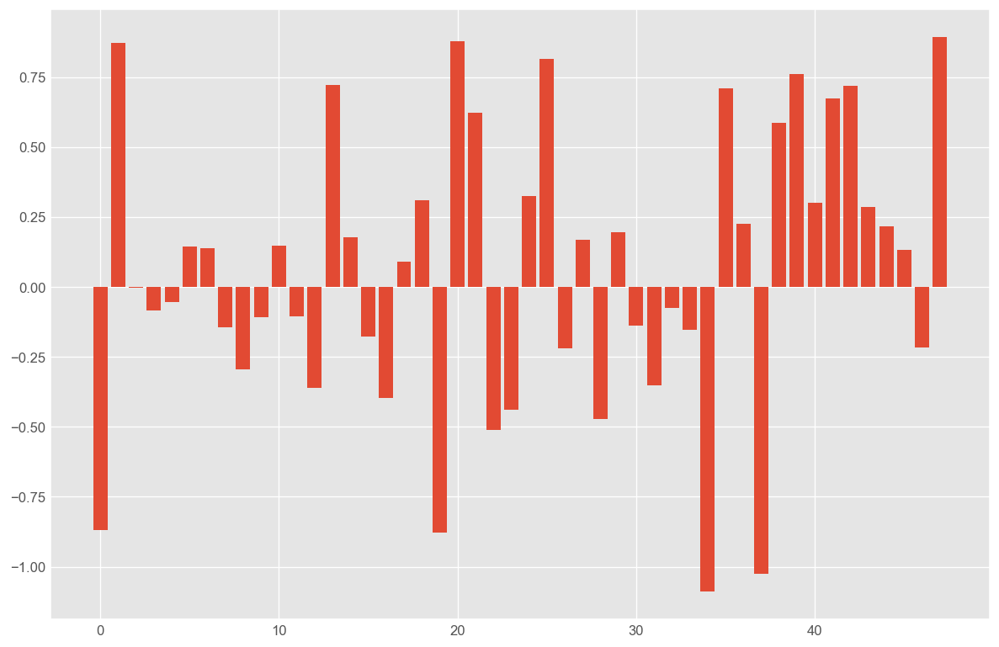

In [111]:
# get importance
importance = model.coef_[0]
# summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
plt.bar([x for x in range(len(importance))], importance)
plt.show()